<a href="https://colab.research.google.com/github/borrowedbirch05/Fast.AI/blob/main/Kaggle_Digit_Recognizer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from fastbook import *

In [ ]:
# train_path = Path('./digit-recognizer/train.csv')

In [ ]:
# train_df = pd.read_csv(train_path)

In [ ]:
# def get_items(df, is_train=True):
#     if is_train:
#         labels = df['label']
#     images = df.iloc[:,1:]
#     image_tensors = tensor(images).view(-1,1,28,28)
#     print(image_tensors.shape)
#     if is_train:
#         return image_tensors, labels
#     return image_tensors

In [ ]:
# from sklearn.model_selection import train_test_split

# train, test = train_test_split(train_df, test_size=0.2)

In [ ]:
# train_img, train_label = get_items(train)
# valid_img, valid_label = get_items(test)

torch.Size([33600, 1, 28, 28])
torch.Size([8400, 1, 28, 28])


In [ ]:
# train_dset = list(zip(train_img, train_label))
# valid_dset = list(zip(valid_img, valid_label))

In [ ]:
# train_dl = DataLoader(train_dset, batch_size=256)
# valid_dl = DataLoader(valid_dset, batch_size=256)

In [ ]:
# dls = DataLoaders(train_dl, valid_dl)

In [ ]:
# row = train_df.iloc[0][1:]

In [ ]:
# img = tensor(row).view(28,28).float()

In [ ]:
# from torchvision.utils import save_image
# save_image(img, 'img1.png')


In [ ]:
from torchvision.utils import save_image
def create_images(df, labels=True):
    for index, row in df.iterrows():
        if labels:
            image = row[1:]
            img = tensor(image).view(28,28).float()
            label = row[0]
            path = 'data/'+str(index)+'_'+str(label)+'.png'
            save_image(img, path)
        else:
            image = row
            img = tensor(image).view(28,28).float()
            path = 'test_data/'+str(index)+'.png'
            save_image(img, path)



In [ ]:
create_images(train_df)

NameError: name 'train_df' is not defined

In [ ]:
path = Path('.')

In [ ]:
Path.BASE_PATH = path

In [ ]:
path

Path('.')

In [ ]:
(path/'data').ls()[0]

Path('data/21578_9.png')

In [ ]:
import re
def extract_class_name(idx):
    try:
        found = re.findall('\d+', str(idx))
        return found[1]
    except:
        print("exception")

In [ ]:
extract_class_name((path/'data').ls()[0])

'9'

In [ ]:
path/'data'

Path('data')

In [ ]:
imgs = DataBlock(blocks = (ImageBlock, CategoryBlock),
                 get_items=get_image_files,
                 splitter=RandomSplitter(seed=42),
                 get_y=extract_class_name,
                 item_tfms=Resize(460),
                 batch_tfms=aug_transforms(size=300, min_scale=0.75, do_flip=False))
dls = imgs.dataloaders(path/'data')

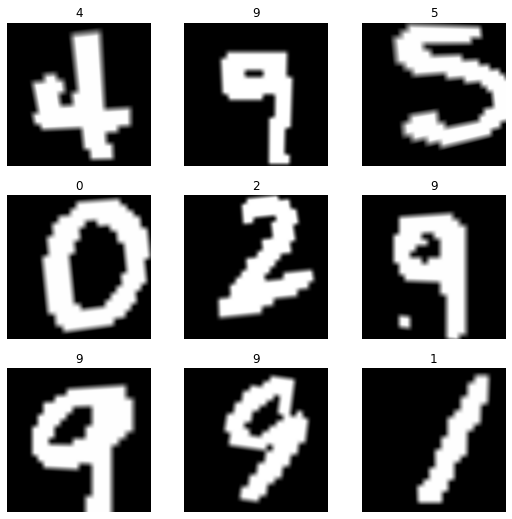

In [ ]:
dls.show_batch()

In [ ]:
learn = vision_learner(dls, resnet50, metrics=accuracy)

/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and will be removed in 0.15, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.9/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and will be removed in 0.15. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/resnet50-0676ba61.pth" to /root/.cache/torch/hub/checkpoints/resnet50-0676ba61.pth


  0%|          | 0.00/97.8M [00:00<?, ?B/s]

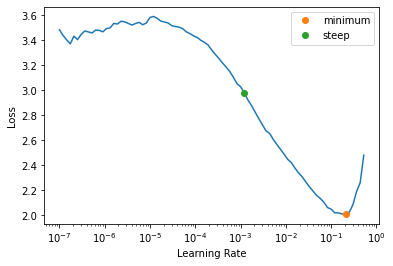

In [ ]:
lr_min,lr_steep = learn.lr_find(suggest_funcs=(minimum, steep))

In [ ]:
print(f"Minimum/10: {lr_min:.2e}, steepest point: {lr_steep:.2e}")

Minimum/10: 2.09e-02, steepest point: 1.20e-03


In [ ]:
learn.fit_one_cycle(3, 1.2e-3)

epoch,train_loss,valid_loss,accuracy,time
0,0.159142,0.076010,0.976548,11:05
1,0.080779,0.045246,0.985714,10:37
2,0.055823,0.038624,0.987381,10:29


In [ ]:
learn.unfreeze()

SuggestedLRs(valley=6.918309736647643e-06)

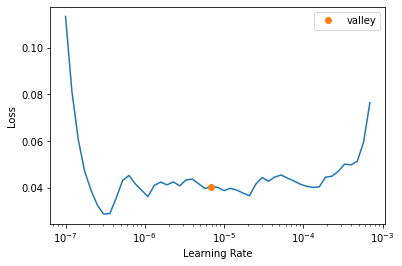

In [ ]:
learn.lr_find()

In [ ]:
learn.fit_one_cycle(10, lr_max=6e-6)

epoch,train_loss,valid_loss,accuracy,time


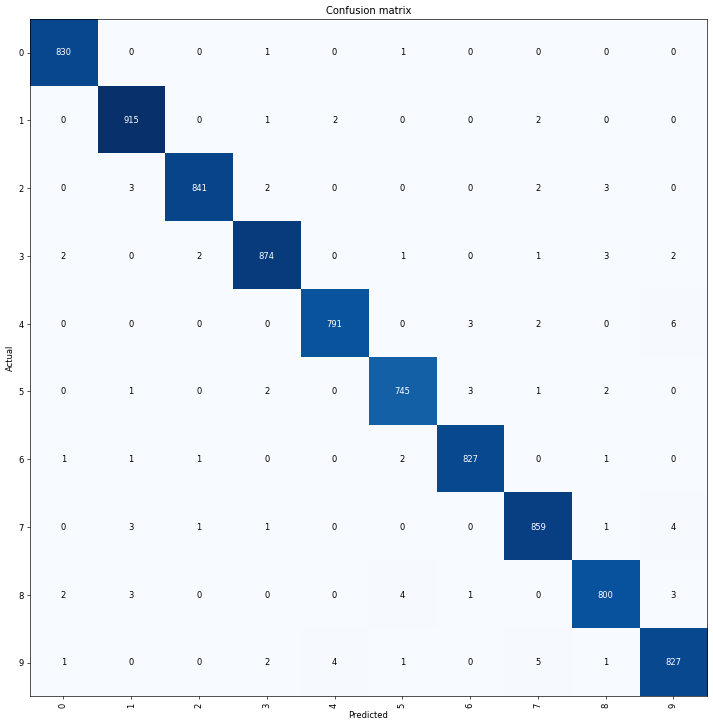

In [ ]:
interp = ClassificationInterpretation.from_learner(learn)
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)

In [ ]:
interp.most_confused(min_val=5)

[('4', '9', 6), ('9', '7', 5)]

In [ ]:
test_df = pd.read_csv('digit-recognizer/test.csv')

In [ ]:
create_images(test_df, False)

In [ ]:
(path/'test_data').ls()

(#28000) [Path('test_data/23645.png'),Path('test_data/13644.png'),Path('test_data/23232.png'),Path('test_data/22228.png'),Path('test_data/25826.png'),Path('test_data/3581.png'),Path('test_data/10127.png'),Path('test_data/2229.png'),Path('test_data/25006.png'),Path('test_data/6064.png')...]

In [ ]:
len((path/'test_data').ls())

28000

In [ ]:
from dill import dumps, loads
learn.export()
dumps(path/'export.pkl')

In [ ]:
learn_inf = load_learner(path/'export.pkl')

AttributeError: Custom classes or functions exported with your `Learner` not available in namespace.\Re-declare/import before loading:
	Can't get attribute 'extract_class_name' on <module '__main__'>

In [ ]:
learn_inf.predict('test_data/0.png')

('2',
 TensorBase(2),
 TensorBase([2.2491e-07, 1.1337e-07, 1.0000e+00, 3.8259e-08, 1.6821e-08, 3.0628e-08, 1.1531e-07, 1.6716e-07, 3.2877e-08, 2.3079e-08]))

In [ ]:
Image.open(path/'test_data/0.png')

In [ ]:
def create_submission(path):
    preds = []
    length = len(path.ls())
    for i in range(length):
        if i%1000 == 0:
            print('predicting: '+str(i))
        prediction = learn_inf.predict('test_data/'+str(i)+'.png')[0]
        preds.append([i, prediction])
    res = np.array(preds)
    dataset = pd.DataFrame({'ImageId': res[:, 0], 'Label': res[:, 1]})
    dataset.to_csv('submission.csv')


In [ ]:
create_submission(path/'test_data')

predicting: 0


predicting: 1


predicting: 2


predicting: 3


predicting: 4


predicting: 5


predicting: 6


predicting: 7


predicting: 8


predicting: 9


predicting: 10


predicting: 11


predicting: 12


predicting: 13


predicting: 14


predicting: 15


predicting: 16


predicting: 17


predicting: 18


predicting: 19


predicting: 20


predicting: 21


predicting: 22


predicting: 23


predicting: 24


predicting: 25


predicting: 26


predicting: 27


predicting: 28


predicting: 29


predicting: 30


predicting: 31


predicting: 32


predicting: 33


predicting: 34


predicting: 35


predicting: 36


predicting: 37


predicting: 38


predicting: 39


predicting: 40


predicting: 41


predicting: 42


predicting: 43


predicting: 44


predicting: 45


predicting: 46


predicting: 47


predicting: 48


predicting: 49


predicting: 50


predicting: 51


predicting: 52


predicting: 53


predicting: 54


predicting: 55


predicting: 56


predicting: 57


predicting: 58


predicting: 59


predicting: 60


predicting: 61


predicting: 62


predicting: 63


predicting: 64


predicting: 65


predicting: 66


predicting: 67


predicting: 68


predicting: 69


predicting: 70


predicting: 71


predicting: 72


predicting: 73


predicting: 74


predicting: 75


predicting: 76


predicting: 77


predicting: 78


predicting: 79


predicting: 80


predicting: 81


predicting: 82


predicting: 83


predicting: 84


predicting: 85


predicting: 86


predicting: 87


predicting: 88


predicting: 89


predicting: 90


predicting: 91


predicting: 92


predicting: 93


predicting: 94


predicting: 95


predicting: 96


predicting: 97


predicting: 98


predicting: 99


predicting: 100


predicting: 101


predicting: 102


predicting: 103


predicting: 104


predicting: 105


predicting: 106


predicting: 107


predicting: 108


predicting: 109


predicting: 110


predicting: 111


predicting: 112


predicting: 113


predicting: 114


predicting: 115


predicting: 116


predicting: 117


predicting: 118


predicting: 119


predicting: 120


predicting: 121


predicting: 122


predicting: 123


predicting: 124


predicting: 125


predicting: 126


predicting: 127


predicting: 128


predicting: 129


predicting: 130


predicting: 131


predicting: 132


predicting: 133


predicting: 134


predicting: 135


predicting: 136


predicting: 137


predicting: 138


predicting: 139


predicting: 140


predicting: 141


predicting: 142


predicting: 143


predicting: 144


predicting: 145


predicting: 146


predicting: 147


predicting: 148


predicting: 149


predicting: 150


predicting: 151


predicting: 152


predicting: 153


predicting: 154


predicting: 155


predicting: 156


predicting: 157


predicting: 158


predicting: 159


predicting: 160


predicting: 161


predicting: 162


predicting: 163


predicting: 164


predicting: 165


predicting: 166


predicting: 167


predicting: 168


predicting: 169


predicting: 170


predicting: 171


predicting: 172


predicting: 173


predicting: 174


predicting: 175


predicting: 176


predicting: 177


predicting: 178


predicting: 179


predicting: 180


predicting: 181


predicting: 182


predicting: 183


predicting: 184


predicting: 185


predicting: 186


predicting: 187


predicting: 188


predicting: 189


predicting: 190


predicting: 191


predicting: 192


predicting: 193


predicting: 194


predicting: 195


predicting: 196


predicting: 197


predicting: 198


predicting: 199


predicting: 200


predicting: 201


predicting: 202


predicting: 203


predicting: 204


predicting: 205


predicting: 206


predicting: 207


predicting: 208


predicting: 209


predicting: 210


predicting: 211


predicting: 212


predicting: 213


predicting: 214


predicting: 215


predicting: 216


predicting: 217


predicting: 218


predicting: 219


predicting: 220


predicting: 221


predicting: 222


predicting: 223


predicting: 224


predicting: 225


predicting: 226


predicting: 227


predicting: 228


predicting: 229


predicting: 230


predicting: 231


predicting: 232


predicting: 233


predicting: 234


predicting: 235


predicting: 236


predicting: 237


predicting: 238


predicting: 239


predicting: 240


predicting: 241


predicting: 242


predicting: 243


predicting: 244


predicting: 245


predicting: 246


predicting: 247


predicting: 248


predicting: 249


predicting: 250


predicting: 251


predicting: 252


predicting: 253


predicting: 254


predicting: 255


predicting: 256


predicting: 257


predicting: 258


predicting: 259


predicting: 260


predicting: 261


predicting: 262


predicting: 263


predicting: 264


predicting: 265


predicting: 266


predicting: 267


predicting: 268


predicting: 269


predicting: 270


predicting: 271


predicting: 272


predicting: 273


predicting: 274


predicting: 275


predicting: 276


predicting: 277


predicting: 278


predicting: 279


predicting: 280


predicting: 281


predicting: 282


predicting: 283


predicting: 284


predicting: 285


predicting: 286


predicting: 287


predicting: 288


predicting: 289


predicting: 290


predicting: 291


predicting: 292


predicting: 293


predicting: 294


predicting: 295


predicting: 296


predicting: 297


predicting: 298


predicting: 299


predicting: 300


predicting: 301


predicting: 302


predicting: 303


predicting: 304


predicting: 305


predicting: 306


predicting: 307


predicting: 308


predicting: 309


predicting: 310


predicting: 311


predicting: 312


predicting: 313


predicting: 314


predicting: 315


predicting: 316


predicting: 317


predicting: 318


predicting: 319


predicting: 320


predicting: 321


predicting: 322


predicting: 323


predicting: 324


predicting: 325


predicting: 326


predicting: 327


predicting: 328


predicting: 329


predicting: 330


predicting: 331


predicting: 332


predicting: 333


predicting: 334


predicting: 335


predicting: 336


predicting: 337


predicting: 338


predicting: 339


predicting: 340


predicting: 341


predicting: 342


predicting: 343


predicting: 344


predicting: 345


predicting: 346


predicting: 347


predicting: 348


predicting: 349


predicting: 350


predicting: 351


predicting: 352


predicting: 353


predicting: 354


predicting: 355


predicting: 356


predicting: 357


predicting: 358


predicting: 359


predicting: 360


predicting: 361


predicting: 362


predicting: 363


predicting: 364


predicting: 365


predicting: 366


predicting: 367


predicting: 368


predicting: 369


predicting: 370


predicting: 371


predicting: 372


predicting: 373


predicting: 374


predicting: 375


predicting: 376


predicting: 377


predicting: 378


predicting: 379


predicting: 380


predicting: 381


predicting: 382


predicting: 383


predicting: 384


predicting: 385


predicting: 386


predicting: 387


predicting: 388


predicting: 389


predicting: 390


predicting: 391


predicting: 392


predicting: 393


predicting: 394


predicting: 395


predicting: 396


predicting: 397


predicting: 398


predicting: 399


predicting: 400


predicting: 401


predicting: 402


predicting: 403


predicting: 404


predicting: 405


predicting: 406


predicting: 407


predicting: 408


predicting: 409


predicting: 410


predicting: 411


predicting: 412


predicting: 413


predicting: 414


predicting: 415


predicting: 416


predicting: 417


predicting: 418


predicting: 419


predicting: 420


predicting: 421


predicting: 422


predicting: 423


predicting: 424


predicting: 425


predicting: 426


predicting: 427


predicting: 428


predicting: 429


predicting: 430


predicting: 431


predicting: 432


predicting: 433


predicting: 434


predicting: 435


predicting: 436


predicting: 437


predicting: 438


predicting: 439


predicting: 440


predicting: 441


predicting: 442


predicting: 443


predicting: 444


predicting: 445


predicting: 446


predicting: 447


predicting: 448


predicting: 449


predicting: 450


predicting: 451


predicting: 452


predicting: 453


predicting: 454


predicting: 455


predicting: 456


predicting: 457


predicting: 458


predicting: 459


predicting: 460


predicting: 461


predicting: 462


predicting: 463


predicting: 464


predicting: 465


predicting: 466


predicting: 467


predicting: 468


predicting: 469


predicting: 470


predicting: 471


predicting: 472


predicting: 473


predicting: 474


predicting: 475


predicting: 476


predicting: 477


predicting: 478


predicting: 479


predicting: 480


predicting: 481


predicting: 482


predicting: 483


predicting: 484


predicting: 485


predicting: 486


predicting: 487


predicting: 488


predicting: 489


predicting: 490


predicting: 491


predicting: 492


predicting: 493


predicting: 494


predicting: 495


predicting: 496


predicting: 497


predicting: 498


predicting: 499


predicting: 500


predicting: 501


predicting: 502


predicting: 503


predicting: 504


predicting: 505


predicting: 506


predicting: 507


predicting: 508


predicting: 509


predicting: 510


predicting: 511


predicting: 512


predicting: 513


predicting: 514


predicting: 515


predicting: 516


predicting: 517


predicting: 518


predicting: 519


predicting: 520


predicting: 521


predicting: 522


predicting: 523


predicting: 524


predicting: 525


predicting: 526


predicting: 527


predicting: 528


predicting: 529


predicting: 530


predicting: 531


predicting: 532


predicting: 533


predicting: 534


predicting: 535


predicting: 536


predicting: 537


predicting: 538


predicting: 539


predicting: 540


predicting: 541


predicting: 542


predicting: 543


predicting: 544


predicting: 545


predicting: 546


predicting: 547


predicting: 548


predicting: 549


predicting: 550


predicting: 551


predicting: 552


predicting: 553


predicting: 554


predicting: 555


predicting: 556


predicting: 557


predicting: 558


predicting: 559


predicting: 560


predicting: 561


predicting: 562


predicting: 563


predicting: 564


predicting: 565


predicting: 566


predicting: 567


predicting: 568


predicting: 569


predicting: 570


predicting: 571


predicting: 572


predicting: 573


predicting: 574


predicting: 575


predicting: 576


predicting: 577


predicting: 578


predicting: 579


predicting: 580


predicting: 581


predicting: 582


predicting: 583


predicting: 584


predicting: 585


predicting: 586


predicting: 587


predicting: 588


predicting: 589


predicting: 590


predicting: 591


predicting: 592


predicting: 593


predicting: 594


predicting: 595


predicting: 596


predicting: 597


predicting: 598


predicting: 599


predicting: 600


predicting: 601


predicting: 602


predicting: 603


predicting: 604


predicting: 605


predicting: 606


predicting: 607


predicting: 608


predicting: 609


predicting: 610


predicting: 611


predicting: 612


predicting: 613


predicting: 614


predicting: 615


predicting: 616


predicting: 617


predicting: 618


predicting: 619


predicting: 620


predicting: 621


predicting: 622


predicting: 623


predicting: 624


predicting: 625


predicting: 626


predicting: 627


predicting: 628


predicting: 629


predicting: 630


predicting: 631


predicting: 632


predicting: 633


predicting: 634


predicting: 635


predicting: 636


predicting: 637


predicting: 638


predicting: 639


predicting: 640


predicting: 641


predicting: 642


predicting: 643


predicting: 644


predicting: 645


predicting: 646


predicting: 647


predicting: 648


predicting: 649


predicting: 650


predicting: 651


predicting: 652


predicting: 653


predicting: 654


predicting: 655


predicting: 656


predicting: 657


predicting: 658


predicting: 659


predicting: 660


predicting: 661


predicting: 662


predicting: 663


predicting: 664


predicting: 665


predicting: 666


predicting: 667


predicting: 668


predicting: 669


predicting: 670


predicting: 671


predicting: 672


predicting: 673


predicting: 674


predicting: 675


predicting: 676


predicting: 677


predicting: 678


predicting: 679


predicting: 680


predicting: 681


predicting: 682


predicting: 683


predicting: 684


predicting: 685


predicting: 686


predicting: 687


predicting: 688


predicting: 689


predicting: 690


predicting: 691


predicting: 692


predicting: 693


predicting: 694


predicting: 695


predicting: 696


predicting: 697


predicting: 698


predicting: 699


predicting: 700


predicting: 701


predicting: 702


predicting: 703


predicting: 704


predicting: 705


predicting: 706


predicting: 707


predicting: 708


predicting: 709


predicting: 710


predicting: 711


predicting: 712


predicting: 713


predicting: 714


predicting: 715


predicting: 716


predicting: 717


predicting: 718


predicting: 719


predicting: 720


predicting: 721


predicting: 722


predicting: 723


predicting: 724


predicting: 725


predicting: 726


predicting: 727


predicting: 728


predicting: 729


predicting: 730


predicting: 731


predicting: 732


predicting: 733


predicting: 734


predicting: 735


predicting: 736


predicting: 737


predicting: 738


predicting: 739


predicting: 740


predicting: 741


predicting: 742


predicting: 743


predicting: 744


predicting: 745


predicting: 746


predicting: 747


predicting: 748


predicting: 749


predicting: 750


predicting: 751


predicting: 752


predicting: 753


predicting: 754


predicting: 755


predicting: 756


predicting: 757


predicting: 758


predicting: 759


predicting: 760


predicting: 761


predicting: 762


predicting: 763


predicting: 764


predicting: 765


predicting: 766


predicting: 767


predicting: 768


predicting: 769


predicting: 770


predicting: 771


predicting: 772


predicting: 773


predicting: 774


predicting: 775


predicting: 776


predicting: 777


predicting: 778


predicting: 779


predicting: 780


predicting: 781


predicting: 782


predicting: 783


predicting: 784


predicting: 785


predicting: 786


predicting: 787


predicting: 788


predicting: 789


predicting: 790


predicting: 791


predicting: 792


predicting: 793


predicting: 794


predicting: 795


predicting: 796


predicting: 797


predicting: 798


predicting: 799


predicting: 800


predicting: 801


predicting: 802


predicting: 803


predicting: 804


predicting: 805


predicting: 806


predicting: 807


predicting: 808


predicting: 809


predicting: 810


predicting: 811


predicting: 812


predicting: 813


predicting: 814


predicting: 815


predicting: 816


predicting: 817


predicting: 818


predicting: 819


predicting: 820


predicting: 821


predicting: 822


predicting: 823


predicting: 824


predicting: 825


predicting: 826


predicting: 827


predicting: 828


predicting: 829


predicting: 830


predicting: 831


predicting: 832


predicting: 833


predicting: 834


predicting: 835


predicting: 836


predicting: 837


predicting: 838


predicting: 839


predicting: 840


predicting: 841


predicting: 842


predicting: 843


predicting: 844


predicting: 845


predicting: 846


predicting: 847


predicting: 848


predicting: 849


predicting: 850


predicting: 851


predicting: 852


predicting: 853


predicting: 854


predicting: 855


predicting: 856


predicting: 857


predicting: 858


predicting: 859


predicting: 860


predicting: 861


predicting: 862


predicting: 863


predicting: 864


predicting: 865


predicting: 866


predicting: 867


predicting: 868


predicting: 869


predicting: 870


predicting: 871


predicting: 872


predicting: 873


predicting: 874


predicting: 875


predicting: 876


predicting: 877


predicting: 878


predicting: 879


predicting: 880


predicting: 881


predicting: 882


predicting: 883


predicting: 884


predicting: 885


predicting: 886


predicting: 887


predicting: 888


predicting: 889


predicting: 890


predicting: 891


predicting: 892


predicting: 893


predicting: 894


predicting: 895


predicting: 896


predicting: 897


predicting: 898


predicting: 899


predicting: 900


predicting: 901


predicting: 902


predicting: 903


predicting: 904


predicting: 905


predicting: 906


predicting: 907


predicting: 908


predicting: 909


predicting: 910


predicting: 911


predicting: 912


predicting: 913


predicting: 914


predicting: 915


predicting: 916


predicting: 917


predicting: 918


predicting: 919


predicting: 920


predicting: 921


predicting: 922


predicting: 923


predicting: 924


predicting: 925


predicting: 926


predicting: 927


predicting: 928


predicting: 929


predicting: 930


predicting: 931


predicting: 932


predicting: 933


predicting: 934


predicting: 935


predicting: 936


predicting: 937


predicting: 938


predicting: 939


predicting: 940


predicting: 941


predicting: 942


predicting: 943


predicting: 944


predicting: 945


predicting: 946


predicting: 947


predicting: 948


predicting: 949


predicting: 950


predicting: 951


predicting: 952


predicting: 953


predicting: 954


predicting: 955


predicting: 956


predicting: 957


predicting: 958


predicting: 959


predicting: 960


predicting: 961


predicting: 962


predicting: 963


predicting: 964


predicting: 965


predicting: 966


predicting: 967


predicting: 968


predicting: 969


predicting: 970


predicting: 971


predicting: 972


predicting: 973


predicting: 974


predicting: 975


predicting: 976


predicting: 977


predicting: 978


predicting: 979


predicting: 980


predicting: 981


predicting: 982


predicting: 983


predicting: 984


predicting: 985


predicting: 986


predicting: 987


predicting: 988


predicting: 989


predicting: 990


predicting: 991


predicting: 992


predicting: 993


predicting: 994


predicting: 995


predicting: 996


predicting: 997


predicting: 998


predicting: 999


predicting: 1000


predicting: 1001


predicting: 1002


predicting: 1003


predicting: 1004


predicting: 1005


predicting: 1006


predicting: 1007


predicting: 1008


predicting: 1009


predicting: 1010


predicting: 1011


predicting: 1012


predicting: 1013


predicting: 1014


predicting: 1015


predicting: 1016


predicting: 1017


predicting: 1018


predicting: 1019


predicting: 1020


predicting: 1021


predicting: 1022


predicting: 1023


predicting: 1024


predicting: 1025


predicting: 1026


predicting: 1027


predicting: 1028


predicting: 1029


predicting: 1030


predicting: 1031


predicting: 1032


predicting: 1033


predicting: 1034


predicting: 1035


predicting: 1036


predicting: 1037


predicting: 1038


predicting: 1039


predicting: 1040


predicting: 1041


predicting: 1042


predicting: 1043


predicting: 1044


predicting: 1045


predicting: 1046


predicting: 1047


predicting: 1048


predicting: 1049


predicting: 1050


predicting: 1051


predicting: 1052


predicting: 1053


predicting: 1054


predicting: 1055


predicting: 1056


predicting: 1057


predicting: 1058


predicting: 1059


predicting: 1060


predicting: 1061


predicting: 1062


predicting: 1063


predicting: 1064


predicting: 1065


predicting: 1066


predicting: 1067


predicting: 1068


predicting: 1069


predicting: 1070


predicting: 1071


predicting: 1072


predicting: 1073


predicting: 1074


predicting: 1075


predicting: 1076


predicting: 1077


predicting: 1078


predicting: 1079


predicting: 1080


predicting: 1081


predicting: 1082


predicting: 1083


predicting: 1084


predicting: 1085


predicting: 1086


predicting: 1087


predicting: 1088


predicting: 1089


predicting: 1090


predicting: 1091


predicting: 1092


predicting: 1093


predicting: 1094


predicting: 1095


predicting: 1096


predicting: 1097


predicting: 1098


predicting: 1099


predicting: 1100


predicting: 1101


predicting: 1102


predicting: 1103


predicting: 1104


predicting: 1105


predicting: 1106


predicting: 1107


predicting: 1108


predicting: 1109


predicting: 1110


predicting: 1111


predicting: 1112


predicting: 1113


predicting: 1114


predicting: 1115


predicting: 1116


predicting: 1117


predicting: 1118


predicting: 1119


predicting: 1120


predicting: 1121


predicting: 1122


predicting: 1123


predicting: 1124


predicting: 1125


predicting: 1126


predicting: 1127


predicting: 1128


predicting: 1129


predicting: 1130


predicting: 1131


predicting: 1132


predicting: 1133


predicting: 1134


predicting: 1135


predicting: 1136


predicting: 1137


predicting: 1138


predicting: 1139


predicting: 1140


predicting: 1141


predicting: 1142


predicting: 1143


predicting: 1144


predicting: 1145


predicting: 1146


predicting: 1147


predicting: 1148


predicting: 1149


predicting: 1150


predicting: 1151


predicting: 1152


predicting: 1153


predicting: 1154


predicting: 1155


predicting: 1156


predicting: 1157


predicting: 1158


predicting: 1159


predicting: 1160


predicting: 1161


predicting: 1162


predicting: 1163


predicting: 1164


predicting: 1165


predicting: 1166


predicting: 1167


predicting: 1168


predicting: 1169


predicting: 1170


predicting: 1171


predicting: 1172


predicting: 1173


predicting: 1174


predicting: 1175


predicting: 1176


predicting: 1177


predicting: 1178


predicting: 1179


predicting: 1180


predicting: 1181


predicting: 1182


predicting: 1183


predicting: 1184


predicting: 1185


predicting: 1186


predicting: 1187


predicting: 1188


predicting: 1189


predicting: 1190


predicting: 1191


predicting: 1192


predicting: 1193


predicting: 1194


predicting: 1195


predicting: 1196


predicting: 1197


predicting: 1198


predicting: 1199


predicting: 1200


predicting: 1201


predicting: 1202


predicting: 1203


predicting: 1204


predicting: 1205


predicting: 1206


predicting: 1207


predicting: 1208


predicting: 1209


predicting: 1210


predicting: 1211


predicting: 1212


predicting: 1213


predicting: 1214


predicting: 1215


predicting: 1216


predicting: 1217


predicting: 1218


predicting: 1219


predicting: 1220


predicting: 1221


predicting: 1222


predicting: 1223


predicting: 1224


predicting: 1225


predicting: 1226


predicting: 1227


predicting: 1228


predicting: 1229


predicting: 1230


predicting: 1231


predicting: 1232


predicting: 1233


predicting: 1234


predicting: 1235


predicting: 1236


predicting: 1237


predicting: 1238


predicting: 1239


predicting: 1240


predicting: 1241


predicting: 1242


predicting: 1243


predicting: 1244


predicting: 1245


predicting: 1246


predicting: 1247


predicting: 1248


predicting: 1249


predicting: 1250


predicting: 1251


predicting: 1252


predicting: 1253


predicting: 1254


predicting: 1255


predicting: 1256


predicting: 1257


predicting: 1258


predicting: 1259


predicting: 1260


predicting: 1261


predicting: 1262


predicting: 1263


predicting: 1264


predicting: 1265


predicting: 1266


predicting: 1267


predicting: 1268


predicting: 1269


predicting: 1270


predicting: 1271


predicting: 1272


predicting: 1273


predicting: 1274


predicting: 1275


predicting: 1276


predicting: 1277


predicting: 1278


predicting: 1279


predicting: 1280


predicting: 1281


predicting: 1282


predicting: 1283


predicting: 1284


predicting: 1285


predicting: 1286


predicting: 1287


predicting: 1288


predicting: 1289


predicting: 1290


predicting: 1291


predicting: 1292


predicting: 1293


predicting: 1294


predicting: 1295


predicting: 1296


predicting: 1297


predicting: 1298


predicting: 1299


predicting: 1300


predicting: 1301


predicting: 1302


predicting: 1303


predicting: 1304


predicting: 1305


predicting: 1306


predicting: 1307


predicting: 1308


predicting: 1309


predicting: 1310


predicting: 1311


predicting: 1312


predicting: 1313


predicting: 1314


predicting: 1315


predicting: 1316


predicting: 1317


predicting: 1318


predicting: 1319


predicting: 1320


predicting: 1321


predicting: 1322


predicting: 1323


predicting: 1324


predicting: 1325


predicting: 1326


predicting: 1327


predicting: 1328


predicting: 1329


predicting: 1330


predicting: 1331


predicting: 1332


predicting: 1333


predicting: 1334


predicting: 1335


predicting: 1336


predicting: 1337


predicting: 1338


predicting: 1339


predicting: 1340


predicting: 1341


predicting: 1342


predicting: 1343


predicting: 1344


predicting: 1345


predicting: 1346


predicting: 1347


predicting: 1348


predicting: 1349


predicting: 1350


predicting: 1351


predicting: 1352


predicting: 1353


predicting: 1354


predicting: 1355


predicting: 1356


predicting: 1357


predicting: 1358


predicting: 1359


predicting: 1360


predicting: 1361


predicting: 1362


predicting: 1363


predicting: 1364


predicting: 1365


predicting: 1366


predicting: 1367


predicting: 1368


predicting: 1369


predicting: 1370


predicting: 1371


predicting: 1372


predicting: 1373


predicting: 1374


predicting: 1375


predicting: 1376


predicting: 1377


predicting: 1378


predicting: 1379


predicting: 1380


predicting: 1381


predicting: 1382


predicting: 1383


predicting: 1384


predicting: 1385


predicting: 1386


predicting: 1387


predicting: 1388


predicting: 1389


predicting: 1390


predicting: 1391


predicting: 1392


predicting: 1393


predicting: 1394


predicting: 1395


predicting: 1396


predicting: 1397


predicting: 1398


predicting: 1399


predicting: 1400


predicting: 1401


predicting: 1402


predicting: 1403


predicting: 1404


predicting: 1405


predicting: 1406


predicting: 1407


predicting: 1408


predicting: 1409


predicting: 1410


predicting: 1411


predicting: 1412


predicting: 1413


predicting: 1414


predicting: 1415


predicting: 1416


predicting: 1417


predicting: 1418


predicting: 1419


predicting: 1420


predicting: 1421


predicting: 1422


predicting: 1423


predicting: 1424


predicting: 1425


predicting: 1426


predicting: 1427


predicting: 1428


predicting: 1429


predicting: 1430


predicting: 1431


predicting: 1432


predicting: 1433


predicting: 1434


predicting: 1435


predicting: 1436


predicting: 1437


predicting: 1438


predicting: 1439


predicting: 1440


predicting: 1441


predicting: 1442


predicting: 1443


predicting: 1444


predicting: 1445


predicting: 1446


predicting: 1447


predicting: 1448


predicting: 1449


predicting: 1450


predicting: 1451


predicting: 1452


predicting: 1453


predicting: 1454


predicting: 1455


predicting: 1456


predicting: 1457


predicting: 1458


predicting: 1459


predicting: 1460


predicting: 1461


predicting: 1462


predicting: 1463


predicting: 1464


predicting: 1465


predicting: 1466


predicting: 1467


predicting: 1468


predicting: 1469


predicting: 1470


predicting: 1471


predicting: 1472


predicting: 1473


predicting: 1474


predicting: 1475


predicting: 1476


predicting: 1477


predicting: 1478


predicting: 1479


predicting: 1480


predicting: 1481


predicting: 1482


predicting: 1483


predicting: 1484


predicting: 1485


predicting: 1486


predicting: 1487


predicting: 1488


predicting: 1489


predicting: 1490


predicting: 1491


predicting: 1492


predicting: 1493


predicting: 1494


predicting: 1495


predicting: 1496


predicting: 1497


predicting: 1498


predicting: 1499


predicting: 1500


predicting: 1501


predicting: 1502


predicting: 1503


predicting: 1504


predicting: 1505


predicting: 1506


predicting: 1507


predicting: 1508


predicting: 1509


predicting: 1510


predicting: 1511


predicting: 1512


predicting: 1513


predicting: 1514


predicting: 1515


predicting: 1516


predicting: 1517


predicting: 1518


predicting: 1519


predicting: 1520


predicting: 1521


predicting: 1522


predicting: 1523


predicting: 1524


predicting: 1525


predicting: 1526


predicting: 1527


predicting: 1528


predicting: 1529


predicting: 1530


predicting: 1531


predicting: 1532


predicting: 1533


predicting: 1534


predicting: 1535


predicting: 1536


predicting: 1537


predicting: 1538


predicting: 1539


predicting: 1540


predicting: 1541


predicting: 1542


predicting: 1543


predicting: 1544


predicting: 1545


predicting: 1546


predicting: 1547


predicting: 1548


predicting: 1549


predicting: 1550


predicting: 1551


predicting: 1552


predicting: 1553


predicting: 1554


predicting: 1555


predicting: 1556


predicting: 1557


predicting: 1558


predicting: 1559


predicting: 1560


predicting: 1561


predicting: 1562


predicting: 1563


predicting: 1564


predicting: 1565


predicting: 1566


predicting: 1567


predicting: 1568


predicting: 1569


predicting: 1570


predicting: 1571


predicting: 1572


predicting: 1573


predicting: 1574


predicting: 1575


predicting: 1576


predicting: 1577


predicting: 1578


predicting: 1579


predicting: 1580


predicting: 1581


predicting: 1582


predicting: 1583


predicting: 1584


predicting: 1585


predicting: 1586


predicting: 1587


predicting: 1588


predicting: 1589


predicting: 1590


predicting: 1591


predicting: 1592


predicting: 1593


predicting: 1594


predicting: 1595


predicting: 1596


predicting: 1597


predicting: 1598


predicting: 1599


predicting: 1600


predicting: 1601


predicting: 1602


predicting: 1603


predicting: 1604


predicting: 1605


predicting: 1606


predicting: 1607


predicting: 1608


predicting: 1609


predicting: 1610


predicting: 1611


predicting: 1612


predicting: 1613


predicting: 1614


predicting: 1615


predicting: 1616


predicting: 1617


predicting: 1618


predicting: 1619


predicting: 1620


predicting: 1621


predicting: 1622


predicting: 1623


predicting: 1624


predicting: 1625


predicting: 1626


predicting: 1627


predicting: 1628


predicting: 1629


predicting: 1630


predicting: 1631


predicting: 1632


predicting: 1633


predicting: 1634


predicting: 1635


predicting: 1636


predicting: 1637


predicting: 1638


predicting: 1639


predicting: 1640


predicting: 1641


predicting: 1642


predicting: 1643


predicting: 1644


predicting: 1645


predicting: 1646


predicting: 1647


predicting: 1648


predicting: 1649


predicting: 1650


predicting: 1651


predicting: 1652


predicting: 1653


predicting: 1654


predicting: 1655


predicting: 1656


predicting: 1657


predicting: 1658


predicting: 1659


predicting: 1660


predicting: 1661


predicting: 1662


predicting: 1663


predicting: 1664


predicting: 1665


predicting: 1666


predicting: 1667


predicting: 1668


predicting: 1669


predicting: 1670


predicting: 1671


predicting: 1672


predicting: 1673


predicting: 1674


predicting: 1675


predicting: 1676


predicting: 1677


predicting: 1678


predicting: 1679


predicting: 1680


predicting: 1681


predicting: 1682


predicting: 1683


predicting: 1684


predicting: 1685


predicting: 1686


predicting: 1687


predicting: 1688


predicting: 1689


predicting: 1690


predicting: 1691


predicting: 1692


predicting: 1693


predicting: 1694


predicting: 1695


predicting: 1696


predicting: 1697


predicting: 1698


predicting: 1699


predicting: 1700


predicting: 1701


predicting: 1702


predicting: 1703


predicting: 1704


predicting: 1705


predicting: 1706


predicting: 1707


predicting: 1708


predicting: 1709


predicting: 1710


predicting: 1711


predicting: 1712


predicting: 1713


predicting: 1714


predicting: 1715


predicting: 1716


predicting: 1717


predicting: 1718


predicting: 1719


predicting: 1720


predicting: 1721


predicting: 1722


predicting: 1723


predicting: 1724


predicting: 1725


predicting: 1726


predicting: 1727


predicting: 1728


predicting: 1729


predicting: 1730


predicting: 1731


predicting: 1732


predicting: 1733


predicting: 1734


predicting: 1735


predicting: 1736


predicting: 1737


predicting: 1738


predicting: 1739


predicting: 1740


predicting: 1741


predicting: 1742


predicting: 1743


predicting: 1744


predicting: 1745


predicting: 1746


predicting: 1747


predicting: 1748


predicting: 1749


predicting: 1750


predicting: 1751


predicting: 1752


predicting: 1753


predicting: 1754


predicting: 1755


predicting: 1756


predicting: 1757


predicting: 1758


predicting: 1759


predicting: 1760


predicting: 1761


predicting: 1762


predicting: 1763


predicting: 1764


predicting: 1765


predicting: 1766


predicting: 1767


predicting: 1768


predicting: 1769


predicting: 1770


predicting: 1771


predicting: 1772


predicting: 1773


predicting: 1774


predicting: 1775


predicting: 1776


predicting: 1777


predicting: 1778


predicting: 1779


predicting: 1780


predicting: 1781


predicting: 1782


predicting: 1783


predicting: 1784


predicting: 1785


predicting: 1786


predicting: 1787


predicting: 1788


predicting: 1789


predicting: 1790


predicting: 1791


predicting: 1792


predicting: 1793


predicting: 1794


predicting: 1795


predicting: 1796


predicting: 1797


predicting: 1798


predicting: 1799


predicting: 1800


predicting: 1801


predicting: 1802


predicting: 1803


predicting: 1804


predicting: 1805


predicting: 1806


predicting: 1807


predicting: 1808


predicting: 1809


predicting: 1810


predicting: 1811


predicting: 1812


predicting: 1813


predicting: 1814


predicting: 1815


predicting: 1816


predicting: 1817


predicting: 1818


predicting: 1819


predicting: 1820


predicting: 1821


predicting: 1822


predicting: 1823


predicting: 1824


predicting: 1825


predicting: 1826


predicting: 1827


predicting: 1828


predicting: 1829


predicting: 1830


predicting: 1831


predicting: 1832


predicting: 1833


predicting: 1834


predicting: 1835


predicting: 1836


predicting: 1837


predicting: 1838


predicting: 1839


predicting: 1840


predicting: 1841


predicting: 1842


predicting: 1843


predicting: 1844


predicting: 1845


predicting: 1846


predicting: 1847


predicting: 1848


predicting: 1849


predicting: 1850


predicting: 1851


predicting: 1852


predicting: 1853


predicting: 1854


predicting: 1855


predicting: 1856


predicting: 1857


predicting: 1858


predicting: 1859


predicting: 1860


predicting: 1861


predicting: 1862


predicting: 1863


predicting: 1864


predicting: 1865


predicting: 1866


predicting: 1867


predicting: 1868


predicting: 1869


predicting: 1870


predicting: 1871


predicting: 1872


predicting: 1873


predicting: 1874


predicting: 1875


predicting: 1876


predicting: 1877


predicting: 1878


predicting: 1879


predicting: 1880


predicting: 1881


predicting: 1882


predicting: 1883


predicting: 1884


predicting: 1885


predicting: 1886


predicting: 1887


predicting: 1888


predicting: 1889


predicting: 1890


predicting: 1891


predicting: 1892


predicting: 1893


predicting: 1894


predicting: 1895


predicting: 1896


predicting: 1897


predicting: 1898


predicting: 1899


predicting: 1900


predicting: 1901


predicting: 1902


predicting: 1903


predicting: 1904


predicting: 1905


predicting: 1906


predicting: 1907


predicting: 1908


predicting: 1909


predicting: 1910


predicting: 1911


predicting: 1912


predicting: 1913


predicting: 1914


predicting: 1915


predicting: 1916


predicting: 1917


predicting: 1918


predicting: 1919


predicting: 1920


predicting: 1921


predicting: 1922


predicting: 1923


predicting: 1924


predicting: 1925


predicting: 1926


predicting: 1927


predicting: 1928


predicting: 1929


predicting: 1930


predicting: 1931


predicting: 1932


predicting: 1933


predicting: 1934


predicting: 1935


predicting: 1936


predicting: 1937


predicting: 1938


predicting: 1939


predicting: 1940


predicting: 1941


predicting: 1942


predicting: 1943


predicting: 1944


predicting: 1945


predicting: 1946


predicting: 1947


predicting: 1948


predicting: 1949


predicting: 1950


predicting: 1951


predicting: 1952


predicting: 1953


predicting: 1954


predicting: 1955


predicting: 1956


predicting: 1957


predicting: 1958


predicting: 1959


predicting: 1960


predicting: 1961


predicting: 1962


predicting: 1963


predicting: 1964


predicting: 1965


predicting: 1966


predicting: 1967


predicting: 1968


predicting: 1969


predicting: 1970


predicting: 1971


predicting: 1972


predicting: 1973


predicting: 1974


predicting: 1975


predicting: 1976


predicting: 1977


predicting: 1978


predicting: 1979


predicting: 1980


predicting: 1981


predicting: 1982


predicting: 1983


predicting: 1984


predicting: 1985


predicting: 1986


predicting: 1987


predicting: 1988


predicting: 1989


predicting: 1990


predicting: 1991


predicting: 1992


predicting: 1993


predicting: 1994


predicting: 1995


predicting: 1996


predicting: 1997


predicting: 1998


predicting: 1999


predicting: 2000


predicting: 2001


predicting: 2002


predicting: 2003


predicting: 2004


predicting: 2005


predicting: 2006


predicting: 2007


predicting: 2008


predicting: 2009


predicting: 2010


predicting: 2011


predicting: 2012


predicting: 2013


predicting: 2014


predicting: 2015


predicting: 2016


predicting: 2017


predicting: 2018


predicting: 2019


predicting: 2020


predicting: 2021


predicting: 2022


predicting: 2023


predicting: 2024


predicting: 2025


predicting: 2026


predicting: 2027


predicting: 2028


predicting: 2029


predicting: 2030


predicting: 2031


predicting: 2032


predicting: 2033


predicting: 2034


predicting: 2035


predicting: 2036


predicting: 2037


predicting: 2038


predicting: 2039


predicting: 2040


predicting: 2041


predicting: 2042


predicting: 2043


predicting: 2044


predicting: 2045


predicting: 2046


predicting: 2047


predicting: 2048


predicting: 2049


predicting: 2050


predicting: 2051


predicting: 2052


predicting: 2053


predicting: 2054


predicting: 2055


predicting: 2056


predicting: 2057


predicting: 2058


predicting: 2059


predicting: 2060


predicting: 2061


predicting: 2062


predicting: 2063


predicting: 2064


predicting: 2065


predicting: 2066


predicting: 2067


predicting: 2068


predicting: 2069


predicting: 2070


predicting: 2071


predicting: 2072


predicting: 2073


predicting: 2074


predicting: 2075


predicting: 2076


predicting: 2077


predicting: 2078


predicting: 2079


predicting: 2080


predicting: 2081


predicting: 2082


predicting: 2083


predicting: 2084


predicting: 2085


predicting: 2086


predicting: 2087


predicting: 2088


predicting: 2089


predicting: 2090


predicting: 2091


predicting: 2092


predicting: 2093


predicting: 2094


predicting: 2095


predicting: 2096


predicting: 2097


predicting: 2098


predicting: 2099


predicting: 2100


predicting: 2101


predicting: 2102


predicting: 2103


predicting: 2104


predicting: 2105


predicting: 2106


predicting: 2107


predicting: 2108


predicting: 2109


predicting: 2110


predicting: 2111


predicting: 2112


predicting: 2113


predicting: 2114


predicting: 2115


predicting: 2116


predicting: 2117


predicting: 2118


predicting: 2119


predicting: 2120


predicting: 2121


predicting: 2122


predicting: 2123


predicting: 2124


predicting: 2125


predicting: 2126


predicting: 2127


predicting: 2128


predicting: 2129


predicting: 2130


predicting: 2131


predicting: 2132


predicting: 2133


predicting: 2134


predicting: 2135


predicting: 2136


predicting: 2137


predicting: 2138


predicting: 2139


predicting: 2140


predicting: 2141


predicting: 2142


predicting: 2143


predicting: 2144


predicting: 2145


predicting: 2146


predicting: 2147


predicting: 2148


predicting: 2149


predicting: 2150


predicting: 2151


predicting: 2152


predicting: 2153


predicting: 2154


predicting: 2155


predicting: 2156


predicting: 2157


predicting: 2158


predicting: 2159


predicting: 2160


predicting: 2161


predicting: 2162


predicting: 2163


predicting: 2164


predicting: 2165


predicting: 2166


predicting: 2167


predicting: 2168


predicting: 2169


predicting: 2170


predicting: 2171


predicting: 2172


predicting: 2173


predicting: 2174


predicting: 2175


predicting: 2176


predicting: 2177


predicting: 2178


predicting: 2179


predicting: 2180


predicting: 2181


predicting: 2182


predicting: 2183


predicting: 2184


predicting: 2185


predicting: 2186


predicting: 2187


predicting: 2188


predicting: 2189


predicting: 2190


predicting: 2191


predicting: 2192


predicting: 2193


predicting: 2194


predicting: 2195


predicting: 2196


predicting: 2197


predicting: 2198


predicting: 2199


predicting: 2200


predicting: 2201


predicting: 2202


predicting: 2203


predicting: 2204


predicting: 2205


predicting: 2206


predicting: 2207


predicting: 2208


predicting: 2209


predicting: 2210


predicting: 2211


predicting: 2212


predicting: 2213


predicting: 2214


predicting: 2215


predicting: 2216


predicting: 2217


predicting: 2218


predicting: 2219


predicting: 2220


predicting: 2221


predicting: 2222


predicting: 2223


predicting: 2224


predicting: 2225


predicting: 2226


predicting: 2227


predicting: 2228


predicting: 2229


predicting: 2230


predicting: 2231


predicting: 2232


predicting: 2233


predicting: 2234


predicting: 2235


predicting: 2236


predicting: 2237


predicting: 2238


predicting: 2239


predicting: 2240


predicting: 2241


predicting: 2242


predicting: 2243


predicting: 2244


predicting: 2245


predicting: 2246


predicting: 2247


predicting: 2248


predicting: 2249


predicting: 2250


predicting: 2251


predicting: 2252


predicting: 2253


predicting: 2254


predicting: 2255


predicting: 2256


predicting: 2257


predicting: 2258


predicting: 2259


predicting: 2260


predicting: 2261


predicting: 2262


predicting: 2263


predicting: 2264


predicting: 2265


predicting: 2266


predicting: 2267


predicting: 2268


predicting: 2269


predicting: 2270


predicting: 2271


predicting: 2272


predicting: 2273


predicting: 2274


predicting: 2275


predicting: 2276


predicting: 2277


predicting: 2278


predicting: 2279


predicting: 2280


predicting: 2281


predicting: 2282


predicting: 2283


predicting: 2284


predicting: 2285


predicting: 2286


predicting: 2287


predicting: 2288


predicting: 2289


predicting: 2290


predicting: 2291


predicting: 2292


predicting: 2293


predicting: 2294


predicting: 2295


predicting: 2296


predicting: 2297


predicting: 2298


predicting: 2299


predicting: 2300


predicting: 2301


predicting: 2302


predicting: 2303


predicting: 2304


predicting: 2305


predicting: 2306


predicting: 2307


predicting: 2308


predicting: 2309


predicting: 2310


predicting: 2311


predicting: 2312


predicting: 2313


predicting: 2314


predicting: 2315


predicting: 2316


predicting: 2317


predicting: 2318


predicting: 2319


predicting: 2320


predicting: 2321


predicting: 2322


predicting: 2323


predicting: 2324


predicting: 2325


predicting: 2326


predicting: 2327


predicting: 2328


predicting: 2329


predicting: 2330


predicting: 2331


predicting: 2332


predicting: 2333


predicting: 2334


predicting: 2335


predicting: 2336


predicting: 2337


predicting: 2338


predicting: 2339


predicting: 2340


predicting: 2341


predicting: 2342


predicting: 2343


predicting: 2344


predicting: 2345


predicting: 2346


predicting: 2347


predicting: 2348


predicting: 2349


predicting: 2350


predicting: 2351


predicting: 2352


predicting: 2353


predicting: 2354


predicting: 2355


predicting: 2356


predicting: 2357


predicting: 2358


predicting: 2359


predicting: 2360


predicting: 2361


predicting: 2362


predicting: 2363


predicting: 2364


predicting: 2365


predicting: 2366


predicting: 2367


predicting: 2368


predicting: 2369


predicting: 2370


predicting: 2371


predicting: 2372


predicting: 2373


predicting: 2374


predicting: 2375


predicting: 2376


predicting: 2377


predicting: 2378


predicting: 2379


predicting: 2380


predicting: 2381


predicting: 2382


predicting: 2383


predicting: 2384


predicting: 2385


predicting: 2386


predicting: 2387


predicting: 2388


predicting: 2389


predicting: 2390


predicting: 2391


predicting: 2392


predicting: 2393


predicting: 2394


predicting: 2395


predicting: 2396


predicting: 2397


predicting: 2398


predicting: 2399


predicting: 2400


predicting: 2401


predicting: 2402


predicting: 2403


predicting: 2404


predicting: 2405


predicting: 2406


predicting: 2407


predicting: 2408


predicting: 2409


predicting: 2410


predicting: 2411


predicting: 2412


predicting: 2413


predicting: 2414


predicting: 2415


predicting: 2416


predicting: 2417


predicting: 2418


predicting: 2419


predicting: 2420


predicting: 2421


predicting: 2422


predicting: 2423


predicting: 2424


predicting: 2425


predicting: 2426


predicting: 2427


predicting: 2428


predicting: 2429


predicting: 2430


predicting: 2431


predicting: 2432


predicting: 2433


predicting: 2434


predicting: 2435


predicting: 2436


predicting: 2437


predicting: 2438


predicting: 2439


predicting: 2440


predicting: 2441


predicting: 2442


predicting: 2443


predicting: 2444


predicting: 2445


predicting: 2446


predicting: 2447


predicting: 2448


predicting: 2449


predicting: 2450


predicting: 2451


predicting: 2452


predicting: 2453


predicting: 2454


predicting: 2455


predicting: 2456


predicting: 2457


predicting: 2458


predicting: 2459


predicting: 2460


predicting: 2461


predicting: 2462


predicting: 2463


predicting: 2464


predicting: 2465


predicting: 2466


predicting: 2467


predicting: 2468


predicting: 2469


predicting: 2470


predicting: 2471


predicting: 2472


predicting: 2473


predicting: 2474


predicting: 2475


predicting: 2476


predicting: 2477


predicting: 2478


predicting: 2479


predicting: 2480


predicting: 2481


predicting: 2482


predicting: 2483


predicting: 2484


predicting: 2485


predicting: 2486


predicting: 2487


predicting: 2488


predicting: 2489


predicting: 2490


predicting: 2491


predicting: 2492


predicting: 2493


predicting: 2494


predicting: 2495


predicting: 2496


predicting: 2497


predicting: 2498


predicting: 2499


predicting: 2500


predicting: 2501


predicting: 2502


predicting: 2503


predicting: 2504


predicting: 2505


predicting: 2506


predicting: 2507


predicting: 2508


predicting: 2509


predicting: 2510


predicting: 2511


predicting: 2512


predicting: 2513


predicting: 2514


predicting: 2515


predicting: 2516


predicting: 2517


predicting: 2518


predicting: 2519


predicting: 2520


predicting: 2521


predicting: 2522


predicting: 2523


predicting: 2524


predicting: 2525


predicting: 2526


predicting: 2527


predicting: 2528


predicting: 2529


predicting: 2530


predicting: 2531


predicting: 2532


predicting: 2533


predicting: 2534


predicting: 2535


predicting: 2536


predicting: 2537


predicting: 2538


predicting: 2539


predicting: 2540


predicting: 2541


predicting: 2542


predicting: 2543


predicting: 2544


predicting: 2545


predicting: 2546


predicting: 2547


predicting: 2548


predicting: 2549


predicting: 2550


predicting: 2551


predicting: 2552


predicting: 2553


predicting: 2554


predicting: 2555


predicting: 2556


predicting: 2557


predicting: 2558


predicting: 2559


predicting: 2560


predicting: 2561


predicting: 2562


predicting: 2563


predicting: 2564


predicting: 2565


predicting: 2566


predicting: 2567


predicting: 2568


predicting: 2569


predicting: 2570


predicting: 2571


predicting: 2572


predicting: 2573


predicting: 2574


predicting: 2575


predicting: 2576


predicting: 2577


predicting: 2578


predicting: 2579


predicting: 2580


predicting: 2581


predicting: 2582


predicting: 2583


predicting: 2584


predicting: 2585


predicting: 2586


predicting: 2587


predicting: 2588


predicting: 2589


predicting: 2590


predicting: 2591


predicting: 2592


predicting: 2593


predicting: 2594


predicting: 2595


predicting: 2596


predicting: 2597


predicting: 2598


predicting: 2599


predicting: 2600


predicting: 2601


predicting: 2602


predicting: 2603


predicting: 2604


predicting: 2605


predicting: 2606


predicting: 2607


predicting: 2608


predicting: 2609


predicting: 2610


predicting: 2611


predicting: 2612


predicting: 2613


predicting: 2614


predicting: 2615


predicting: 2616


predicting: 2617


predicting: 2618


predicting: 2619


predicting: 2620


predicting: 2621


predicting: 2622


predicting: 2623


predicting: 2624


predicting: 2625


predicting: 2626


predicting: 2627


predicting: 2628


predicting: 2629


predicting: 2630


predicting: 2631


predicting: 2632


predicting: 2633


predicting: 2634


predicting: 2635


predicting: 2636


predicting: 2637


predicting: 2638


predicting: 2639


predicting: 2640


predicting: 2641


predicting: 2642


predicting: 2643


predicting: 2644


predicting: 2645


predicting: 2646


predicting: 2647


predicting: 2648


predicting: 2649


predicting: 2650


predicting: 2651


predicting: 2652


predicting: 2653


predicting: 2654


predicting: 2655


predicting: 2656


predicting: 2657


predicting: 2658


predicting: 2659


predicting: 2660


predicting: 2661


predicting: 2662


predicting: 2663


predicting: 2664


predicting: 2665


predicting: 2666


predicting: 2667


predicting: 2668


predicting: 2669


predicting: 2670


predicting: 2671


predicting: 2672


predicting: 2673


predicting: 2674


predicting: 2675


predicting: 2676


predicting: 2677


predicting: 2678


predicting: 2679


predicting: 2680


predicting: 2681


predicting: 2682


predicting: 2683


predicting: 2684


predicting: 2685


predicting: 2686


predicting: 2687


predicting: 2688


predicting: 2689


predicting: 2690


predicting: 2691


predicting: 2692


predicting: 2693


predicting: 2694


predicting: 2695


predicting: 2696


predicting: 2697


predicting: 2698


predicting: 2699


predicting: 2700


predicting: 2701


predicting: 2702


predicting: 2703


predicting: 2704


predicting: 2705


predicting: 2706


predicting: 2707


predicting: 2708


predicting: 2709


predicting: 2710


predicting: 2711


predicting: 2712


predicting: 2713


predicting: 2714


predicting: 2715


predicting: 2716


predicting: 2717


predicting: 2718


predicting: 2719


predicting: 2720


predicting: 2721


predicting: 2722


predicting: 2723


predicting: 2724


predicting: 2725


predicting: 2726


predicting: 2727


predicting: 2728


predicting: 2729


predicting: 2730


predicting: 2731


predicting: 2732


predicting: 2733


predicting: 2734


predicting: 2735


predicting: 2736


predicting: 2737


predicting: 2738


predicting: 2739


predicting: 2740


predicting: 2741


predicting: 2742


predicting: 2743


predicting: 2744


predicting: 2745


predicting: 2746


predicting: 2747


predicting: 2748


predicting: 2749


predicting: 2750


predicting: 2751


predicting: 2752


predicting: 2753


predicting: 2754


predicting: 2755


predicting: 2756


predicting: 2757


predicting: 2758


predicting: 2759


predicting: 2760


predicting: 2761


predicting: 2762


predicting: 2763


predicting: 2764


predicting: 2765


predicting: 2766


predicting: 2767


predicting: 2768


predicting: 2769


predicting: 2770


predicting: 2771


predicting: 2772


predicting: 2773


predicting: 2774


predicting: 2775


predicting: 2776


predicting: 2777


predicting: 2778


predicting: 2779


predicting: 2780


predicting: 2781


predicting: 2782


predicting: 2783


predicting: 2784


predicting: 2785


predicting: 2786


predicting: 2787


predicting: 2788


predicting: 2789


predicting: 2790


predicting: 2791


predicting: 2792


predicting: 2793


predicting: 2794


predicting: 2795


predicting: 2796


predicting: 2797


predicting: 2798


predicting: 2799


predicting: 2800


predicting: 2801


predicting: 2802


predicting: 2803


predicting: 2804


predicting: 2805


predicting: 2806


predicting: 2807


predicting: 2808


predicting: 2809


predicting: 2810


predicting: 2811


predicting: 2812


predicting: 2813


predicting: 2814


predicting: 2815


predicting: 2816


predicting: 2817


predicting: 2818


predicting: 2819


predicting: 2820


predicting: 2821


predicting: 2822


predicting: 2823


predicting: 2824


predicting: 2825


predicting: 2826


predicting: 2827


predicting: 2828


predicting: 2829


predicting: 2830


predicting: 2831


predicting: 2832


predicting: 2833


predicting: 2834


predicting: 2835


predicting: 2836


predicting: 2837


predicting: 2838


predicting: 2839


predicting: 2840


predicting: 2841


predicting: 2842


predicting: 2843


predicting: 2844


predicting: 2845


predicting: 2846


predicting: 2847


predicting: 2848


predicting: 2849


predicting: 2850


predicting: 2851


predicting: 2852


predicting: 2853


predicting: 2854


predicting: 2855


predicting: 2856


predicting: 2857


predicting: 2858


predicting: 2859


predicting: 2860


predicting: 2861


predicting: 2862


predicting: 2863


predicting: 2864


predicting: 2865


predicting: 2866


predicting: 2867


predicting: 2868


predicting: 2869


predicting: 2870


predicting: 2871


predicting: 2872


predicting: 2873


predicting: 2874


predicting: 2875


predicting: 2876


predicting: 2877


predicting: 2878


predicting: 2879


predicting: 2880


predicting: 2881


predicting: 2882


predicting: 2883


predicting: 2884


predicting: 2885


predicting: 2886


predicting: 2887


predicting: 2888


predicting: 2889


predicting: 2890


predicting: 2891


predicting: 2892


predicting: 2893


predicting: 2894


predicting: 2895


predicting: 2896


predicting: 2897


predicting: 2898


predicting: 2899


predicting: 2900


predicting: 2901


predicting: 2902


predicting: 2903


predicting: 2904


predicting: 2905


predicting: 2906


predicting: 2907


predicting: 2908


predicting: 2909


predicting: 2910


predicting: 2911


predicting: 2912


predicting: 2913


predicting: 2914


predicting: 2915


predicting: 2916


predicting: 2917


predicting: 2918


predicting: 2919


predicting: 2920


predicting: 2921


predicting: 2922


predicting: 2923


predicting: 2924


predicting: 2925


predicting: 2926


predicting: 2927


predicting: 2928


predicting: 2929


predicting: 2930


predicting: 2931


predicting: 2932


predicting: 2933


predicting: 2934


predicting: 2935


predicting: 2936


predicting: 2937


predicting: 2938


predicting: 2939


predicting: 2940


predicting: 2941


predicting: 2942


predicting: 2943


predicting: 2944


predicting: 2945


predicting: 2946


predicting: 2947


predicting: 2948


predicting: 2949


predicting: 2950


predicting: 2951


predicting: 2952


predicting: 2953


predicting: 2954


predicting: 2955


predicting: 2956


predicting: 2957


predicting: 2958


predicting: 2959


predicting: 2960


predicting: 2961


predicting: 2962


predicting: 2963


predicting: 2964


predicting: 2965


predicting: 2966


predicting: 2967


predicting: 2968


predicting: 2969


predicting: 2970


predicting: 2971


predicting: 2972


predicting: 2973


predicting: 2974


predicting: 2975


predicting: 2976


predicting: 2977


predicting: 2978


predicting: 2979


predicting: 2980


predicting: 2981


predicting: 2982


predicting: 2983


predicting: 2984


predicting: 2985


predicting: 2986


predicting: 2987


predicting: 2988


predicting: 2989


predicting: 2990


predicting: 2991


predicting: 2992


predicting: 2993


predicting: 2994


predicting: 2995


predicting: 2996


predicting: 2997


predicting: 2998


predicting: 2999


predicting: 3000


predicting: 3001


predicting: 3002


predicting: 3003


predicting: 3004


predicting: 3005


predicting: 3006


predicting: 3007


predicting: 3008


predicting: 3009


predicting: 3010


predicting: 3011


predicting: 3012


predicting: 3013


predicting: 3014


predicting: 3015


predicting: 3016


predicting: 3017


predicting: 3018


predicting: 3019


predicting: 3020


predicting: 3021


predicting: 3022


predicting: 3023


predicting: 3024


predicting: 3025


predicting: 3026


predicting: 3027


predicting: 3028


predicting: 3029


predicting: 3030


predicting: 3031


predicting: 3032


predicting: 3033


predicting: 3034


predicting: 3035


predicting: 3036


predicting: 3037


predicting: 3038


predicting: 3039


predicting: 3040


predicting: 3041


predicting: 3042


predicting: 3043


predicting: 3044


predicting: 3045


predicting: 3046


predicting: 3047


predicting: 3048


predicting: 3049


predicting: 3050


predicting: 3051


predicting: 3052


predicting: 3053


predicting: 3054


predicting: 3055


predicting: 3056


predicting: 3057


predicting: 3058


predicting: 3059


predicting: 3060


predicting: 3061


predicting: 3062


predicting: 3063


predicting: 3064


predicting: 3065


predicting: 3066


predicting: 3067


predicting: 3068


predicting: 3069


predicting: 3070


predicting: 3071


predicting: 3072


predicting: 3073


predicting: 3074


predicting: 3075


predicting: 3076


predicting: 3077


predicting: 3078


predicting: 3079


predicting: 3080


predicting: 3081


predicting: 3082


predicting: 3083


predicting: 3084


predicting: 3085


predicting: 3086


predicting: 3087


predicting: 3088


predicting: 3089


predicting: 3090


predicting: 3091


predicting: 3092


predicting: 3093


predicting: 3094


predicting: 3095


predicting: 3096


predicting: 3097


predicting: 3098


predicting: 3099


predicting: 3100


predicting: 3101


predicting: 3102


predicting: 3103


predicting: 3104


predicting: 3105


predicting: 3106


predicting: 3107


predicting: 3108


predicting: 3109


predicting: 3110


predicting: 3111


predicting: 3112


predicting: 3113


predicting: 3114


predicting: 3115


predicting: 3116


predicting: 3117


predicting: 3118


predicting: 3119


predicting: 3120


predicting: 3121


predicting: 3122


predicting: 3123


predicting: 3124


predicting: 3125


predicting: 3126


predicting: 3127


predicting: 3128


predicting: 3129


predicting: 3130


predicting: 3131


predicting: 3132


predicting: 3133


predicting: 3134


predicting: 3135


predicting: 3136


predicting: 3137


predicting: 3138


predicting: 3139


predicting: 3140


predicting: 3141


predicting: 3142


predicting: 3143


predicting: 3144


predicting: 3145


predicting: 3146


predicting: 3147


predicting: 3148


predicting: 3149


predicting: 3150


predicting: 3151


predicting: 3152


predicting: 3153


predicting: 3154


predicting: 3155


predicting: 3156


predicting: 3157


predicting: 3158


predicting: 3159


predicting: 3160


predicting: 3161


predicting: 3162


predicting: 3163


predicting: 3164


predicting: 3165


predicting: 3166


predicting: 3167


predicting: 3168


predicting: 3169


predicting: 3170


predicting: 3171


predicting: 3172


predicting: 3173


predicting: 3174


predicting: 3175


predicting: 3176


predicting: 3177


predicting: 3178


predicting: 3179


predicting: 3180


predicting: 3181


predicting: 3182


predicting: 3183


predicting: 3184


predicting: 3185


predicting: 3186


predicting: 3187


predicting: 3188


predicting: 3189


predicting: 3190


predicting: 3191


predicting: 3192


predicting: 3193


predicting: 3194


predicting: 3195


predicting: 3196


predicting: 3197


predicting: 3198


predicting: 3199


predicting: 3200


predicting: 3201


predicting: 3202


predicting: 3203


predicting: 3204


predicting: 3205


predicting: 3206


predicting: 3207


predicting: 3208


predicting: 3209


predicting: 3210


predicting: 3211


predicting: 3212


predicting: 3213


predicting: 3214


predicting: 3215


predicting: 3216


predicting: 3217


predicting: 3218


predicting: 3219


predicting: 3220


predicting: 3221


predicting: 3222


predicting: 3223


predicting: 3224


predicting: 3225


predicting: 3226


predicting: 3227


predicting: 3228


predicting: 3229


predicting: 3230


predicting: 3231


predicting: 3232


predicting: 3233


predicting: 3234


predicting: 3235


predicting: 3236


predicting: 3237


predicting: 3238


predicting: 3239


predicting: 3240


predicting: 3241


predicting: 3242


predicting: 3243


predicting: 3244


predicting: 3245


predicting: 3246


predicting: 3247


predicting: 3248


predicting: 3249


predicting: 3250


predicting: 3251


predicting: 3252


predicting: 3253


predicting: 3254


predicting: 3255


predicting: 3256


predicting: 3257


predicting: 3258


predicting: 3259


predicting: 3260


predicting: 3261


predicting: 3262


predicting: 3263


predicting: 3264


predicting: 3265


predicting: 3266


predicting: 3267


predicting: 3268


predicting: 3269


predicting: 3270


predicting: 3271


predicting: 3272


predicting: 3273


predicting: 3274


predicting: 3275


predicting: 3276


predicting: 3277


predicting: 3278


predicting: 3279


predicting: 3280


predicting: 3281


predicting: 3282


predicting: 3283


predicting: 3284


predicting: 3285


predicting: 3286


predicting: 3287


predicting: 3288


predicting: 3289


predicting: 3290


predicting: 3291


predicting: 3292


predicting: 3293


predicting: 3294


predicting: 3295


predicting: 3296


predicting: 3297


predicting: 3298


predicting: 3299


predicting: 3300


predicting: 3301


predicting: 3302


predicting: 3303


predicting: 3304


predicting: 3305


predicting: 3306


predicting: 3307


predicting: 3308


predicting: 3309


predicting: 3310


predicting: 3311


predicting: 3312


predicting: 3313


predicting: 3314


predicting: 3315


predicting: 3316


predicting: 3317


predicting: 3318


predicting: 3319


predicting: 3320


predicting: 3321


predicting: 3322


predicting: 3323


predicting: 3324


predicting: 3325


predicting: 3326


predicting: 3327


predicting: 3328


predicting: 3329


predicting: 3330


predicting: 3331


predicting: 3332


predicting: 3333


predicting: 3334


predicting: 3335


predicting: 3336


predicting: 3337


predicting: 3338


predicting: 3339


predicting: 3340


predicting: 3341


predicting: 3342


predicting: 3343


predicting: 3344


predicting: 3345


predicting: 3346


predicting: 3347


predicting: 3348


predicting: 3349


predicting: 3350


predicting: 3351


predicting: 3352


predicting: 3353


predicting: 3354


predicting: 3355


predicting: 3356


predicting: 3357


predicting: 3358


predicting: 3359


predicting: 3360


predicting: 3361


predicting: 3362


predicting: 3363


predicting: 3364


predicting: 3365


predicting: 3366


predicting: 3367


predicting: 3368


predicting: 3369


predicting: 3370


predicting: 3371


predicting: 3372


predicting: 3373


predicting: 3374


predicting: 3375


predicting: 3376


predicting: 3377


predicting: 3378


predicting: 3379


predicting: 3380


predicting: 3381


predicting: 3382


predicting: 3383


predicting: 3384


predicting: 3385


predicting: 3386


predicting: 3387


predicting: 3388


predicting: 3389


predicting: 3390


predicting: 3391


predicting: 3392


predicting: 3393


predicting: 3394


predicting: 3395


predicting: 3396


predicting: 3397


predicting: 3398


predicting: 3399


predicting: 3400


predicting: 3401


predicting: 3402


predicting: 3403


predicting: 3404


predicting: 3405


predicting: 3406


predicting: 3407


predicting: 3408


predicting: 3409


predicting: 3410


predicting: 3411


predicting: 3412


predicting: 3413


predicting: 3414


predicting: 3415


predicting: 3416


predicting: 3417


predicting: 3418


predicting: 3419


predicting: 3420


predicting: 3421


predicting: 3422


predicting: 3423


predicting: 3424


predicting: 3425


predicting: 3426


predicting: 3427


predicting: 3428


predicting: 3429


predicting: 3430


predicting: 3431


predicting: 3432


predicting: 3433


predicting: 3434


predicting: 3435


predicting: 3436


predicting: 3437


predicting: 3438


predicting: 3439


predicting: 3440


predicting: 3441


predicting: 3442


predicting: 3443


predicting: 3444


predicting: 3445


predicting: 3446


predicting: 3447


predicting: 3448


predicting: 3449


predicting: 3450


predicting: 3451


predicting: 3452


predicting: 3453


predicting: 3454


predicting: 3455


predicting: 3456


predicting: 3457


predicting: 3458


predicting: 3459


predicting: 3460


predicting: 3461


predicting: 3462


predicting: 3463


predicting: 3464


predicting: 3465


predicting: 3466


predicting: 3467


predicting: 3468


predicting: 3469


predicting: 3470


predicting: 3471


predicting: 3472


predicting: 3473


predicting: 3474


predicting: 3475


predicting: 3476


predicting: 3477


predicting: 3478


predicting: 3479


predicting: 3480


predicting: 3481


predicting: 3482


predicting: 3483


predicting: 3484


predicting: 3485


predicting: 3486


predicting: 3487


predicting: 3488


predicting: 3489


predicting: 3490


predicting: 3491


predicting: 3492


predicting: 3493


predicting: 3494


predicting: 3495


predicting: 3496


predicting: 3497


predicting: 3498


predicting: 3499


predicting: 3500


predicting: 3501


predicting: 3502


predicting: 3503


predicting: 3504


predicting: 3505


predicting: 3506


predicting: 3507


predicting: 3508


predicting: 3509


predicting: 3510


predicting: 3511


predicting: 3512


predicting: 3513


predicting: 3514


predicting: 3515


predicting: 3516


predicting: 3517


predicting: 3518


predicting: 3519


predicting: 3520


predicting: 3521


predicting: 3522


predicting: 3523


predicting: 3524


predicting: 3525


predicting: 3526


predicting: 3527


predicting: 3528


predicting: 3529


predicting: 3530


predicting: 3531


predicting: 3532


predicting: 3533


predicting: 3534


predicting: 3535


predicting: 3536


predicting: 3537


predicting: 3538


predicting: 3539


predicting: 3540


predicting: 3541


predicting: 3542


predicting: 3543


predicting: 3544


predicting: 3545


predicting: 3546


predicting: 3547


predicting: 3548


predicting: 3549


predicting: 3550


predicting: 3551


predicting: 3552


predicting: 3553


predicting: 3554


predicting: 3555


predicting: 3556


predicting: 3557


predicting: 3558


predicting: 3559


predicting: 3560


predicting: 3561


predicting: 3562


predicting: 3563


predicting: 3564


predicting: 3565


predicting: 3566


predicting: 3567


predicting: 3568


predicting: 3569


predicting: 3570


predicting: 3571


predicting: 3572


predicting: 3573


predicting: 3574


predicting: 3575


predicting: 3576


predicting: 3577


predicting: 3578


predicting: 3579


predicting: 3580


predicting: 3581


predicting: 3582


predicting: 3583


predicting: 3584


predicting: 3585


predicting: 3586


predicting: 3587


predicting: 3588


predicting: 3589


predicting: 3590


predicting: 3591


predicting: 3592


predicting: 3593


predicting: 3594


predicting: 3595


predicting: 3596


predicting: 3597


predicting: 3598


predicting: 3599


predicting: 3600


predicting: 3601


predicting: 3602


predicting: 3603


predicting: 3604


predicting: 3605


predicting: 3606


predicting: 3607


predicting: 3608


predicting: 3609


predicting: 3610


predicting: 3611


predicting: 3612


predicting: 3613


predicting: 3614


predicting: 3615


predicting: 3616


predicting: 3617


predicting: 3618


predicting: 3619


predicting: 3620


predicting: 3621


predicting: 3622


predicting: 3623


predicting: 3624


predicting: 3625


predicting: 3626


predicting: 3627


predicting: 3628


predicting: 3629


predicting: 3630


predicting: 3631


predicting: 3632


predicting: 3633


predicting: 3634


predicting: 3635


predicting: 3636


predicting: 3637


predicting: 3638


predicting: 3639


predicting: 3640


predicting: 3641


predicting: 3642


predicting: 3643


predicting: 3644


predicting: 3645


predicting: 3646


predicting: 3647


predicting: 3648


predicting: 3649


predicting: 3650


predicting: 3651


predicting: 3652


predicting: 3653


predicting: 3654


predicting: 3655


predicting: 3656


predicting: 3657


predicting: 3658


predicting: 3659


predicting: 3660


predicting: 3661


predicting: 3662


predicting: 3663


predicting: 3664


predicting: 3665


predicting: 3666


predicting: 3667


predicting: 3668


predicting: 3669


predicting: 3670


predicting: 3671


predicting: 3672


predicting: 3673


predicting: 3674


predicting: 3675


predicting: 3676


predicting: 3677


predicting: 3678


predicting: 3679


predicting: 3680


predicting: 3681


predicting: 3682


predicting: 3683


predicting: 3684


predicting: 3685


predicting: 3686


predicting: 3687


predicting: 3688


predicting: 3689


predicting: 3690


predicting: 3691


predicting: 3692


predicting: 3693


predicting: 3694


predicting: 3695


predicting: 3696


predicting: 3697


predicting: 3698


predicting: 3699


predicting: 3700


predicting: 3701


predicting: 3702


predicting: 3703


predicting: 3704


predicting: 3705


predicting: 3706


predicting: 3707


predicting: 3708


predicting: 3709


predicting: 3710


predicting: 3711


predicting: 3712


predicting: 3713


predicting: 3714


predicting: 3715


predicting: 3716


predicting: 3717


predicting: 3718


predicting: 3719


predicting: 3720


predicting: 3721


predicting: 3722


predicting: 3723


predicting: 3724


predicting: 3725


predicting: 3726


predicting: 3727


predicting: 3728


predicting: 3729


predicting: 3730


predicting: 3731


predicting: 3732


predicting: 3733


predicting: 3734


predicting: 3735


predicting: 3736


predicting: 3737


predicting: 3738


predicting: 3739


predicting: 3740


predicting: 3741


predicting: 3742


predicting: 3743


predicting: 3744


predicting: 3745


predicting: 3746


predicting: 3747


predicting: 3748


predicting: 3749


predicting: 3750


predicting: 3751


predicting: 3752


predicting: 3753


predicting: 3754


predicting: 3755


predicting: 3756


predicting: 3757


predicting: 3758


predicting: 3759


predicting: 3760


predicting: 3761


predicting: 3762


predicting: 3763


predicting: 3764


predicting: 3765


predicting: 3766


predicting: 3767


predicting: 3768


predicting: 3769


predicting: 3770


predicting: 3771


predicting: 3772


predicting: 3773


predicting: 3774


predicting: 3775


predicting: 3776


predicting: 3777


predicting: 3778


predicting: 3779


predicting: 3780


predicting: 3781


predicting: 3782


predicting: 3783


predicting: 3784


predicting: 3785


predicting: 3786


predicting: 3787


predicting: 3788


predicting: 3789


predicting: 3790


predicting: 3791


predicting: 3792


predicting: 3793


predicting: 3794


predicting: 3795


predicting: 3796


predicting: 3797


predicting: 3798


predicting: 3799


predicting: 3800


predicting: 3801


predicting: 3802


predicting: 3803


predicting: 3804


predicting: 3805


predicting: 3806


predicting: 3807


predicting: 3808


predicting: 3809


predicting: 3810


predicting: 3811


predicting: 3812


predicting: 3813


predicting: 3814


predicting: 3815


predicting: 3816


predicting: 3817


predicting: 3818


predicting: 3819


predicting: 3820


predicting: 3821


predicting: 3822


predicting: 3823


predicting: 3824


predicting: 3825


predicting: 3826


predicting: 3827


predicting: 3828


predicting: 3829


predicting: 3830


predicting: 3831


predicting: 3832


predicting: 3833


predicting: 3834


predicting: 3835


predicting: 3836


predicting: 3837


predicting: 3838


predicting: 3839


predicting: 3840


predicting: 3841


predicting: 3842


predicting: 3843


predicting: 3844


predicting: 3845


predicting: 3846


predicting: 3847


predicting: 3848


predicting: 3849


predicting: 3850


predicting: 3851


predicting: 3852


predicting: 3853


predicting: 3854


predicting: 3855


predicting: 3856


predicting: 3857


predicting: 3858


predicting: 3859


predicting: 3860


predicting: 3861


predicting: 3862


predicting: 3863


predicting: 3864


predicting: 3865


predicting: 3866


predicting: 3867


predicting: 3868


predicting: 3869


predicting: 3870


predicting: 3871


predicting: 3872


predicting: 3873


predicting: 3874


predicting: 3875


predicting: 3876


predicting: 3877


predicting: 3878


predicting: 3879


predicting: 3880


predicting: 3881


predicting: 3882


predicting: 3883


predicting: 3884


predicting: 3885


predicting: 3886


predicting: 3887


predicting: 3888


predicting: 3889


predicting: 3890


predicting: 3891


predicting: 3892


predicting: 3893


predicting: 3894


predicting: 3895


predicting: 3896


predicting: 3897


predicting: 3898


predicting: 3899


predicting: 3900


predicting: 3901


predicting: 3902


predicting: 3903


predicting: 3904


predicting: 3905


predicting: 3906


predicting: 3907


predicting: 3908


predicting: 3909


predicting: 3910


predicting: 3911


predicting: 3912


predicting: 3913


predicting: 3914


predicting: 3915


predicting: 3916


predicting: 3917


predicting: 3918


predicting: 3919


predicting: 3920


predicting: 3921


predicting: 3922


predicting: 3923


predicting: 3924


predicting: 3925


predicting: 3926


predicting: 3927


predicting: 3928


predicting: 3929


predicting: 3930


predicting: 3931


predicting: 3932


predicting: 3933


predicting: 3934


predicting: 3935


predicting: 3936


predicting: 3937


predicting: 3938


predicting: 3939


predicting: 3940


predicting: 3941


predicting: 3942


predicting: 3943


predicting: 3944


predicting: 3945


predicting: 3946


predicting: 3947


predicting: 3948


predicting: 3949


predicting: 3950


predicting: 3951


predicting: 3952


predicting: 3953


predicting: 3954


predicting: 3955


predicting: 3956


predicting: 3957


predicting: 3958


predicting: 3959


predicting: 3960


predicting: 3961


predicting: 3962


predicting: 3963


predicting: 3964


predicting: 3965


predicting: 3966


predicting: 3967


predicting: 3968


predicting: 3969


predicting: 3970


predicting: 3971


predicting: 3972


predicting: 3973


predicting: 3974


predicting: 3975


predicting: 3976


predicting: 3977


predicting: 3978


predicting: 3979


predicting: 3980


predicting: 3981


predicting: 3982


predicting: 3983


predicting: 3984


predicting: 3985


predicting: 3986


predicting: 3987


predicting: 3988


predicting: 3989


predicting: 3990


predicting: 3991


predicting: 3992


predicting: 3993


predicting: 3994


predicting: 3995


predicting: 3996


predicting: 3997


predicting: 3998


predicting: 3999


predicting: 4000


predicting: 4001


predicting: 4002


predicting: 4003


predicting: 4004


predicting: 4005


predicting: 4006


predicting: 4007


predicting: 4008


predicting: 4009


predicting: 4010


predicting: 4011


predicting: 4012


predicting: 4013


predicting: 4014


predicting: 4015


predicting: 4016


predicting: 4017


predicting: 4018


predicting: 4019


predicting: 4020


predicting: 4021


predicting: 4022


predicting: 4023


predicting: 4024


predicting: 4025


predicting: 4026


predicting: 4027


predicting: 4028


predicting: 4029


predicting: 4030


predicting: 4031


predicting: 4032


predicting: 4033


predicting: 4034


predicting: 4035


predicting: 4036


predicting: 4037


predicting: 4038


predicting: 4039


predicting: 4040


predicting: 4041


predicting: 4042


predicting: 4043


predicting: 4044


predicting: 4045


predicting: 4046


predicting: 4047


predicting: 4048


predicting: 4049


predicting: 4050


predicting: 4051


predicting: 4052


predicting: 4053


predicting: 4054


predicting: 4055


predicting: 4056


predicting: 4057


predicting: 4058


predicting: 4059


predicting: 4060


predicting: 4061


predicting: 4062


predicting: 4063


predicting: 4064


predicting: 4065


predicting: 4066


predicting: 4067


predicting: 4068


predicting: 4069


predicting: 4070


predicting: 4071


predicting: 4072


predicting: 4073


predicting: 4074


predicting: 4075


predicting: 4076


predicting: 4077


predicting: 4078


predicting: 4079


predicting: 4080


predicting: 4081


predicting: 4082


predicting: 4083


predicting: 4084


predicting: 4085


predicting: 4086


predicting: 4087


predicting: 4088


predicting: 4089


predicting: 4090


predicting: 4091


predicting: 4092


predicting: 4093


predicting: 4094


predicting: 4095


predicting: 4096


predicting: 4097


predicting: 4098


predicting: 4099


predicting: 4100


predicting: 4101


predicting: 4102


predicting: 4103


predicting: 4104


predicting: 4105


predicting: 4106


predicting: 4107


predicting: 4108


predicting: 4109


predicting: 4110


predicting: 4111


predicting: 4112


predicting: 4113


predicting: 4114


predicting: 4115


predicting: 4116


predicting: 4117


predicting: 4118


predicting: 4119


predicting: 4120


predicting: 4121


predicting: 4122


predicting: 4123


predicting: 4124


predicting: 4125


predicting: 4126


predicting: 4127


predicting: 4128


predicting: 4129


predicting: 4130


predicting: 4131


predicting: 4132


predicting: 4133


predicting: 4134


predicting: 4135


predicting: 4136


predicting: 4137


predicting: 4138


predicting: 4139


predicting: 4140


predicting: 4141


predicting: 4142


predicting: 4143


predicting: 4144


predicting: 4145


predicting: 4146


predicting: 4147


predicting: 4148


predicting: 4149


predicting: 4150


predicting: 4151


predicting: 4152


predicting: 4153


predicting: 4154


predicting: 4155


predicting: 4156


predicting: 4157


predicting: 4158


predicting: 4159


predicting: 4160


predicting: 4161


predicting: 4162


predicting: 4163


predicting: 4164


predicting: 4165


predicting: 4166


predicting: 4167


predicting: 4168


predicting: 4169


predicting: 4170


predicting: 4171


predicting: 4172


predicting: 4173


predicting: 4174


predicting: 4175


predicting: 4176


predicting: 4177


predicting: 4178


predicting: 4179


predicting: 4180


predicting: 4181


predicting: 4182


predicting: 4183


predicting: 4184


predicting: 4185


predicting: 4186


predicting: 4187


predicting: 4188


predicting: 4189


predicting: 4190


predicting: 4191


predicting: 4192


predicting: 4193


predicting: 4194


predicting: 4195


predicting: 4196


predicting: 4197


predicting: 4198


predicting: 4199


predicting: 4200


predicting: 4201


predicting: 4202


predicting: 4203


predicting: 4204


predicting: 4205


predicting: 4206


predicting: 4207


predicting: 4208


predicting: 4209


predicting: 4210


predicting: 4211


predicting: 4212


predicting: 4213


predicting: 4214


predicting: 4215


predicting: 4216


predicting: 4217


predicting: 4218


predicting: 4219


predicting: 4220


predicting: 4221


predicting: 4222


predicting: 4223


predicting: 4224


predicting: 4225


predicting: 4226


predicting: 4227


predicting: 4228


predicting: 4229


predicting: 4230


predicting: 4231


predicting: 4232


predicting: 4233


predicting: 4234


predicting: 4235


predicting: 4236


predicting: 4237


predicting: 4238


predicting: 4239


predicting: 4240


predicting: 4241


predicting: 4242


predicting: 4243


predicting: 4244


predicting: 4245


predicting: 4246


predicting: 4247


predicting: 4248


predicting: 4249


predicting: 4250


predicting: 4251


predicting: 4252


predicting: 4253


predicting: 4254


predicting: 4255


predicting: 4256


predicting: 4257


predicting: 4258


predicting: 4259


predicting: 4260


predicting: 4261


predicting: 4262


predicting: 4263


predicting: 4264


predicting: 4265


predicting: 4266


predicting: 4267


predicting: 4268


predicting: 4269


predicting: 4270


predicting: 4271


predicting: 4272


predicting: 4273


predicting: 4274


predicting: 4275


predicting: 4276


predicting: 4277


predicting: 4278


predicting: 4279


predicting: 4280


predicting: 4281


predicting: 4282


predicting: 4283


predicting: 4284


predicting: 4285


predicting: 4286


predicting: 4287


predicting: 4288


predicting: 4289


predicting: 4290


predicting: 4291


predicting: 4292


predicting: 4293


predicting: 4294


predicting: 4295


predicting: 4296


predicting: 4297


predicting: 4298


predicting: 4299


predicting: 4300


predicting: 4301


predicting: 4302


predicting: 4303


predicting: 4304


predicting: 4305


predicting: 4306


predicting: 4307


predicting: 4308


predicting: 4309


predicting: 4310


predicting: 4311


predicting: 4312


predicting: 4313


predicting: 4314


predicting: 4315


predicting: 4316


predicting: 4317


predicting: 4318


predicting: 4319


predicting: 4320


predicting: 4321


predicting: 4322


predicting: 4323


predicting: 4324


predicting: 4325


predicting: 4326


predicting: 4327


predicting: 4328


predicting: 4329


predicting: 4330


predicting: 4331


predicting: 4332


predicting: 4333


predicting: 4334


predicting: 4335


predicting: 4336


predicting: 4337


predicting: 4338


predicting: 4339


predicting: 4340


predicting: 4341


predicting: 4342


predicting: 4343


predicting: 4344


predicting: 4345


predicting: 4346


predicting: 4347


predicting: 4348


predicting: 4349


predicting: 4350


predicting: 4351


predicting: 4352


predicting: 4353


predicting: 4354


predicting: 4355


predicting: 4356


predicting: 4357


predicting: 4358


predicting: 4359


predicting: 4360


predicting: 4361


predicting: 4362


predicting: 4363


predicting: 4364


predicting: 4365


predicting: 4366


predicting: 4367


predicting: 4368


predicting: 4369


predicting: 4370


predicting: 4371


predicting: 4372


predicting: 4373


predicting: 4374


predicting: 4375


predicting: 4376


predicting: 4377


predicting: 4378


predicting: 4379


predicting: 4380


predicting: 4381


predicting: 4382


predicting: 4383


predicting: 4384


predicting: 4385


predicting: 4386


predicting: 4387


predicting: 4388


predicting: 4389


predicting: 4390


predicting: 4391


predicting: 4392


predicting: 4393


predicting: 4394


predicting: 4395


predicting: 4396


predicting: 4397


predicting: 4398


predicting: 4399


predicting: 4400


predicting: 4401


predicting: 4402


predicting: 4403


predicting: 4404


predicting: 4405


predicting: 4406


predicting: 4407


predicting: 4408


predicting: 4409


predicting: 4410


predicting: 4411


predicting: 4412


predicting: 4413


predicting: 4414


predicting: 4415


predicting: 4416


predicting: 4417


predicting: 4418


predicting: 4419


predicting: 4420


predicting: 4421


predicting: 4422


predicting: 4423


predicting: 4424


predicting: 4425


predicting: 4426


predicting: 4427


predicting: 4428


predicting: 4429


predicting: 4430


predicting: 4431


predicting: 4432


predicting: 4433


predicting: 4434


predicting: 4435


predicting: 4436


predicting: 4437


predicting: 4438


predicting: 4439


predicting: 4440


predicting: 4441


predicting: 4442


predicting: 4443


predicting: 4444


predicting: 4445


predicting: 4446


predicting: 4447


predicting: 4448


predicting: 4449


predicting: 4450


predicting: 4451


predicting: 4452


predicting: 4453


predicting: 4454


predicting: 4455


predicting: 4456


predicting: 4457


predicting: 4458


predicting: 4459


predicting: 4460


predicting: 4461


predicting: 4462


predicting: 4463


predicting: 4464


predicting: 4465


predicting: 4466


predicting: 4467


predicting: 4468


predicting: 4469


predicting: 4470


predicting: 4471


predicting: 4472


predicting: 4473


predicting: 4474


predicting: 4475


predicting: 4476


predicting: 4477


predicting: 4478


predicting: 4479


predicting: 4480


predicting: 4481


predicting: 4482


predicting: 4483


predicting: 4484


predicting: 4485


predicting: 4486


predicting: 4487


predicting: 4488


predicting: 4489


predicting: 4490


predicting: 4491


predicting: 4492


predicting: 4493


predicting: 4494


predicting: 4495


predicting: 4496


predicting: 4497


predicting: 4498


predicting: 4499


predicting: 4500


predicting: 4501


predicting: 4502


predicting: 4503


predicting: 4504


predicting: 4505


predicting: 4506


predicting: 4507


predicting: 4508


predicting: 4509


predicting: 4510


predicting: 4511


predicting: 4512


predicting: 4513


predicting: 4514


predicting: 4515


predicting: 4516


predicting: 4517


predicting: 4518


predicting: 4519


predicting: 4520


predicting: 4521


predicting: 4522


predicting: 4523


predicting: 4524


predicting: 4525


predicting: 4526


predicting: 4527


predicting: 4528


predicting: 4529


predicting: 4530


predicting: 4531


predicting: 4532


predicting: 4533


predicting: 4534


predicting: 4535


predicting: 4536


predicting: 4537


predicting: 4538


predicting: 4539


predicting: 4540


predicting: 4541


predicting: 4542


predicting: 4543


predicting: 4544


predicting: 4545


predicting: 4546


predicting: 4547


predicting: 4548


predicting: 4549


predicting: 4550


predicting: 4551


predicting: 4552


predicting: 4553


predicting: 4554


predicting: 4555


predicting: 4556


predicting: 4557


predicting: 4558


predicting: 4559


predicting: 4560


predicting: 4561


predicting: 4562


predicting: 4563


predicting: 4564


predicting: 4565


predicting: 4566


predicting: 4567


predicting: 4568


predicting: 4569


predicting: 4570


predicting: 4571


predicting: 4572


predicting: 4573


predicting: 4574


predicting: 4575


predicting: 4576


predicting: 4577


predicting: 4578


predicting: 4579


predicting: 4580


predicting: 4581


predicting: 4582


predicting: 4583


predicting: 4584


predicting: 4585


predicting: 4586


predicting: 4587


predicting: 4588


predicting: 4589


predicting: 4590


predicting: 4591


predicting: 4592


predicting: 4593


predicting: 4594


predicting: 4595


predicting: 4596


predicting: 4597


predicting: 4598


predicting: 4599


predicting: 4600


predicting: 4601


predicting: 4602


predicting: 4603


predicting: 4604


predicting: 4605


predicting: 4606


predicting: 4607


predicting: 4608


predicting: 4609


predicting: 4610


predicting: 4611


predicting: 4612


predicting: 4613


predicting: 4614


predicting: 4615


predicting: 4616


predicting: 4617


predicting: 4618


predicting: 4619


predicting: 4620


predicting: 4621


predicting: 4622


predicting: 4623


predicting: 4624


predicting: 4625


predicting: 4626


predicting: 4627


predicting: 4628


predicting: 4629


predicting: 4630


predicting: 4631


predicting: 4632


predicting: 4633


predicting: 4634


predicting: 4635


predicting: 4636


predicting: 4637


predicting: 4638


predicting: 4639


predicting: 4640


predicting: 4641


predicting: 4642


predicting: 4643


predicting: 4644


predicting: 4645


predicting: 4646


predicting: 4647


predicting: 4648


predicting: 4649


predicting: 4650


predicting: 4651


predicting: 4652


predicting: 4653


predicting: 4654


predicting: 4655


predicting: 4656


predicting: 4657


predicting: 4658


predicting: 4659


predicting: 4660


predicting: 4661


predicting: 4662


predicting: 4663


predicting: 4664


predicting: 4665


predicting: 4666


predicting: 4667


predicting: 4668


predicting: 4669


predicting: 4670


predicting: 4671


predicting: 4672


predicting: 4673


predicting: 4674


predicting: 4675


predicting: 4676


predicting: 4677


predicting: 4678


predicting: 4679


predicting: 4680


predicting: 4681


predicting: 4682


predicting: 4683


predicting: 4684


predicting: 4685


predicting: 4686


predicting: 4687


predicting: 4688


predicting: 4689


predicting: 4690


predicting: 4691


predicting: 4692


predicting: 4693


predicting: 4694


predicting: 4695


predicting: 4696


predicting: 4697


predicting: 4698


predicting: 4699


predicting: 4700


predicting: 4701


predicting: 4702


predicting: 4703


predicting: 4704


predicting: 4705


predicting: 4706


predicting: 4707


predicting: 4708


predicting: 4709


predicting: 4710


predicting: 4711


predicting: 4712


predicting: 4713


predicting: 4714


predicting: 4715


predicting: 4716


predicting: 4717


predicting: 4718


predicting: 4719


predicting: 4720


predicting: 4721


predicting: 4722


predicting: 4723


predicting: 4724


predicting: 4725


predicting: 4726


predicting: 4727


predicting: 4728


predicting: 4729


predicting: 4730


predicting: 4731


predicting: 4732


predicting: 4733


predicting: 4734


predicting: 4735


predicting: 4736


predicting: 4737


predicting: 4738


predicting: 4739


predicting: 4740


predicting: 4741


predicting: 4742


predicting: 4743


predicting: 4744


predicting: 4745


predicting: 4746


predicting: 4747


predicting: 4748


predicting: 4749


predicting: 4750


predicting: 4751


predicting: 4752


predicting: 4753


predicting: 4754


predicting: 4755


predicting: 4756


predicting: 4757


predicting: 4758


predicting: 4759


predicting: 4760


predicting: 4761


predicting: 4762


predicting: 4763


predicting: 4764


predicting: 4765


predicting: 4766


predicting: 4767


predicting: 4768


predicting: 4769


predicting: 4770


predicting: 4771


predicting: 4772


predicting: 4773


predicting: 4774


predicting: 4775


predicting: 4776


predicting: 4777


predicting: 4778


predicting: 4779


predicting: 4780


predicting: 4781


predicting: 4782


predicting: 4783


predicting: 4784


predicting: 4785


predicting: 4786


predicting: 4787


predicting: 4788


predicting: 4789


predicting: 4790


predicting: 4791


predicting: 4792


predicting: 4793


predicting: 4794


predicting: 4795


predicting: 4796


predicting: 4797


predicting: 4798


predicting: 4799


predicting: 4800


predicting: 4801


predicting: 4802


predicting: 4803


predicting: 4804


predicting: 4805


predicting: 4806


predicting: 4807


predicting: 4808


predicting: 4809


predicting: 4810


predicting: 4811


predicting: 4812


predicting: 4813


predicting: 4814


predicting: 4815


predicting: 4816


predicting: 4817


predicting: 4818


predicting: 4819


predicting: 4820


predicting: 4821


predicting: 4822


predicting: 4823


predicting: 4824


predicting: 4825


predicting: 4826


predicting: 4827


predicting: 4828


predicting: 4829


predicting: 4830


predicting: 4831


predicting: 4832


predicting: 4833


predicting: 4834


predicting: 4835


predicting: 4836


predicting: 4837


predicting: 4838


predicting: 4839


predicting: 4840


predicting: 4841


predicting: 4842


predicting: 4843


predicting: 4844


predicting: 4845


predicting: 4846


predicting: 4847


predicting: 4848


predicting: 4849


predicting: 4850


predicting: 4851


predicting: 4852


predicting: 4853


predicting: 4854


predicting: 4855


predicting: 4856


predicting: 4857


predicting: 4858


predicting: 4859


predicting: 4860


predicting: 4861


predicting: 4862


predicting: 4863


predicting: 4864


predicting: 4865


predicting: 4866


predicting: 4867


predicting: 4868


predicting: 4869


predicting: 4870


predicting: 4871


predicting: 4872


predicting: 4873


predicting: 4874


predicting: 4875


predicting: 4876


predicting: 4877


predicting: 4878


predicting: 4879


predicting: 4880


predicting: 4881


predicting: 4882


predicting: 4883


predicting: 4884


predicting: 4885


predicting: 4886


predicting: 4887


predicting: 4888


predicting: 4889


predicting: 4890


predicting: 4891


predicting: 4892


predicting: 4893


predicting: 4894


predicting: 4895


predicting: 4896


predicting: 4897


predicting: 4898


predicting: 4899


predicting: 4900


predicting: 4901


predicting: 4902


predicting: 4903


predicting: 4904


predicting: 4905


predicting: 4906


predicting: 4907


predicting: 4908


predicting: 4909


predicting: 4910


predicting: 4911


predicting: 4912


predicting: 4913


predicting: 4914


predicting: 4915


predicting: 4916


predicting: 4917


predicting: 4918


predicting: 4919


predicting: 4920


predicting: 4921


predicting: 4922


predicting: 4923


predicting: 4924


predicting: 4925


predicting: 4926


predicting: 4927


predicting: 4928


predicting: 4929


predicting: 4930


predicting: 4931


predicting: 4932


predicting: 4933


predicting: 4934


predicting: 4935


predicting: 4936


predicting: 4937


predicting: 4938


predicting: 4939


predicting: 4940


predicting: 4941


predicting: 4942


predicting: 4943


predicting: 4944


predicting: 4945


predicting: 4946


predicting: 4947


predicting: 4948


predicting: 4949


predicting: 4950


predicting: 4951


predicting: 4952


predicting: 4953


predicting: 4954


predicting: 4955


predicting: 4956


predicting: 4957


predicting: 4958


predicting: 4959


predicting: 4960


predicting: 4961


predicting: 4962


predicting: 4963


predicting: 4964


predicting: 4965


predicting: 4966


predicting: 4967


predicting: 4968


predicting: 4969


predicting: 4970


predicting: 4971


predicting: 4972


predicting: 4973


predicting: 4974


predicting: 4975


predicting: 4976


predicting: 4977


predicting: 4978


predicting: 4979


predicting: 4980


predicting: 4981


predicting: 4982


predicting: 4983


predicting: 4984


predicting: 4985


predicting: 4986


predicting: 4987


predicting: 4988


predicting: 4989


predicting: 4990


predicting: 4991


predicting: 4992


predicting: 4993


predicting: 4994


predicting: 4995


predicting: 4996


predicting: 4997


predicting: 4998


predicting: 4999


predicting: 5000


predicting: 5001


predicting: 5002


predicting: 5003


predicting: 5004


predicting: 5005


predicting: 5006


predicting: 5007


predicting: 5008


predicting: 5009


predicting: 5010


predicting: 5011


predicting: 5012


predicting: 5013


predicting: 5014


predicting: 5015


predicting: 5016


predicting: 5017


predicting: 5018


predicting: 5019


predicting: 5020


predicting: 5021


predicting: 5022


predicting: 5023


predicting: 5024


predicting: 5025


predicting: 5026


predicting: 5027


predicting: 5028


predicting: 5029


predicting: 5030


predicting: 5031


predicting: 5032


predicting: 5033


predicting: 5034


predicting: 5035


predicting: 5036


predicting: 5037


predicting: 5038


predicting: 5039


predicting: 5040


predicting: 5041


predicting: 5042


predicting: 5043


predicting: 5044


predicting: 5045


predicting: 5046


predicting: 5047


predicting: 5048


predicting: 5049


predicting: 5050


predicting: 5051


predicting: 5052


predicting: 5053


predicting: 5054


predicting: 5055


predicting: 5056


predicting: 5057


predicting: 5058


predicting: 5059


predicting: 5060


predicting: 5061


predicting: 5062


predicting: 5063


predicting: 5064


predicting: 5065


predicting: 5066


predicting: 5067


predicting: 5068


predicting: 5069


predicting: 5070


predicting: 5071


predicting: 5072


predicting: 5073


predicting: 5074


predicting: 5075


predicting: 5076


predicting: 5077


predicting: 5078


predicting: 5079


predicting: 5080


predicting: 5081


predicting: 5082


predicting: 5083


predicting: 5084


predicting: 5085


predicting: 5086


predicting: 5087


predicting: 5088


predicting: 5089


predicting: 5090


predicting: 5091


predicting: 5092


predicting: 5093


predicting: 5094


predicting: 5095


predicting: 5096


predicting: 5097


predicting: 5098


predicting: 5099


predicting: 5100


predicting: 5101


predicting: 5102


predicting: 5103


predicting: 5104


predicting: 5105


predicting: 5106


predicting: 5107


predicting: 5108


predicting: 5109


predicting: 5110


predicting: 5111


predicting: 5112


predicting: 5113


predicting: 5114


predicting: 5115


predicting: 5116


predicting: 5117


predicting: 5118


predicting: 5119


predicting: 5120


predicting: 5121


predicting: 5122


predicting: 5123


predicting: 5124


predicting: 5125


predicting: 5126


predicting: 5127


predicting: 5128


predicting: 5129


predicting: 5130


predicting: 5131


predicting: 5132


predicting: 5133


predicting: 5134


predicting: 5135


predicting: 5136


predicting: 5137


predicting: 5138


predicting: 5139


predicting: 5140


predicting: 5141


predicting: 5142


predicting: 5143


predicting: 5144


predicting: 5145


predicting: 5146


predicting: 5147


predicting: 5148


predicting: 5149


predicting: 5150


predicting: 5151


predicting: 5152


predicting: 5153


predicting: 5154


predicting: 5155


predicting: 5156


predicting: 5157


predicting: 5158


predicting: 5159


predicting: 5160


predicting: 5161


predicting: 5162


predicting: 5163


predicting: 5164


predicting: 5165


predicting: 5166


predicting: 5167


predicting: 5168


predicting: 5169


predicting: 5170


predicting: 5171


predicting: 5172


predicting: 5173


predicting: 5174


predicting: 5175


predicting: 5176


predicting: 5177


predicting: 5178


predicting: 5179


predicting: 5180


predicting: 5181


predicting: 5182


predicting: 5183


predicting: 5184


predicting: 5185


predicting: 5186


predicting: 5187


predicting: 5188


predicting: 5189


predicting: 5190


predicting: 5191


predicting: 5192


predicting: 5193


predicting: 5194


predicting: 5195


predicting: 5196


predicting: 5197


predicting: 5198


predicting: 5199


predicting: 5200


predicting: 5201


predicting: 5202


predicting: 5203


predicting: 5204


predicting: 5205


predicting: 5206


predicting: 5207


predicting: 5208


predicting: 5209


predicting: 5210


predicting: 5211


predicting: 5212


predicting: 5213


predicting: 5214


predicting: 5215


predicting: 5216


predicting: 5217


predicting: 5218


predicting: 5219


predicting: 5220


predicting: 5221


predicting: 5222


predicting: 5223


predicting: 5224


predicting: 5225


predicting: 5226


predicting: 5227


predicting: 5228


predicting: 5229


predicting: 5230


predicting: 5231


predicting: 5232


predicting: 5233


predicting: 5234


predicting: 5235


predicting: 5236


predicting: 5237


predicting: 5238


predicting: 5239


predicting: 5240


predicting: 5241


predicting: 5242


predicting: 5243


predicting: 5244


predicting: 5245


predicting: 5246


predicting: 5247


predicting: 5248


predicting: 5249


predicting: 5250


predicting: 5251


predicting: 5252


predicting: 5253


predicting: 5254


predicting: 5255


predicting: 5256


predicting: 5257


predicting: 5258


predicting: 5259


predicting: 5260


predicting: 5261


predicting: 5262


predicting: 5263


predicting: 5264


predicting: 5265


predicting: 5266


predicting: 5267


predicting: 5268


predicting: 5269


predicting: 5270


predicting: 5271


predicting: 5272


predicting: 5273


predicting: 5274


predicting: 5275


predicting: 5276


predicting: 5277


predicting: 5278


predicting: 5279


predicting: 5280


predicting: 5281


predicting: 5282


predicting: 5283


predicting: 5284


predicting: 5285


predicting: 5286


predicting: 5287


predicting: 5288


predicting: 5289


predicting: 5290


predicting: 5291


predicting: 5292


predicting: 5293


predicting: 5294


predicting: 5295


predicting: 5296


predicting: 5297


predicting: 5298


predicting: 5299


predicting: 5300


predicting: 5301


predicting: 5302


predicting: 5303


predicting: 5304


predicting: 5305


predicting: 5306


predicting: 5307


predicting: 5308


predicting: 5309


predicting: 5310


predicting: 5311


predicting: 5312


predicting: 5313


predicting: 5314


predicting: 5315


predicting: 5316


predicting: 5317


predicting: 5318


predicting: 5319


predicting: 5320


predicting: 5321


predicting: 5322


predicting: 5323


predicting: 5324


predicting: 5325


predicting: 5326


predicting: 5327


predicting: 5328


predicting: 5329


predicting: 5330


predicting: 5331


predicting: 5332


predicting: 5333


predicting: 5334


predicting: 5335


predicting: 5336


predicting: 5337


predicting: 5338


predicting: 5339


predicting: 5340


predicting: 5341


predicting: 5342


predicting: 5343


predicting: 5344


predicting: 5345


predicting: 5346


predicting: 5347


predicting: 5348


predicting: 5349


predicting: 5350


predicting: 5351


predicting: 5352


predicting: 5353


predicting: 5354


predicting: 5355


predicting: 5356


predicting: 5357


predicting: 5358


predicting: 5359


predicting: 5360


predicting: 5361


predicting: 5362


predicting: 5363


predicting: 5364


predicting: 5365


predicting: 5366


predicting: 5367


predicting: 5368


predicting: 5369


predicting: 5370


predicting: 5371


predicting: 5372


predicting: 5373


predicting: 5374


predicting: 5375


predicting: 5376


predicting: 5377


predicting: 5378


predicting: 5379


predicting: 5380


predicting: 5381


predicting: 5382


predicting: 5383


predicting: 5384


predicting: 5385


predicting: 5386


predicting: 5387


predicting: 5388


predicting: 5389


predicting: 5390


predicting: 5391


predicting: 5392


predicting: 5393


predicting: 5394


predicting: 5395


predicting: 5396


predicting: 5397


predicting: 5398


predicting: 5399


predicting: 5400


predicting: 5401


predicting: 5402


predicting: 5403


predicting: 5404


predicting: 5405


predicting: 5406


predicting: 5407


predicting: 5408


predicting: 5409


predicting: 5410


predicting: 5411


predicting: 5412


predicting: 5413


predicting: 5414


predicting: 5415


predicting: 5416


predicting: 5417


predicting: 5418


predicting: 5419


predicting: 5420


predicting: 5421


predicting: 5422


predicting: 5423


predicting: 5424


predicting: 5425


predicting: 5426


predicting: 5427


predicting: 5428


predicting: 5429


predicting: 5430


predicting: 5431


predicting: 5432


predicting: 5433


predicting: 5434


predicting: 5435


predicting: 5436


predicting: 5437


predicting: 5438


predicting: 5439


predicting: 5440


predicting: 5441


predicting: 5442


predicting: 5443


predicting: 5444


predicting: 5445


predicting: 5446


predicting: 5447


predicting: 5448


predicting: 5449


predicting: 5450


predicting: 5451


predicting: 5452


predicting: 5453


predicting: 5454


predicting: 5455


predicting: 5456


predicting: 5457


predicting: 5458


predicting: 5459


predicting: 5460


predicting: 5461


predicting: 5462


predicting: 5463


predicting: 5464


predicting: 5465


predicting: 5466


predicting: 5467


predicting: 5468


predicting: 5469


predicting: 5470


predicting: 5471


predicting: 5472


predicting: 5473


predicting: 5474


predicting: 5475


predicting: 5476


predicting: 5477


predicting: 5478


predicting: 5479


predicting: 5480


predicting: 5481


predicting: 5482


predicting: 5483


predicting: 5484


predicting: 5485


predicting: 5486


predicting: 5487


predicting: 5488


predicting: 5489


predicting: 5490


predicting: 5491


predicting: 5492


predicting: 5493


predicting: 5494


predicting: 5495


predicting: 5496


predicting: 5497


predicting: 5498


predicting: 5499


predicting: 5500


predicting: 5501


predicting: 5502


predicting: 5503


predicting: 5504


predicting: 5505


predicting: 5506


predicting: 5507


predicting: 5508


predicting: 5509


predicting: 5510


predicting: 5511


predicting: 5512


predicting: 5513


predicting: 5514


predicting: 5515


predicting: 5516


predicting: 5517


predicting: 5518


predicting: 5519


predicting: 5520


predicting: 5521


predicting: 5522


predicting: 5523


predicting: 5524


predicting: 5525


predicting: 5526


predicting: 5527


predicting: 5528


predicting: 5529


predicting: 5530


predicting: 5531


predicting: 5532


predicting: 5533


predicting: 5534


predicting: 5535


predicting: 5536


predicting: 5537


predicting: 5538


predicting: 5539


predicting: 5540


predicting: 5541


predicting: 5542


predicting: 5543


predicting: 5544


predicting: 5545


predicting: 5546


predicting: 5547


predicting: 5548


predicting: 5549


predicting: 5550


predicting: 5551


predicting: 5552


predicting: 5553


predicting: 5554


predicting: 5555


predicting: 5556


predicting: 5557


predicting: 5558


predicting: 5559


predicting: 5560


predicting: 5561


predicting: 5562


predicting: 5563


predicting: 5564


predicting: 5565


predicting: 5566


predicting: 5567


predicting: 5568


predicting: 5569


predicting: 5570


predicting: 5571


predicting: 5572


predicting: 5573


predicting: 5574


predicting: 5575


predicting: 5576


predicting: 5577


predicting: 5578


predicting: 5579


predicting: 5580


predicting: 5581


predicting: 5582


predicting: 5583


predicting: 5584


predicting: 5585


predicting: 5586


predicting: 5587


predicting: 5588


predicting: 5589


predicting: 5590


predicting: 5591


predicting: 5592


predicting: 5593


predicting: 5594


predicting: 5595


predicting: 5596


predicting: 5597


predicting: 5598


predicting: 5599


predicting: 5600


predicting: 5601


predicting: 5602


predicting: 5603


predicting: 5604


predicting: 5605


predicting: 5606


predicting: 5607


predicting: 5608


predicting: 5609


predicting: 5610


predicting: 5611


predicting: 5612


predicting: 5613


predicting: 5614


predicting: 5615


predicting: 5616


predicting: 5617


predicting: 5618


predicting: 5619


predicting: 5620


predicting: 5621


predicting: 5622


predicting: 5623


predicting: 5624


predicting: 5625


predicting: 5626


predicting: 5627


predicting: 5628


predicting: 5629


predicting: 5630


predicting: 5631


predicting: 5632


predicting: 5633


predicting: 5634


predicting: 5635


predicting: 5636


predicting: 5637


predicting: 5638


predicting: 5639


predicting: 5640


predicting: 5641


predicting: 5642


predicting: 5643


predicting: 5644


predicting: 5645


predicting: 5646


predicting: 5647


predicting: 5648


predicting: 5649


predicting: 5650


predicting: 5651


predicting: 5652


predicting: 5653


predicting: 5654


predicting: 5655


predicting: 5656


predicting: 5657


predicting: 5658


predicting: 5659


predicting: 5660


predicting: 5661


predicting: 5662


predicting: 5663


predicting: 5664


predicting: 5665


predicting: 5666


predicting: 5667


predicting: 5668


predicting: 5669


predicting: 5670


predicting: 5671


predicting: 5672


predicting: 5673


predicting: 5674


predicting: 5675


predicting: 5676


predicting: 5677


predicting: 5678


predicting: 5679


predicting: 5680


predicting: 5681


predicting: 5682


predicting: 5683


predicting: 5684


predicting: 5685


predicting: 5686


predicting: 5687


predicting: 5688


predicting: 5689


predicting: 5690


predicting: 5691


predicting: 5692


predicting: 5693


predicting: 5694


predicting: 5695


predicting: 5696


predicting: 5697


predicting: 5698


predicting: 5699


predicting: 5700


predicting: 5701


predicting: 5702


predicting: 5703


predicting: 5704


predicting: 5705


predicting: 5706


predicting: 5707


predicting: 5708


predicting: 5709


predicting: 5710


predicting: 5711


predicting: 5712


predicting: 5713


predicting: 5714


predicting: 5715


predicting: 5716


predicting: 5717


predicting: 5718


predicting: 5719


predicting: 5720


predicting: 5721


predicting: 5722


predicting: 5723


predicting: 5724


predicting: 5725


predicting: 5726


predicting: 5727


predicting: 5728


predicting: 5729


predicting: 5730


predicting: 5731


predicting: 5732


predicting: 5733


predicting: 5734


predicting: 5735


predicting: 5736


predicting: 5737


predicting: 5738


predicting: 5739


predicting: 5740


predicting: 5741


predicting: 5742


predicting: 5743


predicting: 5744


predicting: 5745


predicting: 5746


predicting: 5747


predicting: 5748


predicting: 5749


predicting: 5750


predicting: 5751


predicting: 5752


predicting: 5753


predicting: 5754


predicting: 5755


predicting: 5756


predicting: 5757


predicting: 5758


predicting: 5759


predicting: 5760


predicting: 5761


predicting: 5762


predicting: 5763


predicting: 5764


predicting: 5765


predicting: 5766


predicting: 5767


predicting: 5768


predicting: 5769


predicting: 5770


predicting: 5771


predicting: 5772


predicting: 5773


predicting: 5774


predicting: 5775


predicting: 5776


predicting: 5777


predicting: 5778


predicting: 5779


predicting: 5780


predicting: 5781


predicting: 5782


predicting: 5783


predicting: 5784


predicting: 5785


predicting: 5786


predicting: 5787


predicting: 5788


predicting: 5789


predicting: 5790


predicting: 5791


predicting: 5792


predicting: 5793


predicting: 5794


predicting: 5795


predicting: 5796


predicting: 5797


predicting: 5798


predicting: 5799


predicting: 5800


predicting: 5801


predicting: 5802


predicting: 5803


predicting: 5804


predicting: 5805


predicting: 5806


predicting: 5807


predicting: 5808


predicting: 5809


predicting: 5810


predicting: 5811


predicting: 5812


predicting: 5813


predicting: 5814


predicting: 5815


predicting: 5816


predicting: 5817


predicting: 5818


predicting: 5819


predicting: 5820


predicting: 5821


predicting: 5822


predicting: 5823


predicting: 5824


predicting: 5825


predicting: 5826


predicting: 5827


predicting: 5828


predicting: 5829


predicting: 5830


predicting: 5831


predicting: 5832


predicting: 5833


predicting: 5834


predicting: 5835


predicting: 5836


predicting: 5837


predicting: 5838


predicting: 5839


predicting: 5840


predicting: 5841


predicting: 5842


predicting: 5843


predicting: 5844


predicting: 5845


predicting: 5846


predicting: 5847


predicting: 5848


predicting: 5849


predicting: 5850


predicting: 5851


predicting: 5852


predicting: 5853


predicting: 5854


predicting: 5855


predicting: 5856


predicting: 5857


predicting: 5858


predicting: 5859


predicting: 5860


predicting: 5861


predicting: 5862


predicting: 5863


predicting: 5864


predicting: 5865


predicting: 5866


predicting: 5867


predicting: 5868


predicting: 5869


predicting: 5870


predicting: 5871


predicting: 5872


predicting: 5873


predicting: 5874


predicting: 5875


predicting: 5876


predicting: 5877


predicting: 5878


predicting: 5879


predicting: 5880


predicting: 5881


predicting: 5882


predicting: 5883


predicting: 5884


predicting: 5885


predicting: 5886


predicting: 5887


predicting: 5888


predicting: 5889


predicting: 5890


predicting: 5891


predicting: 5892


predicting: 5893


predicting: 5894


predicting: 5895


predicting: 5896


predicting: 5897


predicting: 5898


predicting: 5899


predicting: 5900


predicting: 5901


predicting: 5902


predicting: 5903


predicting: 5904


predicting: 5905


predicting: 5906


predicting: 5907


predicting: 5908


predicting: 5909


predicting: 5910


predicting: 5911


predicting: 5912


predicting: 5913


predicting: 5914


predicting: 5915


predicting: 5916


predicting: 5917


predicting: 5918


predicting: 5919


predicting: 5920


predicting: 5921


predicting: 5922


predicting: 5923


predicting: 5924


predicting: 5925


predicting: 5926


predicting: 5927


predicting: 5928


predicting: 5929


predicting: 5930


predicting: 5931


predicting: 5932


predicting: 5933


predicting: 5934


predicting: 5935


predicting: 5936


predicting: 5937


predicting: 5938


predicting: 5939


predicting: 5940


predicting: 5941


predicting: 5942


predicting: 5943


predicting: 5944


predicting: 5945


predicting: 5946


predicting: 5947


predicting: 5948


predicting: 5949


predicting: 5950


predicting: 5951


predicting: 5952


predicting: 5953


predicting: 5954


predicting: 5955


predicting: 5956


predicting: 5957


predicting: 5958


predicting: 5959


predicting: 5960


predicting: 5961


predicting: 5962


predicting: 5963


predicting: 5964


predicting: 5965


predicting: 5966


predicting: 5967


predicting: 5968


predicting: 5969


predicting: 5970


predicting: 5971


predicting: 5972


predicting: 5973


predicting: 5974


predicting: 5975


predicting: 5976


predicting: 5977


predicting: 5978


predicting: 5979


predicting: 5980


predicting: 5981


predicting: 5982


predicting: 5983


predicting: 5984


predicting: 5985


predicting: 5986


predicting: 5987


predicting: 5988


predicting: 5989


predicting: 5990


predicting: 5991


predicting: 5992


predicting: 5993


predicting: 5994


predicting: 5995


predicting: 5996


predicting: 5997


predicting: 5998


predicting: 5999


predicting: 6000


predicting: 6001


predicting: 6002


predicting: 6003


predicting: 6004


predicting: 6005


predicting: 6006


predicting: 6007


predicting: 6008


predicting: 6009


predicting: 6010


predicting: 6011


predicting: 6012


predicting: 6013


predicting: 6014


predicting: 6015


predicting: 6016


predicting: 6017


predicting: 6018


predicting: 6019


predicting: 6020


predicting: 6021


predicting: 6022


predicting: 6023


predicting: 6024


predicting: 6025


predicting: 6026


predicting: 6027


predicting: 6028


predicting: 6029


predicting: 6030


predicting: 6031


predicting: 6032


predicting: 6033


predicting: 6034


predicting: 6035


predicting: 6036


predicting: 6037


predicting: 6038


predicting: 6039


predicting: 6040


predicting: 6041


predicting: 6042


predicting: 6043


predicting: 6044


predicting: 6045


predicting: 6046


predicting: 6047


predicting: 6048


predicting: 6049


predicting: 6050


predicting: 6051


predicting: 6052


predicting: 6053


predicting: 6054


predicting: 6055


predicting: 6056


predicting: 6057


predicting: 6058


predicting: 6059


predicting: 6060


predicting: 6061


predicting: 6062


predicting: 6063


predicting: 6064


predicting: 6065


predicting: 6066


predicting: 6067


predicting: 6068


predicting: 6069


predicting: 6070


predicting: 6071


predicting: 6072


predicting: 6073


predicting: 6074


predicting: 6075


predicting: 6076


predicting: 6077


predicting: 6078


predicting: 6079


predicting: 6080


predicting: 6081


predicting: 6082


predicting: 6083


predicting: 6084


predicting: 6085


predicting: 6086


predicting: 6087


predicting: 6088


predicting: 6089


predicting: 6090


predicting: 6091


predicting: 6092


predicting: 6093


predicting: 6094


predicting: 6095


predicting: 6096


predicting: 6097


predicting: 6098


predicting: 6099


predicting: 6100


predicting: 6101


predicting: 6102


predicting: 6103


predicting: 6104


predicting: 6105


predicting: 6106


predicting: 6107


predicting: 6108


predicting: 6109


predicting: 6110


predicting: 6111


predicting: 6112


predicting: 6113


predicting: 6114


predicting: 6115


predicting: 6116


predicting: 6117


predicting: 6118


predicting: 6119


predicting: 6120


predicting: 6121


predicting: 6122


predicting: 6123


predicting: 6124


predicting: 6125


predicting: 6126


predicting: 6127


predicting: 6128


predicting: 6129


predicting: 6130


predicting: 6131


predicting: 6132


predicting: 6133


predicting: 6134


predicting: 6135


predicting: 6136


predicting: 6137


predicting: 6138


predicting: 6139


predicting: 6140


predicting: 6141


predicting: 6142


predicting: 6143


predicting: 6144


predicting: 6145


predicting: 6146


predicting: 6147


predicting: 6148


predicting: 6149


predicting: 6150


predicting: 6151


predicting: 6152


predicting: 6153


predicting: 6154


predicting: 6155


predicting: 6156


predicting: 6157


predicting: 6158


predicting: 6159


predicting: 6160


predicting: 6161


predicting: 6162


predicting: 6163


predicting: 6164


predicting: 6165


predicting: 6166


predicting: 6167


predicting: 6168


predicting: 6169


predicting: 6170


predicting: 6171


predicting: 6172


predicting: 6173


predicting: 6174


predicting: 6175


predicting: 6176


predicting: 6177


predicting: 6178


predicting: 6179


predicting: 6180


predicting: 6181


predicting: 6182


predicting: 6183


predicting: 6184


predicting: 6185


predicting: 6186


predicting: 6187


predicting: 6188


predicting: 6189


predicting: 6190


predicting: 6191


predicting: 6192


predicting: 6193


predicting: 6194


predicting: 6195


predicting: 6196


predicting: 6197


predicting: 6198


predicting: 6199


predicting: 6200


predicting: 6201


predicting: 6202


predicting: 6203


predicting: 6204


predicting: 6205


predicting: 6206


predicting: 6207


predicting: 6208


predicting: 6209


predicting: 6210


predicting: 6211


predicting: 6212


predicting: 6213


predicting: 6214


predicting: 6215


predicting: 6216


predicting: 6217


predicting: 6218


predicting: 6219


predicting: 6220


predicting: 6221


predicting: 6222


predicting: 6223


predicting: 6224


predicting: 6225


predicting: 6226


predicting: 6227


predicting: 6228


predicting: 6229


predicting: 6230


predicting: 6231


predicting: 6232


predicting: 6233


predicting: 6234


predicting: 6235


predicting: 6236


predicting: 6237


predicting: 6238


predicting: 6239


predicting: 6240


predicting: 6241


predicting: 6242


predicting: 6243


predicting: 6244


predicting: 6245


predicting: 6246


predicting: 6247


predicting: 6248


predicting: 6249


predicting: 6250


predicting: 6251


predicting: 6252


predicting: 6253


predicting: 6254


predicting: 6255


predicting: 6256


predicting: 6257


predicting: 6258


predicting: 6259


predicting: 6260


predicting: 6261


predicting: 6262


predicting: 6263


predicting: 6264


predicting: 6265


predicting: 6266


predicting: 6267


predicting: 6268


predicting: 6269


predicting: 6270


predicting: 6271


predicting: 6272


predicting: 6273


predicting: 6274


predicting: 6275


predicting: 6276


predicting: 6277


predicting: 6278


predicting: 6279


predicting: 6280


predicting: 6281


predicting: 6282


predicting: 6283


predicting: 6284


predicting: 6285


predicting: 6286


predicting: 6287


predicting: 6288


predicting: 6289


predicting: 6290


predicting: 6291


predicting: 6292


predicting: 6293


predicting: 6294


predicting: 6295


predicting: 6296


predicting: 6297


predicting: 6298


predicting: 6299


predicting: 6300


predicting: 6301


predicting: 6302


predicting: 6303


predicting: 6304


predicting: 6305


predicting: 6306


predicting: 6307


predicting: 6308


predicting: 6309


predicting: 6310


predicting: 6311


predicting: 6312


predicting: 6313


predicting: 6314


predicting: 6315


predicting: 6316


predicting: 6317


predicting: 6318


predicting: 6319


predicting: 6320


predicting: 6321


predicting: 6322


predicting: 6323


predicting: 6324


predicting: 6325


predicting: 6326


predicting: 6327


predicting: 6328


predicting: 6329


predicting: 6330


predicting: 6331


predicting: 6332


predicting: 6333


predicting: 6334


predicting: 6335


predicting: 6336


predicting: 6337


predicting: 6338


predicting: 6339


predicting: 6340


predicting: 6341


predicting: 6342


predicting: 6343


predicting: 6344


predicting: 6345


predicting: 6346


predicting: 6347


predicting: 6348


predicting: 6349


predicting: 6350


predicting: 6351


predicting: 6352


predicting: 6353


predicting: 6354


predicting: 6355


predicting: 6356


predicting: 6357


predicting: 6358


predicting: 6359


predicting: 6360


predicting: 6361


predicting: 6362


predicting: 6363


predicting: 6364


predicting: 6365


predicting: 6366


predicting: 6367


predicting: 6368


predicting: 6369


predicting: 6370


predicting: 6371


predicting: 6372


predicting: 6373


predicting: 6374


predicting: 6375


predicting: 6376


predicting: 6377


predicting: 6378


predicting: 6379


predicting: 6380


predicting: 6381


predicting: 6382


predicting: 6383


predicting: 6384


predicting: 6385


predicting: 6386


predicting: 6387


predicting: 6388


predicting: 6389


predicting: 6390


predicting: 6391


predicting: 6392


predicting: 6393


predicting: 6394


predicting: 6395


predicting: 6396


predicting: 6397


predicting: 6398


predicting: 6399


predicting: 6400


predicting: 6401


predicting: 6402


predicting: 6403


predicting: 6404


predicting: 6405


predicting: 6406


predicting: 6407


predicting: 6408


predicting: 6409


predicting: 6410


predicting: 6411


predicting: 6412


predicting: 6413


predicting: 6414


predicting: 6415


predicting: 6416


predicting: 6417


predicting: 6418


predicting: 6419


predicting: 6420


predicting: 6421


predicting: 6422


predicting: 6423


predicting: 6424


predicting: 6425


predicting: 6426


predicting: 6427


predicting: 6428


predicting: 6429


predicting: 6430


predicting: 6431


predicting: 6432


predicting: 6433


predicting: 6434


predicting: 6435


predicting: 6436


predicting: 6437


predicting: 6438


predicting: 6439


predicting: 6440


predicting: 6441


predicting: 6442


predicting: 6443


predicting: 6444


predicting: 6445


predicting: 6446


predicting: 6447


predicting: 6448


predicting: 6449


predicting: 6450


predicting: 6451


predicting: 6452


predicting: 6453


predicting: 6454


predicting: 6455


predicting: 6456


predicting: 6457


predicting: 6458


predicting: 6459


predicting: 6460


predicting: 6461


predicting: 6462


predicting: 6463


predicting: 6464


predicting: 6465


predicting: 6466


predicting: 6467


predicting: 6468


predicting: 6469


predicting: 6470


predicting: 6471


predicting: 6472


predicting: 6473


predicting: 6474


predicting: 6475


predicting: 6476


predicting: 6477


predicting: 6478


predicting: 6479


predicting: 6480


predicting: 6481


predicting: 6482


predicting: 6483


predicting: 6484


predicting: 6485


predicting: 6486


predicting: 6487


predicting: 6488


predicting: 6489


predicting: 6490


predicting: 6491


predicting: 6492


predicting: 6493


predicting: 6494


predicting: 6495


predicting: 6496


predicting: 6497


predicting: 6498


predicting: 6499


predicting: 6500


predicting: 6501


predicting: 6502


predicting: 6503


predicting: 6504


predicting: 6505


predicting: 6506


predicting: 6507


predicting: 6508


predicting: 6509


predicting: 6510


predicting: 6511


predicting: 6512


predicting: 6513


predicting: 6514


predicting: 6515


predicting: 6516


predicting: 6517


predicting: 6518


predicting: 6519


predicting: 6520


predicting: 6521


predicting: 6522


predicting: 6523


predicting: 6524


predicting: 6525


predicting: 6526


predicting: 6527


predicting: 6528


predicting: 6529


predicting: 6530


predicting: 6531


predicting: 6532


predicting: 6533


predicting: 6534


predicting: 6535


predicting: 6536


predicting: 6537


predicting: 6538


predicting: 6539


predicting: 6540


predicting: 6541


predicting: 6542


predicting: 6543


predicting: 6544


predicting: 6545


predicting: 6546


predicting: 6547


predicting: 6548


predicting: 6549


predicting: 6550


predicting: 6551


predicting: 6552


predicting: 6553


predicting: 6554


predicting: 6555


predicting: 6556


predicting: 6557


predicting: 6558


predicting: 6559


predicting: 6560


predicting: 6561


predicting: 6562


predicting: 6563


predicting: 6564


predicting: 6565


predicting: 6566


predicting: 6567


predicting: 6568


predicting: 6569


predicting: 6570


predicting: 6571


predicting: 6572


predicting: 6573


predicting: 6574


predicting: 6575


predicting: 6576


predicting: 6577


predicting: 6578


predicting: 6579


predicting: 6580


predicting: 6581


predicting: 6582


predicting: 6583


predicting: 6584


predicting: 6585


predicting: 6586


predicting: 6587


predicting: 6588


predicting: 6589


predicting: 6590


predicting: 6591


predicting: 6592


predicting: 6593


predicting: 6594


predicting: 6595


predicting: 6596


predicting: 6597


predicting: 6598


predicting: 6599


predicting: 6600


predicting: 6601


predicting: 6602


predicting: 6603


predicting: 6604


predicting: 6605


predicting: 6606


predicting: 6607


predicting: 6608


predicting: 6609


predicting: 6610


predicting: 6611


predicting: 6612


predicting: 6613


predicting: 6614


predicting: 6615


predicting: 6616


predicting: 6617


predicting: 6618


predicting: 6619


predicting: 6620


predicting: 6621


predicting: 6622


predicting: 6623


predicting: 6624


predicting: 6625


predicting: 6626


predicting: 6627


predicting: 6628


predicting: 6629


predicting: 6630


predicting: 6631


predicting: 6632


predicting: 6633


predicting: 6634


predicting: 6635


predicting: 6636


predicting: 6637


predicting: 6638


predicting: 6639


predicting: 6640


predicting: 6641


predicting: 6642


predicting: 6643


predicting: 6644


predicting: 6645


predicting: 6646


predicting: 6647


predicting: 6648


predicting: 6649


predicting: 6650


predicting: 6651


predicting: 6652


predicting: 6653


predicting: 6654


predicting: 6655


predicting: 6656


predicting: 6657


predicting: 6658


predicting: 6659


predicting: 6660


predicting: 6661


predicting: 6662


predicting: 6663


predicting: 6664


predicting: 6665


predicting: 6666


predicting: 6667


predicting: 6668


predicting: 6669


predicting: 6670


predicting: 6671


predicting: 6672


predicting: 6673


predicting: 6674


predicting: 6675


predicting: 6676


predicting: 6677


predicting: 6678


predicting: 6679


predicting: 6680


predicting: 6681


predicting: 6682


predicting: 6683


predicting: 6684


predicting: 6685


predicting: 6686


predicting: 6687


predicting: 6688


predicting: 6689


predicting: 6690


predicting: 6691


predicting: 6692


predicting: 6693


predicting: 6694


predicting: 6695


predicting: 6696


predicting: 6697


predicting: 6698


predicting: 6699


predicting: 6700


predicting: 6701


predicting: 6702


predicting: 6703


predicting: 6704


predicting: 6705


predicting: 6706


predicting: 6707


predicting: 6708


predicting: 6709


predicting: 6710


predicting: 6711


predicting: 6712


predicting: 6713


predicting: 6714


predicting: 6715


predicting: 6716


predicting: 6717


predicting: 6718


predicting: 6719


predicting: 6720


predicting: 6721


predicting: 6722


predicting: 6723


predicting: 6724


predicting: 6725


predicting: 6726


predicting: 6727


predicting: 6728


predicting: 6729


predicting: 6730


predicting: 6731


predicting: 6732


predicting: 6733


predicting: 6734


predicting: 6735


predicting: 6736


predicting: 6737


predicting: 6738


predicting: 6739


predicting: 6740


predicting: 6741


predicting: 6742


predicting: 6743


predicting: 6744


predicting: 6745


predicting: 6746


predicting: 6747


predicting: 6748


predicting: 6749


predicting: 6750


predicting: 6751


predicting: 6752


predicting: 6753


predicting: 6754


predicting: 6755


predicting: 6756


predicting: 6757


predicting: 6758


predicting: 6759


predicting: 6760


predicting: 6761


predicting: 6762


predicting: 6763


predicting: 6764


predicting: 6765


predicting: 6766


predicting: 6767


predicting: 6768


predicting: 6769


predicting: 6770


predicting: 6771


predicting: 6772


predicting: 6773


predicting: 6774


predicting: 6775


predicting: 6776


predicting: 6777


predicting: 6778


predicting: 6779


predicting: 6780


predicting: 6781


predicting: 6782


predicting: 6783


predicting: 6784


predicting: 6785


predicting: 6786


predicting: 6787


predicting: 6788


predicting: 6789


predicting: 6790


predicting: 6791


predicting: 6792


predicting: 6793


predicting: 6794


predicting: 6795


predicting: 6796


predicting: 6797


predicting: 6798


predicting: 6799


predicting: 6800


predicting: 6801


predicting: 6802


predicting: 6803


predicting: 6804


predicting: 6805


predicting: 6806


predicting: 6807


predicting: 6808


predicting: 6809


predicting: 6810


predicting: 6811


predicting: 6812


predicting: 6813


predicting: 6814


predicting: 6815


predicting: 6816


predicting: 6817


predicting: 6818


predicting: 6819


predicting: 6820


predicting: 6821


predicting: 6822


predicting: 6823


predicting: 6824


predicting: 6825


predicting: 6826


predicting: 6827


predicting: 6828


predicting: 6829


predicting: 6830


predicting: 6831


predicting: 6832


predicting: 6833


predicting: 6834


predicting: 6835


predicting: 6836


predicting: 6837


predicting: 6838


predicting: 6839


predicting: 6840


predicting: 6841


predicting: 6842


predicting: 6843


predicting: 6844


predicting: 6845


predicting: 6846


predicting: 6847


predicting: 6848


predicting: 6849


predicting: 6850


predicting: 6851


predicting: 6852


predicting: 6853


predicting: 6854


predicting: 6855


predicting: 6856


predicting: 6857


predicting: 6858


predicting: 6859


predicting: 6860


predicting: 6861


predicting: 6862


predicting: 6863


predicting: 6864


predicting: 6865


predicting: 6866


predicting: 6867


predicting: 6868


predicting: 6869


predicting: 6870


predicting: 6871


predicting: 6872


predicting: 6873


predicting: 6874


predicting: 6875


predicting: 6876


predicting: 6877


predicting: 6878


predicting: 6879


predicting: 6880


predicting: 6881


predicting: 6882


predicting: 6883


predicting: 6884


predicting: 6885


predicting: 6886


predicting: 6887


predicting: 6888


predicting: 6889


predicting: 6890


predicting: 6891


predicting: 6892


predicting: 6893


predicting: 6894


predicting: 6895


predicting: 6896


predicting: 6897


predicting: 6898


predicting: 6899


predicting: 6900


predicting: 6901


predicting: 6902


predicting: 6903


predicting: 6904


predicting: 6905


predicting: 6906


predicting: 6907


predicting: 6908


predicting: 6909


predicting: 6910


predicting: 6911


predicting: 6912


predicting: 6913


predicting: 6914


predicting: 6915


predicting: 6916


predicting: 6917


predicting: 6918


predicting: 6919


predicting: 6920


predicting: 6921


predicting: 6922


predicting: 6923


predicting: 6924


predicting: 6925


predicting: 6926


predicting: 6927


predicting: 6928


predicting: 6929


predicting: 6930


predicting: 6931


predicting: 6932


predicting: 6933


predicting: 6934


predicting: 6935


predicting: 6936


predicting: 6937


predicting: 6938


predicting: 6939


predicting: 6940


predicting: 6941


predicting: 6942


predicting: 6943


predicting: 6944


predicting: 6945


predicting: 6946


predicting: 6947


predicting: 6948


predicting: 6949


predicting: 6950


predicting: 6951


predicting: 6952


predicting: 6953


predicting: 6954


predicting: 6955


predicting: 6956


predicting: 6957


predicting: 6958


predicting: 6959


predicting: 6960


predicting: 6961


predicting: 6962


predicting: 6963


predicting: 6964


predicting: 6965


predicting: 6966


predicting: 6967


predicting: 6968


predicting: 6969


predicting: 6970


predicting: 6971


predicting: 6972


predicting: 6973


predicting: 6974


predicting: 6975


predicting: 6976


predicting: 6977


predicting: 6978


predicting: 6979


predicting: 6980


predicting: 6981


predicting: 6982


predicting: 6983


predicting: 6984


predicting: 6985


predicting: 6986


predicting: 6987


predicting: 6988


predicting: 6989


predicting: 6990


predicting: 6991


predicting: 6992


predicting: 6993


predicting: 6994


predicting: 6995


predicting: 6996


predicting: 6997


predicting: 6998


predicting: 6999


predicting: 7000


predicting: 7001


predicting: 7002


predicting: 7003


predicting: 7004


predicting: 7005


predicting: 7006


predicting: 7007


predicting: 7008


predicting: 7009


predicting: 7010


predicting: 7011


predicting: 7012


predicting: 7013


predicting: 7014


predicting: 7015


predicting: 7016


predicting: 7017


predicting: 7018


predicting: 7019


predicting: 7020


predicting: 7021


predicting: 7022


predicting: 7023


predicting: 7024


predicting: 7025


predicting: 7026


predicting: 7027


predicting: 7028


predicting: 7029


predicting: 7030


predicting: 7031


predicting: 7032


predicting: 7033


predicting: 7034


predicting: 7035


predicting: 7036


predicting: 7037


predicting: 7038


predicting: 7039


predicting: 7040


predicting: 7041


predicting: 7042


predicting: 7043


predicting: 7044


predicting: 7045


predicting: 7046


predicting: 7047


predicting: 7048


predicting: 7049


predicting: 7050


predicting: 7051


predicting: 7052


predicting: 7053


predicting: 7054


predicting: 7055


predicting: 7056


predicting: 7057


predicting: 7058


predicting: 7059


predicting: 7060


predicting: 7061


predicting: 7062


predicting: 7063


predicting: 7064


predicting: 7065


predicting: 7066


predicting: 7067


predicting: 7068


predicting: 7069


predicting: 7070


predicting: 7071


predicting: 7072


predicting: 7073


predicting: 7074


predicting: 7075


predicting: 7076


predicting: 7077


predicting: 7078


predicting: 7079


predicting: 7080


predicting: 7081


predicting: 7082


predicting: 7083


predicting: 7084


predicting: 7085


predicting: 7086


predicting: 7087


predicting: 7088


predicting: 7089


predicting: 7090


predicting: 7091


predicting: 7092


predicting: 7093


predicting: 7094


predicting: 7095


predicting: 7096


predicting: 7097


predicting: 7098


predicting: 7099


predicting: 7100


predicting: 7101


predicting: 7102


predicting: 7103


predicting: 7104


predicting: 7105


predicting: 7106


predicting: 7107


predicting: 7108


predicting: 7109


predicting: 7110


predicting: 7111


predicting: 7112


predicting: 7113


predicting: 7114


predicting: 7115


predicting: 7116


predicting: 7117


predicting: 7118


predicting: 7119


predicting: 7120


predicting: 7121


predicting: 7122


predicting: 7123


predicting: 7124


predicting: 7125


predicting: 7126


predicting: 7127


predicting: 7128


predicting: 7129


predicting: 7130


predicting: 7131


predicting: 7132


predicting: 7133


predicting: 7134


predicting: 7135


predicting: 7136


predicting: 7137


predicting: 7138


predicting: 7139


predicting: 7140


predicting: 7141


predicting: 7142


predicting: 7143


predicting: 7144


predicting: 7145


predicting: 7146


predicting: 7147


predicting: 7148


predicting: 7149


predicting: 7150


predicting: 7151


predicting: 7152


predicting: 7153


predicting: 7154


predicting: 7155


predicting: 7156


predicting: 7157


predicting: 7158


predicting: 7159


predicting: 7160


predicting: 7161


predicting: 7162


predicting: 7163


predicting: 7164


predicting: 7165


predicting: 7166


predicting: 7167


predicting: 7168


predicting: 7169


predicting: 7170


predicting: 7171


predicting: 7172


predicting: 7173


predicting: 7174


predicting: 7175


predicting: 7176


predicting: 7177


predicting: 7178


predicting: 7179


predicting: 7180


predicting: 7181


predicting: 7182


predicting: 7183


predicting: 7184


predicting: 7185


predicting: 7186


predicting: 7187


predicting: 7188


predicting: 7189


predicting: 7190


predicting: 7191


predicting: 7192


predicting: 7193


predicting: 7194


predicting: 7195


predicting: 7196


predicting: 7197


predicting: 7198


predicting: 7199


predicting: 7200


predicting: 7201


predicting: 7202


predicting: 7203


predicting: 7204


predicting: 7205


predicting: 7206


predicting: 7207


predicting: 7208


predicting: 7209


predicting: 7210


predicting: 7211


predicting: 7212


predicting: 7213


predicting: 7214


predicting: 7215


predicting: 7216


predicting: 7217


predicting: 7218


predicting: 7219


predicting: 7220


predicting: 7221


predicting: 7222


predicting: 7223


predicting: 7224


predicting: 7225


predicting: 7226


predicting: 7227


predicting: 7228


predicting: 7229


predicting: 7230


predicting: 7231


predicting: 7232


predicting: 7233


predicting: 7234


predicting: 7235


predicting: 7236


predicting: 7237


predicting: 7238


predicting: 7239


predicting: 7240


predicting: 7241


predicting: 7242


predicting: 7243


predicting: 7244


predicting: 7245


predicting: 7246


predicting: 7247


predicting: 7248


predicting: 7249


predicting: 7250


predicting: 7251


predicting: 7252


predicting: 7253


predicting: 7254


predicting: 7255


predicting: 7256


predicting: 7257


predicting: 7258


predicting: 7259


predicting: 7260


predicting: 7261


predicting: 7262


predicting: 7263


predicting: 7264


predicting: 7265


predicting: 7266


predicting: 7267


predicting: 7268


predicting: 7269


predicting: 7270


predicting: 7271


predicting: 7272


predicting: 7273


predicting: 7274


predicting: 7275


predicting: 7276


predicting: 7277


predicting: 7278


predicting: 7279


predicting: 7280


predicting: 7281


predicting: 7282


predicting: 7283


predicting: 7284


predicting: 7285


predicting: 7286


predicting: 7287


predicting: 7288


predicting: 7289


predicting: 7290


predicting: 7291


predicting: 7292


predicting: 7293


predicting: 7294


predicting: 7295


predicting: 7296


predicting: 7297


predicting: 7298


predicting: 7299


predicting: 7300


predicting: 7301


predicting: 7302


predicting: 7303


predicting: 7304


predicting: 7305


predicting: 7306


predicting: 7307


predicting: 7308


predicting: 7309


predicting: 7310


predicting: 7311


predicting: 7312


predicting: 7313


predicting: 7314


predicting: 7315


predicting: 7316


predicting: 7317


predicting: 7318


predicting: 7319


predicting: 7320


predicting: 7321


predicting: 7322


predicting: 7323


predicting: 7324


predicting: 7325


predicting: 7326


predicting: 7327


predicting: 7328


predicting: 7329


predicting: 7330


predicting: 7331


predicting: 7332


predicting: 7333


predicting: 7334


predicting: 7335


predicting: 7336


predicting: 7337


predicting: 7338


predicting: 7339


predicting: 7340


predicting: 7341


predicting: 7342


predicting: 7343


predicting: 7344


predicting: 7345


predicting: 7346


predicting: 7347


predicting: 7348


predicting: 7349


predicting: 7350


predicting: 7351


predicting: 7352


predicting: 7353


predicting: 7354


predicting: 7355


predicting: 7356


predicting: 7357


predicting: 7358


predicting: 7359


predicting: 7360


predicting: 7361


predicting: 7362


predicting: 7363


predicting: 7364


predicting: 7365


predicting: 7366


predicting: 7367


predicting: 7368


predicting: 7369


predicting: 7370


predicting: 7371


predicting: 7372


predicting: 7373


predicting: 7374


predicting: 7375


predicting: 7376


predicting: 7377


predicting: 7378


predicting: 7379


predicting: 7380


predicting: 7381


predicting: 7382


predicting: 7383


predicting: 7384


predicting: 7385


predicting: 7386


predicting: 7387


predicting: 7388


predicting: 7389


predicting: 7390


predicting: 7391


predicting: 7392


predicting: 7393


predicting: 7394


predicting: 7395


predicting: 7396


predicting: 7397


predicting: 7398


predicting: 7399


predicting: 7400


predicting: 7401


predicting: 7402


predicting: 7403


predicting: 7404


predicting: 7405


predicting: 7406


predicting: 7407


predicting: 7408


predicting: 7409


predicting: 7410


predicting: 7411


predicting: 7412


predicting: 7413


predicting: 7414


predicting: 7415


predicting: 7416


predicting: 7417


predicting: 7418


predicting: 7419


predicting: 7420


predicting: 7421


predicting: 7422


predicting: 7423


predicting: 7424


predicting: 7425


predicting: 7426


predicting: 7427


predicting: 7428


predicting: 7429


predicting: 7430


predicting: 7431


predicting: 7432


predicting: 7433


predicting: 7434


predicting: 7435


predicting: 7436


predicting: 7437


predicting: 7438


predicting: 7439


predicting: 7440


predicting: 7441


predicting: 7442


predicting: 7443


predicting: 7444


predicting: 7445


predicting: 7446


predicting: 7447


predicting: 7448


predicting: 7449


predicting: 7450


predicting: 7451


predicting: 7452


predicting: 7453


predicting: 7454


predicting: 7455


predicting: 7456


predicting: 7457


predicting: 7458


predicting: 7459


predicting: 7460


predicting: 7461


predicting: 7462


predicting: 7463


predicting: 7464


predicting: 7465


predicting: 7466


predicting: 7467


predicting: 7468


predicting: 7469


predicting: 7470


predicting: 7471


predicting: 7472


predicting: 7473


predicting: 7474


predicting: 7475


predicting: 7476


predicting: 7477


predicting: 7478


predicting: 7479


predicting: 7480


predicting: 7481


predicting: 7482


predicting: 7483


predicting: 7484


predicting: 7485


predicting: 7486


predicting: 7487


predicting: 7488


predicting: 7489


predicting: 7490


predicting: 7491


predicting: 7492


predicting: 7493


predicting: 7494


predicting: 7495


predicting: 7496


predicting: 7497


predicting: 7498


predicting: 7499


predicting: 7500


predicting: 7501


predicting: 7502


predicting: 7503


predicting: 7504


predicting: 7505


predicting: 7506


predicting: 7507


predicting: 7508


predicting: 7509


predicting: 7510


predicting: 7511


predicting: 7512


predicting: 7513


predicting: 7514


predicting: 7515


predicting: 7516


predicting: 7517


predicting: 7518


predicting: 7519


predicting: 7520


predicting: 7521


predicting: 7522


predicting: 7523


predicting: 7524


predicting: 7525


predicting: 7526


predicting: 7527


predicting: 7528


predicting: 7529


predicting: 7530


predicting: 7531


predicting: 7532


predicting: 7533


predicting: 7534


predicting: 7535


predicting: 7536


predicting: 7537


predicting: 7538


predicting: 7539


predicting: 7540


predicting: 7541


predicting: 7542


predicting: 7543


predicting: 7544


predicting: 7545


predicting: 7546


predicting: 7547


predicting: 7548


predicting: 7549


predicting: 7550


predicting: 7551


predicting: 7552


predicting: 7553


predicting: 7554


predicting: 7555


predicting: 7556


predicting: 7557


predicting: 7558


predicting: 7559


predicting: 7560


predicting: 7561


predicting: 7562


predicting: 7563


predicting: 7564


predicting: 7565


predicting: 7566


predicting: 7567


predicting: 7568


predicting: 7569


predicting: 7570


predicting: 7571


predicting: 7572


predicting: 7573


predicting: 7574


predicting: 7575


predicting: 7576


predicting: 7577


predicting: 7578


predicting: 7579


predicting: 7580


predicting: 7581


predicting: 7582


predicting: 7583


predicting: 7584


predicting: 7585


predicting: 7586


predicting: 7587


predicting: 7588


predicting: 7589


predicting: 7590


predicting: 7591


predicting: 7592


predicting: 7593


predicting: 7594


predicting: 7595


predicting: 7596


predicting: 7597


predicting: 7598


predicting: 7599


predicting: 7600


predicting: 7601


predicting: 7602


predicting: 7603


predicting: 7604


predicting: 7605


predicting: 7606


predicting: 7607


predicting: 7608


predicting: 7609


predicting: 7610


predicting: 7611


predicting: 7612


predicting: 7613


predicting: 7614


predicting: 7615


predicting: 7616


predicting: 7617


predicting: 7618


predicting: 7619


predicting: 7620


predicting: 7621


predicting: 7622


predicting: 7623


predicting: 7624


predicting: 7625


predicting: 7626


predicting: 7627


predicting: 7628


predicting: 7629


predicting: 7630


predicting: 7631


predicting: 7632


predicting: 7633


predicting: 7634


predicting: 7635


predicting: 7636


predicting: 7637


predicting: 7638


predicting: 7639


predicting: 7640


predicting: 7641


predicting: 7642


predicting: 7643


predicting: 7644


predicting: 7645


predicting: 7646


predicting: 7647


predicting: 7648


predicting: 7649


predicting: 7650


predicting: 7651


predicting: 7652


predicting: 7653


predicting: 7654


predicting: 7655


predicting: 7656


predicting: 7657


predicting: 7658


predicting: 7659


predicting: 7660


predicting: 7661


predicting: 7662


predicting: 7663


predicting: 7664


predicting: 7665


predicting: 7666


predicting: 7667


predicting: 7668


predicting: 7669


predicting: 7670


predicting: 7671


predicting: 7672


predicting: 7673


predicting: 7674


predicting: 7675


predicting: 7676


predicting: 7677


predicting: 7678


predicting: 7679


predicting: 7680


predicting: 7681


predicting: 7682


predicting: 7683


predicting: 7684


predicting: 7685


predicting: 7686


predicting: 7687


predicting: 7688


predicting: 7689


predicting: 7690


predicting: 7691


predicting: 7692


predicting: 7693


predicting: 7694


predicting: 7695


predicting: 7696


predicting: 7697


predicting: 7698


predicting: 7699


predicting: 7700


predicting: 7701


predicting: 7702


predicting: 7703


predicting: 7704


predicting: 7705


predicting: 7706


predicting: 7707


predicting: 7708


predicting: 7709


predicting: 7710


predicting: 7711


predicting: 7712


predicting: 7713


predicting: 7714


predicting: 7715


predicting: 7716


predicting: 7717


predicting: 7718


predicting: 7719


predicting: 7720


predicting: 7721


predicting: 7722


predicting: 7723


predicting: 7724


predicting: 7725


predicting: 7726


predicting: 7727


predicting: 7728


predicting: 7729


predicting: 7730


predicting: 7731


predicting: 7732


predicting: 7733


predicting: 7734


predicting: 7735


predicting: 7736


predicting: 7737


predicting: 7738


predicting: 7739


predicting: 7740


predicting: 7741


predicting: 7742


predicting: 7743


predicting: 7744


predicting: 7745


predicting: 7746


predicting: 7747


predicting: 7748


predicting: 7749


predicting: 7750


predicting: 7751


predicting: 7752


predicting: 7753


predicting: 7754


predicting: 7755


predicting: 7756


predicting: 7757


predicting: 7758


predicting: 7759


predicting: 7760


predicting: 7761


predicting: 7762


predicting: 7763


predicting: 7764


predicting: 7765


predicting: 7766


predicting: 7767


predicting: 7768


predicting: 7769


predicting: 7770


predicting: 7771


predicting: 7772


predicting: 7773


predicting: 7774


predicting: 7775


predicting: 7776


predicting: 7777


predicting: 7778


predicting: 7779


predicting: 7780


predicting: 7781


predicting: 7782


predicting: 7783


predicting: 7784


predicting: 7785


predicting: 7786


predicting: 7787


predicting: 7788


predicting: 7789


predicting: 7790


predicting: 7791


predicting: 7792


predicting: 7793


predicting: 7794


predicting: 7795


predicting: 7796


predicting: 7797


predicting: 7798


predicting: 7799


predicting: 7800


predicting: 7801


predicting: 7802


predicting: 7803


predicting: 7804


predicting: 7805


predicting: 7806


predicting: 7807


predicting: 7808


predicting: 7809


predicting: 7810


predicting: 7811


predicting: 7812


predicting: 7813


predicting: 7814


predicting: 7815


predicting: 7816


predicting: 7817


predicting: 7818


predicting: 7819


predicting: 7820


predicting: 7821


predicting: 7822


predicting: 7823


predicting: 7824


predicting: 7825


predicting: 7826


predicting: 7827


predicting: 7828


predicting: 7829


predicting: 7830


predicting: 7831


predicting: 7832


predicting: 7833


predicting: 7834


predicting: 7835


predicting: 7836


predicting: 7837


predicting: 7838


predicting: 7839


predicting: 7840


predicting: 7841


predicting: 7842


predicting: 7843


predicting: 7844


predicting: 7845


predicting: 7846


predicting: 7847


predicting: 7848


predicting: 7849


predicting: 7850


predicting: 7851


predicting: 7852


predicting: 7853


predicting: 7854


predicting: 7855


predicting: 7856


predicting: 7857


predicting: 7858


predicting: 7859


predicting: 7860


predicting: 7861


predicting: 7862


predicting: 7863


predicting: 7864


predicting: 7865


predicting: 7866


predicting: 7867


predicting: 7868


predicting: 7869


predicting: 7870


predicting: 7871


predicting: 7872


predicting: 7873


predicting: 7874


predicting: 7875


predicting: 7876


predicting: 7877


predicting: 7878


predicting: 7879


predicting: 7880


predicting: 7881


predicting: 7882


predicting: 7883


predicting: 7884


predicting: 7885


predicting: 7886


predicting: 7887


predicting: 7888


predicting: 7889


predicting: 7890


predicting: 7891


predicting: 7892


predicting: 7893


predicting: 7894


predicting: 7895


predicting: 7896


predicting: 7897


predicting: 7898


predicting: 7899


predicting: 7900


predicting: 7901


predicting: 7902


predicting: 7903


predicting: 7904


predicting: 7905


predicting: 7906


predicting: 7907


predicting: 7908


predicting: 7909


predicting: 7910


predicting: 7911


predicting: 7912


predicting: 7913


predicting: 7914


predicting: 7915


predicting: 7916


predicting: 7917


predicting: 7918


predicting: 7919


predicting: 7920


predicting: 7921


predicting: 7922


predicting: 7923


predicting: 7924


predicting: 7925


predicting: 7926


predicting: 7927


predicting: 7928


predicting: 7929


predicting: 7930


predicting: 7931


predicting: 7932


predicting: 7933


predicting: 7934


predicting: 7935


predicting: 7936


predicting: 7937


predicting: 7938


predicting: 7939


predicting: 7940


predicting: 7941


predicting: 7942


predicting: 7943


predicting: 7944


predicting: 7945


predicting: 7946


predicting: 7947


predicting: 7948


predicting: 7949


predicting: 7950


predicting: 7951


predicting: 7952


predicting: 7953


predicting: 7954


predicting: 7955


predicting: 7956


predicting: 7957


predicting: 7958


predicting: 7959


predicting: 7960


predicting: 7961


predicting: 7962


predicting: 7963


predicting: 7964


predicting: 7965


predicting: 7966


predicting: 7967


predicting: 7968


predicting: 7969


predicting: 7970


predicting: 7971


predicting: 7972


predicting: 7973


predicting: 7974


predicting: 7975


predicting: 7976


predicting: 7977


predicting: 7978


predicting: 7979


predicting: 7980


predicting: 7981


predicting: 7982


predicting: 7983


predicting: 7984


predicting: 7985


predicting: 7986


predicting: 7987


predicting: 7988


predicting: 7989


predicting: 7990


predicting: 7991


predicting: 7992


predicting: 7993


predicting: 7994


predicting: 7995


predicting: 7996


predicting: 7997


predicting: 7998


predicting: 7999


predicting: 8000


predicting: 8001


predicting: 8002


predicting: 8003


predicting: 8004


predicting: 8005


predicting: 8006


predicting: 8007


predicting: 8008


predicting: 8009


predicting: 8010


predicting: 8011


predicting: 8012


predicting: 8013


predicting: 8014


predicting: 8015


predicting: 8016


predicting: 8017


predicting: 8018


predicting: 8019


predicting: 8020


predicting: 8021


predicting: 8022


predicting: 8023


predicting: 8024


predicting: 8025


predicting: 8026


predicting: 8027


predicting: 8028


predicting: 8029


predicting: 8030


predicting: 8031


predicting: 8032


predicting: 8033


predicting: 8034


predicting: 8035


predicting: 8036


predicting: 8037


predicting: 8038


predicting: 8039


predicting: 8040


predicting: 8041


predicting: 8042


predicting: 8043


predicting: 8044


predicting: 8045


predicting: 8046


predicting: 8047


predicting: 8048


predicting: 8049


predicting: 8050


predicting: 8051


predicting: 8052


predicting: 8053


predicting: 8054


predicting: 8055


predicting: 8056


predicting: 8057


predicting: 8058


predicting: 8059


predicting: 8060


predicting: 8061


predicting: 8062


predicting: 8063


predicting: 8064


predicting: 8065


predicting: 8066


predicting: 8067


predicting: 8068


predicting: 8069


predicting: 8070


predicting: 8071


predicting: 8072


predicting: 8073


predicting: 8074


predicting: 8075


predicting: 8076


predicting: 8077


predicting: 8078


predicting: 8079


predicting: 8080


predicting: 8081


predicting: 8082


predicting: 8083


predicting: 8084


predicting: 8085


predicting: 8086


predicting: 8087


predicting: 8088


predicting: 8089


predicting: 8090


predicting: 8091


predicting: 8092


predicting: 8093


predicting: 8094


predicting: 8095


predicting: 8096


predicting: 8097


predicting: 8098


predicting: 8099


predicting: 8100


predicting: 8101


predicting: 8102


predicting: 8103


predicting: 8104


predicting: 8105


predicting: 8106


predicting: 8107


predicting: 8108


predicting: 8109


predicting: 8110


predicting: 8111


predicting: 8112


predicting: 8113


predicting: 8114


predicting: 8115


predicting: 8116


predicting: 8117


predicting: 8118


predicting: 8119


predicting: 8120


predicting: 8121


predicting: 8122


predicting: 8123


predicting: 8124


predicting: 8125


predicting: 8126


predicting: 8127


predicting: 8128


predicting: 8129


predicting: 8130


predicting: 8131


predicting: 8132


predicting: 8133


predicting: 8134


predicting: 8135


predicting: 8136


predicting: 8137


predicting: 8138


predicting: 8139


predicting: 8140


predicting: 8141


predicting: 8142


predicting: 8143


predicting: 8144


predicting: 8145


predicting: 8146


predicting: 8147


predicting: 8148


predicting: 8149


predicting: 8150


predicting: 8151


predicting: 8152


predicting: 8153


predicting: 8154


predicting: 8155


predicting: 8156


predicting: 8157


predicting: 8158


predicting: 8159


predicting: 8160


predicting: 8161


predicting: 8162


predicting: 8163


predicting: 8164


predicting: 8165


predicting: 8166


predicting: 8167


predicting: 8168


predicting: 8169


predicting: 8170


predicting: 8171


predicting: 8172


predicting: 8173


predicting: 8174


predicting: 8175


predicting: 8176


predicting: 8177


predicting: 8178


predicting: 8179


predicting: 8180


predicting: 8181


predicting: 8182


predicting: 8183


predicting: 8184


predicting: 8185


predicting: 8186


predicting: 8187


predicting: 8188


predicting: 8189


predicting: 8190


predicting: 8191


predicting: 8192


predicting: 8193


predicting: 8194


predicting: 8195


predicting: 8196


predicting: 8197


predicting: 8198


predicting: 8199


predicting: 8200


predicting: 8201


predicting: 8202


predicting: 8203


predicting: 8204


predicting: 8205


predicting: 8206


predicting: 8207


predicting: 8208


predicting: 8209


predicting: 8210


predicting: 8211


predicting: 8212


predicting: 8213


predicting: 8214


predicting: 8215


predicting: 8216


predicting: 8217


predicting: 8218


predicting: 8219


predicting: 8220


predicting: 8221


predicting: 8222


predicting: 8223


predicting: 8224


predicting: 8225


predicting: 8226


predicting: 8227


predicting: 8228


predicting: 8229


predicting: 8230


predicting: 8231


predicting: 8232


predicting: 8233


predicting: 8234


predicting: 8235


predicting: 8236


predicting: 8237


predicting: 8238


predicting: 8239


predicting: 8240


predicting: 8241


predicting: 8242


predicting: 8243


predicting: 8244


predicting: 8245


predicting: 8246


predicting: 8247


predicting: 8248


predicting: 8249


predicting: 8250


predicting: 8251


predicting: 8252


predicting: 8253


predicting: 8254


predicting: 8255


predicting: 8256


predicting: 8257


predicting: 8258


predicting: 8259


predicting: 8260


predicting: 8261


predicting: 8262


predicting: 8263


predicting: 8264


predicting: 8265


predicting: 8266


predicting: 8267


predicting: 8268


predicting: 8269


predicting: 8270


predicting: 8271


predicting: 8272


predicting: 8273


predicting: 8274


predicting: 8275


predicting: 8276


predicting: 8277


predicting: 8278


predicting: 8279


predicting: 8280


predicting: 8281


predicting: 8282


predicting: 8283


predicting: 8284


predicting: 8285


predicting: 8286


predicting: 8287


predicting: 8288


predicting: 8289


predicting: 8290


predicting: 8291


predicting: 8292


predicting: 8293


predicting: 8294


predicting: 8295


predicting: 8296


predicting: 8297


predicting: 8298


predicting: 8299


predicting: 8300


predicting: 8301


predicting: 8302


predicting: 8303


predicting: 8304


predicting: 8305


predicting: 8306


predicting: 8307


predicting: 8308


predicting: 8309


predicting: 8310


predicting: 8311


predicting: 8312


predicting: 8313


predicting: 8314


predicting: 8315


predicting: 8316


predicting: 8317


predicting: 8318


predicting: 8319


predicting: 8320


predicting: 8321


predicting: 8322


predicting: 8323


predicting: 8324


predicting: 8325


predicting: 8326


predicting: 8327


predicting: 8328


predicting: 8329


predicting: 8330


predicting: 8331


predicting: 8332


predicting: 8333


predicting: 8334


predicting: 8335


predicting: 8336


predicting: 8337


predicting: 8338


predicting: 8339


predicting: 8340


predicting: 8341


predicting: 8342


predicting: 8343


predicting: 8344


predicting: 8345


predicting: 8346


predicting: 8347


predicting: 8348


predicting: 8349


predicting: 8350


predicting: 8351


predicting: 8352


predicting: 8353


predicting: 8354


predicting: 8355


predicting: 8356


predicting: 8357


predicting: 8358


predicting: 8359


predicting: 8360


predicting: 8361


predicting: 8362


predicting: 8363


predicting: 8364


predicting: 8365


predicting: 8366


predicting: 8367


predicting: 8368


predicting: 8369


predicting: 8370


predicting: 8371


predicting: 8372


predicting: 8373


predicting: 8374


predicting: 8375


predicting: 8376


predicting: 8377


predicting: 8378


predicting: 8379


predicting: 8380


predicting: 8381


predicting: 8382


predicting: 8383


predicting: 8384


predicting: 8385


predicting: 8386


predicting: 8387


predicting: 8388


predicting: 8389


predicting: 8390


predicting: 8391


predicting: 8392


predicting: 8393


predicting: 8394


predicting: 8395


predicting: 8396


predicting: 8397


predicting: 8398


predicting: 8399


predicting: 8400


predicting: 8401


predicting: 8402


predicting: 8403


predicting: 8404


predicting: 8405


predicting: 8406


predicting: 8407


predicting: 8408


predicting: 8409


predicting: 8410


predicting: 8411


predicting: 8412


predicting: 8413


predicting: 8414


predicting: 8415


predicting: 8416


predicting: 8417


predicting: 8418


predicting: 8419


predicting: 8420


predicting: 8421


predicting: 8422


predicting: 8423


predicting: 8424


predicting: 8425


predicting: 8426


predicting: 8427


predicting: 8428


predicting: 8429


predicting: 8430


predicting: 8431


predicting: 8432


predicting: 8433


predicting: 8434


predicting: 8435


predicting: 8436


predicting: 8437


predicting: 8438


predicting: 8439


predicting: 8440


predicting: 8441


predicting: 8442


predicting: 8443


predicting: 8444


predicting: 8445


predicting: 8446


predicting: 8447


predicting: 8448


predicting: 8449


predicting: 8450


predicting: 8451


predicting: 8452


predicting: 8453


predicting: 8454


predicting: 8455


predicting: 8456


predicting: 8457


predicting: 8458


predicting: 8459


predicting: 8460


predicting: 8461


predicting: 8462


predicting: 8463


predicting: 8464


predicting: 8465


predicting: 8466


predicting: 8467


predicting: 8468


predicting: 8469


predicting: 8470


predicting: 8471


predicting: 8472


predicting: 8473


predicting: 8474


predicting: 8475


predicting: 8476


predicting: 8477


predicting: 8478


predicting: 8479


predicting: 8480


predicting: 8481


predicting: 8482


predicting: 8483


predicting: 8484


predicting: 8485


predicting: 8486


predicting: 8487


predicting: 8488


predicting: 8489


predicting: 8490


predicting: 8491


predicting: 8492


predicting: 8493


predicting: 8494


predicting: 8495


predicting: 8496


predicting: 8497


predicting: 8498


predicting: 8499


predicting: 8500


predicting: 8501


predicting: 8502


predicting: 8503


predicting: 8504


predicting: 8505


predicting: 8506


predicting: 8507


predicting: 8508


predicting: 8509


predicting: 8510


predicting: 8511


predicting: 8512


predicting: 8513


predicting: 8514


predicting: 8515


predicting: 8516


predicting: 8517


predicting: 8518


predicting: 8519


predicting: 8520


predicting: 8521


predicting: 8522


predicting: 8523


predicting: 8524


predicting: 8525


predicting: 8526


predicting: 8527


predicting: 8528


predicting: 8529


predicting: 8530


predicting: 8531


predicting: 8532


predicting: 8533


predicting: 8534


predicting: 8535


predicting: 8536


predicting: 8537


predicting: 8538


predicting: 8539


predicting: 8540


predicting: 8541


predicting: 8542


predicting: 8543


predicting: 8544


predicting: 8545


predicting: 8546


predicting: 8547


predicting: 8548


predicting: 8549


predicting: 8550


predicting: 8551


predicting: 8552


predicting: 8553


predicting: 8554


predicting: 8555


predicting: 8556


predicting: 8557


predicting: 8558


predicting: 8559


predicting: 8560


predicting: 8561


predicting: 8562


predicting: 8563


predicting: 8564


predicting: 8565


predicting: 8566


predicting: 8567


predicting: 8568


predicting: 8569


predicting: 8570


predicting: 8571


predicting: 8572


predicting: 8573


predicting: 8574


predicting: 8575


predicting: 8576


predicting: 8577


predicting: 8578


predicting: 8579


predicting: 8580


predicting: 8581


predicting: 8582


predicting: 8583


predicting: 8584


predicting: 8585


predicting: 8586


predicting: 8587


predicting: 8588


predicting: 8589


predicting: 8590


predicting: 8591


predicting: 8592


predicting: 8593


predicting: 8594


predicting: 8595


predicting: 8596


predicting: 8597


predicting: 8598


predicting: 8599


predicting: 8600


predicting: 8601


predicting: 8602


predicting: 8603


predicting: 8604


predicting: 8605


predicting: 8606


predicting: 8607


predicting: 8608


predicting: 8609


predicting: 8610


predicting: 8611


predicting: 8612


predicting: 8613


predicting: 8614


predicting: 8615


predicting: 8616


predicting: 8617


predicting: 8618


predicting: 8619


predicting: 8620


predicting: 8621


predicting: 8622


predicting: 8623


predicting: 8624


predicting: 8625


predicting: 8626


predicting: 8627


predicting: 8628


predicting: 8629


predicting: 8630


predicting: 8631


predicting: 8632


predicting: 8633


predicting: 8634


predicting: 8635


predicting: 8636


predicting: 8637


predicting: 8638


predicting: 8639


predicting: 8640


predicting: 8641


predicting: 8642


predicting: 8643


predicting: 8644


predicting: 8645


predicting: 8646


predicting: 8647


predicting: 8648


predicting: 8649


predicting: 8650


predicting: 8651


predicting: 8652


predicting: 8653


predicting: 8654


predicting: 8655


predicting: 8656


predicting: 8657


predicting: 8658


predicting: 8659


predicting: 8660


predicting: 8661


predicting: 8662


predicting: 8663


predicting: 8664


predicting: 8665


predicting: 8666


predicting: 8667


predicting: 8668


predicting: 8669


predicting: 8670


predicting: 8671


predicting: 8672


predicting: 8673


predicting: 8674


predicting: 8675


predicting: 8676


predicting: 8677


predicting: 8678


predicting: 8679


predicting: 8680


predicting: 8681


predicting: 8682


predicting: 8683


predicting: 8684


predicting: 8685


predicting: 8686


predicting: 8687


predicting: 8688


predicting: 8689


predicting: 8690


predicting: 8691


predicting: 8692


predicting: 8693


predicting: 8694


predicting: 8695


predicting: 8696


predicting: 8697


predicting: 8698


predicting: 8699


predicting: 8700


predicting: 8701


predicting: 8702


predicting: 8703


predicting: 8704


predicting: 8705


predicting: 8706


predicting: 8707


predicting: 8708


predicting: 8709


predicting: 8710


predicting: 8711


predicting: 8712


predicting: 8713


predicting: 8714


predicting: 8715


predicting: 8716


predicting: 8717


predicting: 8718


predicting: 8719


predicting: 8720


predicting: 8721


predicting: 8722


predicting: 8723


predicting: 8724


predicting: 8725


predicting: 8726


predicting: 8727


predicting: 8728


predicting: 8729


predicting: 8730


predicting: 8731


predicting: 8732


predicting: 8733


predicting: 8734


predicting: 8735


predicting: 8736


predicting: 8737


predicting: 8738


predicting: 8739


predicting: 8740


predicting: 8741


predicting: 8742


predicting: 8743


predicting: 8744


predicting: 8745


predicting: 8746


predicting: 8747


predicting: 8748


predicting: 8749


predicting: 8750


predicting: 8751


predicting: 8752


predicting: 8753


predicting: 8754


predicting: 8755


predicting: 8756


predicting: 8757


predicting: 8758


predicting: 8759


predicting: 8760


predicting: 8761


predicting: 8762


predicting: 8763


predicting: 8764


predicting: 8765


predicting: 8766


predicting: 8767


predicting: 8768


predicting: 8769


predicting: 8770


predicting: 8771


predicting: 8772


predicting: 8773


predicting: 8774


predicting: 8775


predicting: 8776


predicting: 8777


predicting: 8778


predicting: 8779


predicting: 8780


predicting: 8781


predicting: 8782


predicting: 8783


predicting: 8784


predicting: 8785


predicting: 8786


predicting: 8787


predicting: 8788


predicting: 8789


predicting: 8790


predicting: 8791


predicting: 8792


predicting: 8793


predicting: 8794


predicting: 8795


predicting: 8796


predicting: 8797


predicting: 8798


predicting: 8799


predicting: 8800


predicting: 8801


predicting: 8802


predicting: 8803


predicting: 8804


predicting: 8805


predicting: 8806


predicting: 8807


predicting: 8808


predicting: 8809


predicting: 8810


predicting: 8811


predicting: 8812


predicting: 8813


predicting: 8814


predicting: 8815


predicting: 8816


predicting: 8817


predicting: 8818


predicting: 8819


predicting: 8820


predicting: 8821


predicting: 8822


predicting: 8823


predicting: 8824


predicting: 8825


predicting: 8826


predicting: 8827


predicting: 8828


predicting: 8829


predicting: 8830


predicting: 8831


predicting: 8832


predicting: 8833


predicting: 8834


predicting: 8835


predicting: 8836


predicting: 8837


predicting: 8838


predicting: 8839


predicting: 8840


predicting: 8841


predicting: 8842


predicting: 8843


predicting: 8844


predicting: 8845


predicting: 8846


predicting: 8847


predicting: 8848


predicting: 8849


predicting: 8850


predicting: 8851


predicting: 8852


predicting: 8853


predicting: 8854


predicting: 8855


predicting: 8856


predicting: 8857


predicting: 8858


predicting: 8859


predicting: 8860


predicting: 8861


predicting: 8862


predicting: 8863


predicting: 8864


predicting: 8865


predicting: 8866


predicting: 8867


predicting: 8868


predicting: 8869


predicting: 8870


predicting: 8871


predicting: 8872


predicting: 8873


predicting: 8874


predicting: 8875


predicting: 8876


predicting: 8877


predicting: 8878


predicting: 8879


predicting: 8880


predicting: 8881


predicting: 8882


predicting: 8883


predicting: 8884


predicting: 8885


predicting: 8886


predicting: 8887


predicting: 8888


predicting: 8889


predicting: 8890


predicting: 8891


predicting: 8892


predicting: 8893


predicting: 8894


predicting: 8895


predicting: 8896


predicting: 8897


predicting: 8898


predicting: 8899


predicting: 8900


predicting: 8901


predicting: 8902


predicting: 8903


predicting: 8904


predicting: 8905


predicting: 8906


predicting: 8907


predicting: 8908


predicting: 8909


predicting: 8910


predicting: 8911


predicting: 8912


predicting: 8913


predicting: 8914


predicting: 8915


predicting: 8916


predicting: 8917


predicting: 8918


predicting: 8919


predicting: 8920


predicting: 8921


predicting: 8922


predicting: 8923


predicting: 8924


predicting: 8925


predicting: 8926


predicting: 8927


predicting: 8928


predicting: 8929


predicting: 8930


predicting: 8931


predicting: 8932


predicting: 8933


predicting: 8934


predicting: 8935


predicting: 8936


predicting: 8937


predicting: 8938


predicting: 8939


predicting: 8940


predicting: 8941


predicting: 8942


predicting: 8943


predicting: 8944


predicting: 8945


predicting: 8946


predicting: 8947


predicting: 8948


predicting: 8949


predicting: 8950


predicting: 8951


predicting: 8952


predicting: 8953


predicting: 8954


predicting: 8955


predicting: 8956


predicting: 8957


predicting: 8958


predicting: 8959


predicting: 8960


predicting: 8961


predicting: 8962


predicting: 8963


predicting: 8964


predicting: 8965


predicting: 8966


predicting: 8967


predicting: 8968


predicting: 8969


predicting: 8970


predicting: 8971


predicting: 8972


predicting: 8973


predicting: 8974


predicting: 8975


predicting: 8976


predicting: 8977


predicting: 8978


predicting: 8979


predicting: 8980


predicting: 8981


predicting: 8982


predicting: 8983


predicting: 8984


predicting: 8985


predicting: 8986


predicting: 8987


predicting: 8988


predicting: 8989


predicting: 8990


predicting: 8991


predicting: 8992


predicting: 8993


predicting: 8994


predicting: 8995


predicting: 8996


predicting: 8997


predicting: 8998


predicting: 8999


predicting: 9000


predicting: 9001


predicting: 9002


predicting: 9003


predicting: 9004


predicting: 9005


predicting: 9006


predicting: 9007


predicting: 9008


predicting: 9009


predicting: 9010


predicting: 9011


predicting: 9012


predicting: 9013


predicting: 9014


predicting: 9015


predicting: 9016


predicting: 9017


predicting: 9018


predicting: 9019


predicting: 9020


predicting: 9021


predicting: 9022


predicting: 9023


predicting: 9024


predicting: 9025


predicting: 9026


predicting: 9027


predicting: 9028


predicting: 9029


predicting: 9030


predicting: 9031


predicting: 9032


predicting: 9033


predicting: 9034


predicting: 9035


predicting: 9036


predicting: 9037


predicting: 9038


predicting: 9039


predicting: 9040


predicting: 9041


predicting: 9042


predicting: 9043


predicting: 9044


predicting: 9045


predicting: 9046


predicting: 9047


predicting: 9048


predicting: 9049


predicting: 9050


predicting: 9051


predicting: 9052


predicting: 9053


predicting: 9054


predicting: 9055


predicting: 9056


predicting: 9057


predicting: 9058


predicting: 9059


predicting: 9060


predicting: 9061


predicting: 9062


predicting: 9063


predicting: 9064


predicting: 9065


predicting: 9066


predicting: 9067


predicting: 9068


predicting: 9069


predicting: 9070


predicting: 9071


predicting: 9072


predicting: 9073


predicting: 9074


predicting: 9075


predicting: 9076


predicting: 9077


predicting: 9078


predicting: 9079


predicting: 9080


predicting: 9081


predicting: 9082


predicting: 9083


predicting: 9084


predicting: 9085


predicting: 9086


predicting: 9087


predicting: 9088


predicting: 9089


predicting: 9090


predicting: 9091


predicting: 9092


predicting: 9093


predicting: 9094


predicting: 9095


predicting: 9096


predicting: 9097


predicting: 9098


predicting: 9099


predicting: 9100


predicting: 9101


predicting: 9102


predicting: 9103


predicting: 9104


predicting: 9105


predicting: 9106


predicting: 9107


predicting: 9108


predicting: 9109


predicting: 9110


predicting: 9111


predicting: 9112


predicting: 9113


predicting: 9114


predicting: 9115


predicting: 9116


predicting: 9117


predicting: 9118


predicting: 9119


predicting: 9120


predicting: 9121


predicting: 9122


predicting: 9123


predicting: 9124


predicting: 9125


predicting: 9126


predicting: 9127


predicting: 9128


predicting: 9129


predicting: 9130


predicting: 9131


predicting: 9132


predicting: 9133


predicting: 9134


predicting: 9135


predicting: 9136


predicting: 9137


predicting: 9138


predicting: 9139


predicting: 9140


predicting: 9141


predicting: 9142


predicting: 9143


predicting: 9144


predicting: 9145


predicting: 9146


predicting: 9147


predicting: 9148


predicting: 9149


predicting: 9150


predicting: 9151


predicting: 9152


predicting: 9153


predicting: 9154


predicting: 9155


predicting: 9156


predicting: 9157


predicting: 9158


predicting: 9159


predicting: 9160


predicting: 9161


predicting: 9162


predicting: 9163


predicting: 9164


predicting: 9165


predicting: 9166


predicting: 9167


predicting: 9168


predicting: 9169


predicting: 9170


predicting: 9171


predicting: 9172


predicting: 9173


predicting: 9174


predicting: 9175


predicting: 9176


predicting: 9177


predicting: 9178


predicting: 9179


predicting: 9180


predicting: 9181


predicting: 9182


predicting: 9183


predicting: 9184


predicting: 9185


predicting: 9186


predicting: 9187


predicting: 9188


predicting: 9189


predicting: 9190


predicting: 9191


predicting: 9192


predicting: 9193


predicting: 9194


predicting: 9195


predicting: 9196


predicting: 9197


predicting: 9198


predicting: 9199


predicting: 9200


predicting: 9201


predicting: 9202


predicting: 9203


predicting: 9204


predicting: 9205


predicting: 9206


predicting: 9207


predicting: 9208


predicting: 9209


predicting: 9210


predicting: 9211


predicting: 9212


predicting: 9213


predicting: 9214


predicting: 9215


predicting: 9216


predicting: 9217


predicting: 9218


predicting: 9219


predicting: 9220


predicting: 9221


predicting: 9222


predicting: 9223


predicting: 9224


predicting: 9225


predicting: 9226


predicting: 9227


predicting: 9228


predicting: 9229


predicting: 9230


predicting: 9231


predicting: 9232


predicting: 9233


predicting: 9234


predicting: 9235


predicting: 9236


predicting: 9237


predicting: 9238


predicting: 9239


predicting: 9240


predicting: 9241


predicting: 9242


predicting: 9243


predicting: 9244


predicting: 9245


predicting: 9246


predicting: 9247


predicting: 9248


predicting: 9249


predicting: 9250


predicting: 9251


predicting: 9252


predicting: 9253


predicting: 9254


predicting: 9255


predicting: 9256


predicting: 9257


predicting: 9258


predicting: 9259


predicting: 9260


predicting: 9261


predicting: 9262


predicting: 9263


predicting: 9264


predicting: 9265


predicting: 9266


predicting: 9267


predicting: 9268


predicting: 9269


predicting: 9270


predicting: 9271


predicting: 9272


predicting: 9273


predicting: 9274


predicting: 9275


predicting: 9276


predicting: 9277


predicting: 9278


predicting: 9279


predicting: 9280


predicting: 9281


predicting: 9282


predicting: 9283


predicting: 9284


predicting: 9285


predicting: 9286


predicting: 9287


predicting: 9288


predicting: 9289


predicting: 9290


predicting: 9291


predicting: 9292


predicting: 9293


predicting: 9294


predicting: 9295


predicting: 9296


predicting: 9297


predicting: 9298


predicting: 9299


predicting: 9300


predicting: 9301


predicting: 9302


predicting: 9303


predicting: 9304


predicting: 9305


predicting: 9306


predicting: 9307


predicting: 9308


predicting: 9309


predicting: 9310


predicting: 9311


predicting: 9312


predicting: 9313


predicting: 9314


predicting: 9315


predicting: 9316


predicting: 9317


predicting: 9318


predicting: 9319


predicting: 9320


predicting: 9321


predicting: 9322


predicting: 9323


predicting: 9324


predicting: 9325


predicting: 9326


predicting: 9327


predicting: 9328


predicting: 9329


predicting: 9330


predicting: 9331


predicting: 9332


predicting: 9333


predicting: 9334


predicting: 9335


predicting: 9336


predicting: 9337


predicting: 9338


predicting: 9339


predicting: 9340


predicting: 9341


predicting: 9342


predicting: 9343


predicting: 9344


predicting: 9345


predicting: 9346


predicting: 9347


predicting: 9348


predicting: 9349


predicting: 9350


predicting: 9351


predicting: 9352


predicting: 9353


predicting: 9354


predicting: 9355


predicting: 9356


predicting: 9357


predicting: 9358


predicting: 9359


predicting: 9360


predicting: 9361


predicting: 9362


predicting: 9363


predicting: 9364


predicting: 9365


predicting: 9366


predicting: 9367


predicting: 9368


predicting: 9369


predicting: 9370


predicting: 9371


predicting: 9372


predicting: 9373


predicting: 9374


predicting: 9375


predicting: 9376


predicting: 9377


predicting: 9378


predicting: 9379


predicting: 9380


predicting: 9381


predicting: 9382


predicting: 9383


predicting: 9384


predicting: 9385


predicting: 9386


predicting: 9387


predicting: 9388


predicting: 9389


predicting: 9390


predicting: 9391


predicting: 9392


predicting: 9393


predicting: 9394


predicting: 9395


predicting: 9396


predicting: 9397


predicting: 9398


predicting: 9399


predicting: 9400


predicting: 9401


predicting: 9402


predicting: 9403


predicting: 9404


predicting: 9405


predicting: 9406


predicting: 9407


predicting: 9408


predicting: 9409


predicting: 9410


predicting: 9411


predicting: 9412


predicting: 9413


predicting: 9414


predicting: 9415


predicting: 9416


predicting: 9417


predicting: 9418


predicting: 9419


predicting: 9420


predicting: 9421


predicting: 9422


predicting: 9423


predicting: 9424


predicting: 9425


predicting: 9426


predicting: 9427


predicting: 9428


predicting: 9429


predicting: 9430


predicting: 9431


predicting: 9432


predicting: 9433


predicting: 9434


predicting: 9435


predicting: 9436


predicting: 9437


predicting: 9438


predicting: 9439


predicting: 9440


predicting: 9441


predicting: 9442


predicting: 9443


predicting: 9444


predicting: 9445


predicting: 9446


predicting: 9447


predicting: 9448


predicting: 9449


predicting: 9450


predicting: 9451


predicting: 9452


predicting: 9453


predicting: 9454


predicting: 9455


predicting: 9456


predicting: 9457


predicting: 9458


predicting: 9459


predicting: 9460


predicting: 9461


predicting: 9462


predicting: 9463


predicting: 9464


predicting: 9465


predicting: 9466


predicting: 9467


predicting: 9468


predicting: 9469


predicting: 9470


predicting: 9471


predicting: 9472


predicting: 9473


predicting: 9474


predicting: 9475


predicting: 9476


predicting: 9477


predicting: 9478


predicting: 9479


predicting: 9480


predicting: 9481


predicting: 9482


predicting: 9483


predicting: 9484


predicting: 9485


predicting: 9486


predicting: 9487


predicting: 9488


predicting: 9489


predicting: 9490


predicting: 9491


predicting: 9492


predicting: 9493


predicting: 9494


predicting: 9495


predicting: 9496


predicting: 9497


predicting: 9498


predicting: 9499


predicting: 9500


predicting: 9501


predicting: 9502


predicting: 9503


predicting: 9504


predicting: 9505


predicting: 9506


predicting: 9507


predicting: 9508


predicting: 9509


predicting: 9510


predicting: 9511


predicting: 9512


predicting: 9513


predicting: 9514


predicting: 9515


predicting: 9516


predicting: 9517


predicting: 9518


predicting: 9519


predicting: 9520


predicting: 9521


predicting: 9522


predicting: 9523


predicting: 9524


predicting: 9525


predicting: 9526


predicting: 9527


predicting: 9528


predicting: 9529


predicting: 9530


predicting: 9531


predicting: 9532


predicting: 9533


predicting: 9534


predicting: 9535


predicting: 9536


predicting: 9537


predicting: 9538


predicting: 9539


predicting: 9540


predicting: 9541


predicting: 9542


predicting: 9543


predicting: 9544


predicting: 9545


predicting: 9546


predicting: 9547


predicting: 9548


predicting: 9549


predicting: 9550


predicting: 9551


predicting: 9552


predicting: 9553


predicting: 9554


predicting: 9555


predicting: 9556


predicting: 9557


predicting: 9558


predicting: 9559


predicting: 9560


predicting: 9561


predicting: 9562


predicting: 9563


predicting: 9564


predicting: 9565


predicting: 9566


predicting: 9567


predicting: 9568


predicting: 9569


predicting: 9570


predicting: 9571


predicting: 9572


predicting: 9573


predicting: 9574


predicting: 9575


predicting: 9576


predicting: 9577


predicting: 9578


predicting: 9579


predicting: 9580


predicting: 9581


predicting: 9582


predicting: 9583


predicting: 9584


predicting: 9585


predicting: 9586


predicting: 9587


predicting: 9588


predicting: 9589


predicting: 9590


predicting: 9591


predicting: 9592


predicting: 9593


predicting: 9594


predicting: 9595


predicting: 9596


predicting: 9597


predicting: 9598


predicting: 9599


predicting: 9600


predicting: 9601


predicting: 9602


predicting: 9603


predicting: 9604


predicting: 9605


predicting: 9606


predicting: 9607


predicting: 9608


predicting: 9609


predicting: 9610


predicting: 9611


predicting: 9612


predicting: 9613


predicting: 9614


predicting: 9615


predicting: 9616


predicting: 9617


predicting: 9618


predicting: 9619


predicting: 9620


predicting: 9621


predicting: 9622


predicting: 9623


predicting: 9624


predicting: 9625


predicting: 9626


predicting: 9627


predicting: 9628


predicting: 9629


predicting: 9630


predicting: 9631


predicting: 9632


predicting: 9633


predicting: 9634


predicting: 9635


predicting: 9636


predicting: 9637


predicting: 9638


predicting: 9639


predicting: 9640


predicting: 9641


predicting: 9642


predicting: 9643


predicting: 9644


predicting: 9645


predicting: 9646


predicting: 9647


predicting: 9648


predicting: 9649


predicting: 9650


predicting: 9651


predicting: 9652


predicting: 9653


predicting: 9654


predicting: 9655


predicting: 9656


predicting: 9657


predicting: 9658


predicting: 9659


predicting: 9660


predicting: 9661


predicting: 9662


predicting: 9663


predicting: 9664


predicting: 9665


predicting: 9666


predicting: 9667


predicting: 9668


predicting: 9669


predicting: 9670


predicting: 9671


predicting: 9672


predicting: 9673


predicting: 9674


predicting: 9675


predicting: 9676


predicting: 9677


predicting: 9678


predicting: 9679


predicting: 9680


predicting: 9681


predicting: 9682


predicting: 9683


predicting: 9684


predicting: 9685


predicting: 9686


predicting: 9687


predicting: 9688


predicting: 9689


predicting: 9690


predicting: 9691


predicting: 9692


predicting: 9693


predicting: 9694


predicting: 9695


predicting: 9696


predicting: 9697


predicting: 9698


predicting: 9699


predicting: 9700


predicting: 9701


predicting: 9702


predicting: 9703


predicting: 9704


predicting: 9705


predicting: 9706


predicting: 9707


predicting: 9708


predicting: 9709


predicting: 9710


predicting: 9711


predicting: 9712


predicting: 9713


predicting: 9714


predicting: 9715


predicting: 9716


predicting: 9717


predicting: 9718


predicting: 9719


predicting: 9720


predicting: 9721


predicting: 9722


predicting: 9723


predicting: 9724


predicting: 9725


predicting: 9726


predicting: 9727


predicting: 9728


predicting: 9729


predicting: 9730


predicting: 9731


predicting: 9732


predicting: 9733


predicting: 9734


predicting: 9735


predicting: 9736


predicting: 9737


predicting: 9738


predicting: 9739


predicting: 9740


predicting: 9741


predicting: 9742


predicting: 9743


predicting: 9744


predicting: 9745


predicting: 9746


predicting: 9747


predicting: 9748


predicting: 9749


predicting: 9750


predicting: 9751


predicting: 9752


predicting: 9753


predicting: 9754


predicting: 9755


predicting: 9756


predicting: 9757


predicting: 9758


predicting: 9759


predicting: 9760


predicting: 9761


predicting: 9762


predicting: 9763


predicting: 9764


predicting: 9765


predicting: 9766


predicting: 9767


predicting: 9768


predicting: 9769


predicting: 9770


predicting: 9771


predicting: 9772


predicting: 9773


predicting: 9774


predicting: 9775


predicting: 9776


predicting: 9777


predicting: 9778


predicting: 9779


predicting: 9780


predicting: 9781


predicting: 9782


predicting: 9783


predicting: 9784


predicting: 9785


predicting: 9786


predicting: 9787


predicting: 9788


predicting: 9789


predicting: 9790


predicting: 9791


predicting: 9792


predicting: 9793


predicting: 9794


predicting: 9795


predicting: 9796


predicting: 9797


predicting: 9798


predicting: 9799


predicting: 9800


predicting: 9801


predicting: 9802


predicting: 9803


predicting: 9804


predicting: 9805


predicting: 9806


predicting: 9807


predicting: 9808


predicting: 9809


predicting: 9810


predicting: 9811


predicting: 9812


predicting: 9813


predicting: 9814


predicting: 9815


predicting: 9816


predicting: 9817


predicting: 9818


predicting: 9819


predicting: 9820


predicting: 9821


predicting: 9822


predicting: 9823


predicting: 9824


predicting: 9825


predicting: 9826


predicting: 9827


predicting: 9828


predicting: 9829


predicting: 9830


predicting: 9831


predicting: 9832


predicting: 9833


predicting: 9834


predicting: 9835


predicting: 9836


predicting: 9837


predicting: 9838


predicting: 9839


predicting: 9840


predicting: 9841


predicting: 9842


predicting: 9843


predicting: 9844


predicting: 9845


predicting: 9846


predicting: 9847


predicting: 9848


predicting: 9849


predicting: 9850


predicting: 9851


predicting: 9852


predicting: 9853


predicting: 9854


predicting: 9855


predicting: 9856


predicting: 9857


predicting: 9858


predicting: 9859


predicting: 9860


predicting: 9861


predicting: 9862


predicting: 9863


predicting: 9864


predicting: 9865


predicting: 9866


predicting: 9867


predicting: 9868


predicting: 9869


predicting: 9870


predicting: 9871


predicting: 9872


predicting: 9873


predicting: 9874


predicting: 9875


predicting: 9876


predicting: 9877


predicting: 9878


predicting: 9879


predicting: 9880


predicting: 9881


predicting: 9882


predicting: 9883


predicting: 9884


predicting: 9885


predicting: 9886


predicting: 9887


predicting: 9888


predicting: 9889


predicting: 9890


predicting: 9891


predicting: 9892


predicting: 9893


predicting: 9894


predicting: 9895


predicting: 9896


predicting: 9897


predicting: 9898


predicting: 9899


predicting: 9900


predicting: 9901


predicting: 9902


predicting: 9903


predicting: 9904


predicting: 9905


predicting: 9906


predicting: 9907


predicting: 9908


predicting: 9909


predicting: 9910


predicting: 9911


predicting: 9912


predicting: 9913


predicting: 9914


predicting: 9915


predicting: 9916


predicting: 9917


predicting: 9918


predicting: 9919


predicting: 9920


predicting: 9921


predicting: 9922


predicting: 9923


predicting: 9924


predicting: 9925


predicting: 9926


predicting: 9927


predicting: 9928


predicting: 9929


predicting: 9930


predicting: 9931


predicting: 9932


predicting: 9933


predicting: 9934


predicting: 9935


predicting: 9936


predicting: 9937


predicting: 9938


predicting: 9939


predicting: 9940


predicting: 9941


predicting: 9942


predicting: 9943


predicting: 9944


predicting: 9945


predicting: 9946


predicting: 9947


predicting: 9948


predicting: 9949


predicting: 9950


predicting: 9951


predicting: 9952


predicting: 9953


predicting: 9954


predicting: 9955


predicting: 9956


predicting: 9957


predicting: 9958


predicting: 9959


predicting: 9960


predicting: 9961


predicting: 9962


predicting: 9963


predicting: 9964


predicting: 9965


predicting: 9966


predicting: 9967


predicting: 9968


predicting: 9969


predicting: 9970


predicting: 9971


predicting: 9972


predicting: 9973


predicting: 9974


predicting: 9975


predicting: 9976


predicting: 9977


predicting: 9978


predicting: 9979


predicting: 9980


predicting: 9981


predicting: 9982


predicting: 9983


predicting: 9984


predicting: 9985


predicting: 9986


predicting: 9987


predicting: 9988


predicting: 9989


predicting: 9990


predicting: 9991


predicting: 9992


predicting: 9993


predicting: 9994


predicting: 9995


predicting: 9996


predicting: 9997


predicting: 9998


predicting: 9999


predicting: 10000


predicting: 10001


predicting: 10002


predicting: 10003


predicting: 10004


predicting: 10005


predicting: 10006


predicting: 10007


predicting: 10008


predicting: 10009


predicting: 10010


predicting: 10011


predicting: 10012


predicting: 10013


predicting: 10014


predicting: 10015


predicting: 10016


predicting: 10017


predicting: 10018


predicting: 10019


predicting: 10020


predicting: 10021


predicting: 10022


predicting: 10023


predicting: 10024


predicting: 10025


predicting: 10026


predicting: 10027


predicting: 10028


predicting: 10029


predicting: 10030


predicting: 10031


predicting: 10032


predicting: 10033


predicting: 10034


predicting: 10035


predicting: 10036


predicting: 10037


predicting: 10038


predicting: 10039


predicting: 10040


predicting: 10041


predicting: 10042


predicting: 10043


predicting: 10044


predicting: 10045


predicting: 10046


predicting: 10047


predicting: 10048


predicting: 10049


predicting: 10050


predicting: 10051


predicting: 10052


predicting: 10053


predicting: 10054


predicting: 10055


predicting: 10056


predicting: 10057


predicting: 10058


predicting: 10059


predicting: 10060


predicting: 10061


predicting: 10062


predicting: 10063


predicting: 10064


predicting: 10065


predicting: 10066


predicting: 10067


predicting: 10068


predicting: 10069


predicting: 10070


predicting: 10071


predicting: 10072


predicting: 10073


predicting: 10074


predicting: 10075


predicting: 10076


predicting: 10077


predicting: 10078


predicting: 10079


predicting: 10080


predicting: 10081


predicting: 10082


predicting: 10083


predicting: 10084


predicting: 10085


predicting: 10086


predicting: 10087


predicting: 10088


predicting: 10089


predicting: 10090


predicting: 10091


predicting: 10092


predicting: 10093


predicting: 10094


predicting: 10095


predicting: 10096


predicting: 10097


predicting: 10098


predicting: 10099


predicting: 10100


predicting: 10101


predicting: 10102


predicting: 10103


predicting: 10104


predicting: 10105


predicting: 10106


predicting: 10107


predicting: 10108


predicting: 10109


predicting: 10110


predicting: 10111


predicting: 10112


predicting: 10113


predicting: 10114


predicting: 10115


predicting: 10116


predicting: 10117


predicting: 10118


predicting: 10119


predicting: 10120


predicting: 10121


predicting: 10122


predicting: 10123


predicting: 10124


predicting: 10125


predicting: 10126


predicting: 10127


predicting: 10128


predicting: 10129


predicting: 10130


predicting: 10131


predicting: 10132


predicting: 10133


predicting: 10134


predicting: 10135


predicting: 10136


predicting: 10137


predicting: 10138


predicting: 10139


predicting: 10140


predicting: 10141


predicting: 10142


predicting: 10143


predicting: 10144


predicting: 10145


predicting: 10146


predicting: 10147


predicting: 10148


predicting: 10149


predicting: 10150


predicting: 10151


predicting: 10152


predicting: 10153


predicting: 10154


predicting: 10155


predicting: 10156


predicting: 10157


predicting: 10158


predicting: 10159


predicting: 10160


predicting: 10161


predicting: 10162


predicting: 10163


predicting: 10164


predicting: 10165


predicting: 10166


predicting: 10167


predicting: 10168


predicting: 10169


predicting: 10170


predicting: 10171


predicting: 10172


predicting: 10173


predicting: 10174


predicting: 10175


predicting: 10176


predicting: 10177


predicting: 10178


predicting: 10179


predicting: 10180


predicting: 10181


predicting: 10182


predicting: 10183


predicting: 10184


predicting: 10185


predicting: 10186


predicting: 10187


predicting: 10188


predicting: 10189


predicting: 10190


predicting: 10191


predicting: 10192


predicting: 10193


predicting: 10194


predicting: 10195


predicting: 10196


predicting: 10197


predicting: 10198


predicting: 10199


predicting: 10200


predicting: 10201


predicting: 10202


predicting: 10203


predicting: 10204


predicting: 10205


predicting: 10206


predicting: 10207


predicting: 10208


predicting: 10209


predicting: 10210


predicting: 10211


predicting: 10212


predicting: 10213


predicting: 10214


predicting: 10215


predicting: 10216


predicting: 10217


predicting: 10218


predicting: 10219


predicting: 10220


predicting: 10221


predicting: 10222


predicting: 10223


predicting: 10224


predicting: 10225


predicting: 10226


predicting: 10227


predicting: 10228


predicting: 10229


predicting: 10230


predicting: 10231


predicting: 10232


predicting: 10233


predicting: 10234


predicting: 10235


predicting: 10236


predicting: 10237


predicting: 10238


predicting: 10239


predicting: 10240


predicting: 10241


predicting: 10242


predicting: 10243


predicting: 10244


predicting: 10245


predicting: 10246


predicting: 10247


predicting: 10248


predicting: 10249


predicting: 10250


predicting: 10251


predicting: 10252


predicting: 10253


predicting: 10254


predicting: 10255


predicting: 10256


predicting: 10257


predicting: 10258


predicting: 10259


predicting: 10260


predicting: 10261


predicting: 10262


predicting: 10263


predicting: 10264


predicting: 10265


predicting: 10266


predicting: 10267


predicting: 10268


predicting: 10269


predicting: 10270


predicting: 10271


predicting: 10272


predicting: 10273


predicting: 10274


predicting: 10275


predicting: 10276


predicting: 10277


predicting: 10278


predicting: 10279


predicting: 10280


predicting: 10281


predicting: 10282


predicting: 10283


predicting: 10284


predicting: 10285


predicting: 10286


predicting: 10287


predicting: 10288


predicting: 10289


predicting: 10290


predicting: 10291


predicting: 10292


predicting: 10293


predicting: 10294


predicting: 10295


predicting: 10296


predicting: 10297


predicting: 10298


predicting: 10299


predicting: 10300


predicting: 10301


predicting: 10302


predicting: 10303


predicting: 10304


predicting: 10305


predicting: 10306


predicting: 10307


predicting: 10308


predicting: 10309


predicting: 10310


predicting: 10311


predicting: 10312


predicting: 10313


predicting: 10314


predicting: 10315


predicting: 10316


predicting: 10317


predicting: 10318


predicting: 10319


predicting: 10320


predicting: 10321


predicting: 10322


predicting: 10323


predicting: 10324


predicting: 10325


predicting: 10326


predicting: 10327


predicting: 10328


predicting: 10329


predicting: 10330


predicting: 10331


predicting: 10332


predicting: 10333


predicting: 10334


predicting: 10335


predicting: 10336


predicting: 10337


predicting: 10338


predicting: 10339


predicting: 10340


predicting: 10341


predicting: 10342


predicting: 10343


predicting: 10344


predicting: 10345


predicting: 10346


predicting: 10347


predicting: 10348


predicting: 10349


predicting: 10350


predicting: 10351


predicting: 10352


predicting: 10353


predicting: 10354


predicting: 10355


predicting: 10356


predicting: 10357


predicting: 10358


predicting: 10359


predicting: 10360


predicting: 10361


predicting: 10362


predicting: 10363


predicting: 10364


predicting: 10365


predicting: 10366


predicting: 10367


predicting: 10368


predicting: 10369


predicting: 10370


predicting: 10371


predicting: 10372


predicting: 10373


predicting: 10374


predicting: 10375


predicting: 10376


predicting: 10377


predicting: 10378


predicting: 10379


predicting: 10380


predicting: 10381


predicting: 10382


predicting: 10383


predicting: 10384


predicting: 10385


predicting: 10386


predicting: 10387


predicting: 10388


predicting: 10389


predicting: 10390


predicting: 10391


predicting: 10392


predicting: 10393


predicting: 10394


predicting: 10395


predicting: 10396


predicting: 10397


predicting: 10398


predicting: 10399


predicting: 10400


predicting: 10401


predicting: 10402


predicting: 10403


predicting: 10404


predicting: 10405


predicting: 10406


predicting: 10407


predicting: 10408


predicting: 10409


predicting: 10410


predicting: 10411


predicting: 10412


predicting: 10413


predicting: 10414


predicting: 10415


predicting: 10416


predicting: 10417


predicting: 10418


predicting: 10419


predicting: 10420


predicting: 10421


predicting: 10422


predicting: 10423


predicting: 10424


predicting: 10425


predicting: 10426


predicting: 10427


predicting: 10428


predicting: 10429


predicting: 10430


predicting: 10431


predicting: 10432


predicting: 10433


predicting: 10434


predicting: 10435


predicting: 10436


predicting: 10437


predicting: 10438


predicting: 10439


predicting: 10440


predicting: 10441


predicting: 10442


predicting: 10443


predicting: 10444


predicting: 10445


predicting: 10446


predicting: 10447


predicting: 10448


predicting: 10449


predicting: 10450


predicting: 10451


predicting: 10452


predicting: 10453


predicting: 10454


predicting: 10455


predicting: 10456


predicting: 10457


predicting: 10458


predicting: 10459


predicting: 10460


predicting: 10461


predicting: 10462


predicting: 10463


predicting: 10464


predicting: 10465


predicting: 10466


predicting: 10467


predicting: 10468


predicting: 10469


predicting: 10470


predicting: 10471


predicting: 10472


predicting: 10473


predicting: 10474


predicting: 10475


predicting: 10476


predicting: 10477


predicting: 10478


predicting: 10479


predicting: 10480


predicting: 10481


predicting: 10482


predicting: 10483


predicting: 10484


predicting: 10485


predicting: 10486


predicting: 10487


predicting: 10488


predicting: 10489


predicting: 10490


predicting: 10491


predicting: 10492


predicting: 10493


predicting: 10494


predicting: 10495


predicting: 10496


predicting: 10497


predicting: 10498


predicting: 10499


predicting: 10500


predicting: 10501


predicting: 10502


predicting: 10503


predicting: 10504


predicting: 10505


predicting: 10506


predicting: 10507


predicting: 10508


predicting: 10509


predicting: 10510


predicting: 10511


predicting: 10512


predicting: 10513


predicting: 10514


predicting: 10515


predicting: 10516


predicting: 10517


predicting: 10518


predicting: 10519


predicting: 10520


predicting: 10521


predicting: 10522


predicting: 10523


predicting: 10524


predicting: 10525


predicting: 10526


predicting: 10527


predicting: 10528


predicting: 10529


predicting: 10530


predicting: 10531


predicting: 10532


predicting: 10533


predicting: 10534


predicting: 10535


predicting: 10536


predicting: 10537


predicting: 10538


predicting: 10539


predicting: 10540


predicting: 10541


predicting: 10542


predicting: 10543


predicting: 10544


predicting: 10545


predicting: 10546


predicting: 10547


predicting: 10548


predicting: 10549


predicting: 10550


predicting: 10551


predicting: 10552


predicting: 10553


predicting: 10554


predicting: 10555


predicting: 10556


predicting: 10557


predicting: 10558


predicting: 10559


predicting: 10560


predicting: 10561


predicting: 10562


predicting: 10563


predicting: 10564


predicting: 10565


predicting: 10566


predicting: 10567


predicting: 10568


predicting: 10569


predicting: 10570


predicting: 10571


predicting: 10572


predicting: 10573


predicting: 10574


predicting: 10575


predicting: 10576


predicting: 10577


predicting: 10578


predicting: 10579


predicting: 10580


predicting: 10581


predicting: 10582


predicting: 10583


predicting: 10584


predicting: 10585


predicting: 10586


predicting: 10587


predicting: 10588


predicting: 10589


predicting: 10590


predicting: 10591


predicting: 10592


predicting: 10593


predicting: 10594


predicting: 10595


predicting: 10596


predicting: 10597


predicting: 10598


predicting: 10599


predicting: 10600


predicting: 10601


predicting: 10602


predicting: 10603


predicting: 10604


predicting: 10605


predicting: 10606


predicting: 10607


predicting: 10608


predicting: 10609


predicting: 10610


predicting: 10611


predicting: 10612


predicting: 10613


predicting: 10614


predicting: 10615


predicting: 10616


predicting: 10617


predicting: 10618


predicting: 10619


predicting: 10620


predicting: 10621


predicting: 10622


predicting: 10623


predicting: 10624


predicting: 10625


predicting: 10626


predicting: 10627


predicting: 10628


predicting: 10629


predicting: 10630


predicting: 10631


predicting: 10632


predicting: 10633


predicting: 10634


predicting: 10635


predicting: 10636


predicting: 10637


predicting: 10638


predicting: 10639


predicting: 10640


predicting: 10641


predicting: 10642


predicting: 10643


predicting: 10644


predicting: 10645


predicting: 10646


predicting: 10647


predicting: 10648


predicting: 10649


predicting: 10650


predicting: 10651


predicting: 10652


predicting: 10653


predicting: 10654


predicting: 10655


predicting: 10656


predicting: 10657


predicting: 10658


predicting: 10659


predicting: 10660


predicting: 10661


predicting: 10662


predicting: 10663


predicting: 10664


predicting: 10665


predicting: 10666


predicting: 10667


predicting: 10668


predicting: 10669


predicting: 10670


predicting: 10671


predicting: 10672


predicting: 10673


predicting: 10674


predicting: 10675


predicting: 10676


predicting: 10677


predicting: 10678


predicting: 10679


predicting: 10680


predicting: 10681


predicting: 10682


predicting: 10683


predicting: 10684


predicting: 10685


predicting: 10686


predicting: 10687


predicting: 10688


predicting: 10689


predicting: 10690


predicting: 10691


predicting: 10692


predicting: 10693


predicting: 10694


predicting: 10695


predicting: 10696


predicting: 10697


predicting: 10698


predicting: 10699


predicting: 10700


predicting: 10701


predicting: 10702


predicting: 10703


predicting: 10704


predicting: 10705


predicting: 10706


predicting: 10707


predicting: 10708


predicting: 10709


predicting: 10710


predicting: 10711


predicting: 10712


predicting: 10713


predicting: 10714


predicting: 10715


predicting: 10716


predicting: 10717


predicting: 10718


predicting: 10719


predicting: 10720


predicting: 10721


predicting: 10722


predicting: 10723


predicting: 10724


predicting: 10725


predicting: 10726


predicting: 10727


predicting: 10728


predicting: 10729


predicting: 10730


predicting: 10731


predicting: 10732


predicting: 10733


predicting: 10734


predicting: 10735


predicting: 10736


predicting: 10737


predicting: 10738


predicting: 10739


predicting: 10740


predicting: 10741


predicting: 10742


predicting: 10743


predicting: 10744


predicting: 10745


predicting: 10746


predicting: 10747


predicting: 10748


predicting: 10749


predicting: 10750


predicting: 10751


predicting: 10752


predicting: 10753


predicting: 10754


predicting: 10755


predicting: 10756


predicting: 10757


predicting: 10758


predicting: 10759


predicting: 10760


predicting: 10761


predicting: 10762


predicting: 10763


predicting: 10764


predicting: 10765


predicting: 10766


predicting: 10767


predicting: 10768


predicting: 10769


predicting: 10770


predicting: 10771


predicting: 10772


predicting: 10773


predicting: 10774


predicting: 10775


predicting: 10776


predicting: 10777


predicting: 10778


predicting: 10779


predicting: 10780


predicting: 10781


predicting: 10782


predicting: 10783


predicting: 10784


predicting: 10785


predicting: 10786


predicting: 10787


predicting: 10788


predicting: 10789


predicting: 10790


predicting: 10791


predicting: 10792


predicting: 10793


predicting: 10794


predicting: 10795


predicting: 10796


predicting: 10797


predicting: 10798


predicting: 10799


predicting: 10800


predicting: 10801


predicting: 10802


predicting: 10803


predicting: 10804


predicting: 10805


predicting: 10806


predicting: 10807


predicting: 10808


predicting: 10809


predicting: 10810


predicting: 10811


predicting: 10812


predicting: 10813


predicting: 10814


predicting: 10815


predicting: 10816


predicting: 10817


predicting: 10818


predicting: 10819


predicting: 10820


predicting: 10821


predicting: 10822


predicting: 10823


predicting: 10824


predicting: 10825


predicting: 10826


predicting: 10827


predicting: 10828


predicting: 10829


predicting: 10830


predicting: 10831


predicting: 10832


predicting: 10833


predicting: 10834


predicting: 10835


predicting: 10836


predicting: 10837


predicting: 10838


predicting: 10839


predicting: 10840


predicting: 10841


predicting: 10842


predicting: 10843


predicting: 10844


predicting: 10845


predicting: 10846


predicting: 10847


predicting: 10848


predicting: 10849


predicting: 10850


predicting: 10851


predicting: 10852


predicting: 10853


predicting: 10854


predicting: 10855


predicting: 10856


predicting: 10857


predicting: 10858


predicting: 10859


predicting: 10860


predicting: 10861


predicting: 10862


predicting: 10863


predicting: 10864


predicting: 10865


predicting: 10866


predicting: 10867


predicting: 10868


predicting: 10869


predicting: 10870


predicting: 10871


predicting: 10872


predicting: 10873


predicting: 10874


predicting: 10875


predicting: 10876


predicting: 10877


predicting: 10878


predicting: 10879


predicting: 10880


predicting: 10881


predicting: 10882


predicting: 10883


predicting: 10884


predicting: 10885


predicting: 10886


predicting: 10887


predicting: 10888


predicting: 10889


predicting: 10890


predicting: 10891


predicting: 10892


predicting: 10893


predicting: 10894


predicting: 10895


predicting: 10896


predicting: 10897


predicting: 10898


predicting: 10899


predicting: 10900


predicting: 10901


predicting: 10902


predicting: 10903


predicting: 10904


predicting: 10905


predicting: 10906


predicting: 10907


predicting: 10908


predicting: 10909


predicting: 10910


predicting: 10911


predicting: 10912


predicting: 10913


predicting: 10914


predicting: 10915


predicting: 10916


predicting: 10917


predicting: 10918


predicting: 10919


predicting: 10920


predicting: 10921


predicting: 10922


predicting: 10923


predicting: 10924


predicting: 10925


predicting: 10926


predicting: 10927


predicting: 10928


predicting: 10929


predicting: 10930


predicting: 10931


predicting: 10932


predicting: 10933


predicting: 10934


predicting: 10935


predicting: 10936


predicting: 10937


predicting: 10938


predicting: 10939


predicting: 10940


predicting: 10941


predicting: 10942


predicting: 10943


predicting: 10944


predicting: 10945


predicting: 10946


predicting: 10947


predicting: 10948


predicting: 10949


predicting: 10950


predicting: 10951


predicting: 10952


predicting: 10953


predicting: 10954


predicting: 10955


predicting: 10956


predicting: 10957


predicting: 10958


predicting: 10959


predicting: 10960


predicting: 10961


predicting: 10962


predicting: 10963


predicting: 10964


predicting: 10965


predicting: 10966


predicting: 10967


predicting: 10968


predicting: 10969


predicting: 10970


predicting: 10971


predicting: 10972


predicting: 10973


predicting: 10974


predicting: 10975


predicting: 10976


predicting: 10977


predicting: 10978


predicting: 10979


predicting: 10980


predicting: 10981


predicting: 10982


predicting: 10983


predicting: 10984


predicting: 10985


predicting: 10986


predicting: 10987


predicting: 10988


predicting: 10989


predicting: 10990


predicting: 10991


predicting: 10992


predicting: 10993


predicting: 10994


predicting: 10995


predicting: 10996


predicting: 10997


predicting: 10998


predicting: 10999


predicting: 11000


predicting: 11001


predicting: 11002


predicting: 11003


predicting: 11004


predicting: 11005


predicting: 11006


predicting: 11007


predicting: 11008


predicting: 11009


predicting: 11010


predicting: 11011


predicting: 11012


predicting: 11013


predicting: 11014


predicting: 11015


predicting: 11016


predicting: 11017


predicting: 11018


predicting: 11019


predicting: 11020


predicting: 11021


predicting: 11022


predicting: 11023


predicting: 11024


predicting: 11025


predicting: 11026


predicting: 11027


predicting: 11028


predicting: 11029


predicting: 11030


predicting: 11031


predicting: 11032


predicting: 11033


predicting: 11034


predicting: 11035


predicting: 11036


predicting: 11037


predicting: 11038


predicting: 11039


predicting: 11040


predicting: 11041


predicting: 11042


predicting: 11043


predicting: 11044


predicting: 11045


predicting: 11046


predicting: 11047


predicting: 11048


predicting: 11049


predicting: 11050


predicting: 11051


predicting: 11052


predicting: 11053


predicting: 11054


predicting: 11055


predicting: 11056


predicting: 11057


predicting: 11058


predicting: 11059


predicting: 11060


predicting: 11061


predicting: 11062


predicting: 11063


predicting: 11064


predicting: 11065


predicting: 11066


predicting: 11067


predicting: 11068


predicting: 11069


predicting: 11070


predicting: 11071


predicting: 11072


predicting: 11073


predicting: 11074


predicting: 11075


predicting: 11076


predicting: 11077


predicting: 11078


predicting: 11079


predicting: 11080


predicting: 11081


predicting: 11082


predicting: 11083


predicting: 11084


predicting: 11085


predicting: 11086


predicting: 11087


predicting: 11088


predicting: 11089


predicting: 11090


predicting: 11091


predicting: 11092


predicting: 11093


predicting: 11094


predicting: 11095


predicting: 11096


predicting: 11097


predicting: 11098


predicting: 11099


predicting: 11100


predicting: 11101


predicting: 11102


predicting: 11103


predicting: 11104


predicting: 11105


predicting: 11106


predicting: 11107


predicting: 11108


predicting: 11109


predicting: 11110


predicting: 11111


predicting: 11112


predicting: 11113


predicting: 11114


predicting: 11115


predicting: 11116


predicting: 11117


predicting: 11118


predicting: 11119


predicting: 11120


predicting: 11121


predicting: 11122


predicting: 11123


predicting: 11124


predicting: 11125


predicting: 11126


predicting: 11127


predicting: 11128


predicting: 11129


predicting: 11130


predicting: 11131


predicting: 11132


predicting: 11133


predicting: 11134


predicting: 11135


predicting: 11136


predicting: 11137


predicting: 11138


predicting: 11139


predicting: 11140


predicting: 11141


predicting: 11142


predicting: 11143


predicting: 11144


predicting: 11145


predicting: 11146


predicting: 11147


predicting: 11148


predicting: 11149


predicting: 11150


predicting: 11151


predicting: 11152


predicting: 11153


predicting: 11154


predicting: 11155


predicting: 11156


predicting: 11157


predicting: 11158


predicting: 11159


predicting: 11160


predicting: 11161


predicting: 11162


predicting: 11163


predicting: 11164


predicting: 11165


predicting: 11166


predicting: 11167


predicting: 11168


predicting: 11169


predicting: 11170


predicting: 11171


predicting: 11172


predicting: 11173


predicting: 11174


predicting: 11175


predicting: 11176


predicting: 11177


predicting: 11178


predicting: 11179


predicting: 11180


predicting: 11181


predicting: 11182


predicting: 11183


predicting: 11184


predicting: 11185


predicting: 11186


predicting: 11187


predicting: 11188


predicting: 11189


predicting: 11190


predicting: 11191


predicting: 11192


predicting: 11193


predicting: 11194


predicting: 11195


predicting: 11196


predicting: 11197


predicting: 11198


predicting: 11199


predicting: 11200


predicting: 11201


predicting: 11202


predicting: 11203


predicting: 11204


predicting: 11205


predicting: 11206


predicting: 11207


predicting: 11208


predicting: 11209


predicting: 11210


predicting: 11211


predicting: 11212


predicting: 11213


predicting: 11214


predicting: 11215


predicting: 11216


predicting: 11217


predicting: 11218


predicting: 11219


predicting: 11220


predicting: 11221


predicting: 11222


predicting: 11223


predicting: 11224


predicting: 11225


predicting: 11226


predicting: 11227


predicting: 11228


predicting: 11229


predicting: 11230


predicting: 11231


predicting: 11232


predicting: 11233


predicting: 11234


predicting: 11235


predicting: 11236


predicting: 11237


predicting: 11238


predicting: 11239


predicting: 11240


predicting: 11241


predicting: 11242


predicting: 11243


predicting: 11244


predicting: 11245


predicting: 11246


predicting: 11247


predicting: 11248


predicting: 11249


predicting: 11250


predicting: 11251


predicting: 11252


predicting: 11253


predicting: 11254


predicting: 11255


predicting: 11256


predicting: 11257


predicting: 11258


predicting: 11259


predicting: 11260


predicting: 11261


predicting: 11262


predicting: 11263


predicting: 11264


predicting: 11265


predicting: 11266


predicting: 11267


predicting: 11268


predicting: 11269


predicting: 11270


predicting: 11271


predicting: 11272


predicting: 11273


predicting: 11274


predicting: 11275


predicting: 11276


predicting: 11277


predicting: 11278


predicting: 11279


predicting: 11280


predicting: 11281


predicting: 11282


predicting: 11283


predicting: 11284


predicting: 11285


predicting: 11286


predicting: 11287


predicting: 11288


predicting: 11289


predicting: 11290


predicting: 11291


predicting: 11292


predicting: 11293


predicting: 11294


predicting: 11295


predicting: 11296


predicting: 11297


predicting: 11298


predicting: 11299


predicting: 11300


predicting: 11301


predicting: 11302


predicting: 11303


predicting: 11304


predicting: 11305


predicting: 11306


predicting: 11307


predicting: 11308


predicting: 11309


predicting: 11310


predicting: 11311


predicting: 11312


predicting: 11313


predicting: 11314


predicting: 11315


predicting: 11316


predicting: 11317


predicting: 11318


predicting: 11319


predicting: 11320


predicting: 11321


predicting: 11322


predicting: 11323


predicting: 11324


predicting: 11325


predicting: 11326


predicting: 11327


predicting: 11328


predicting: 11329


predicting: 11330


predicting: 11331


predicting: 11332


predicting: 11333


predicting: 11334


predicting: 11335


predicting: 11336


predicting: 11337


predicting: 11338


predicting: 11339


predicting: 11340


predicting: 11341


predicting: 11342


predicting: 11343


predicting: 11344


predicting: 11345


predicting: 11346


predicting: 11347


predicting: 11348


predicting: 11349


predicting: 11350


predicting: 11351


predicting: 11352


predicting: 11353


predicting: 11354


predicting: 11355


predicting: 11356


predicting: 11357


predicting: 11358


predicting: 11359


predicting: 11360


predicting: 11361


predicting: 11362


predicting: 11363


predicting: 11364


predicting: 11365


predicting: 11366


predicting: 11367


predicting: 11368


predicting: 11369


predicting: 11370


predicting: 11371


predicting: 11372


predicting: 11373


predicting: 11374


predicting: 11375


predicting: 11376


predicting: 11377


predicting: 11378


predicting: 11379


predicting: 11380


predicting: 11381


predicting: 11382


predicting: 11383


predicting: 11384


predicting: 11385


predicting: 11386


predicting: 11387


predicting: 11388


predicting: 11389


predicting: 11390


predicting: 11391


predicting: 11392


predicting: 11393


predicting: 11394


predicting: 11395


predicting: 11396


predicting: 11397


predicting: 11398


predicting: 11399


predicting: 11400


predicting: 11401


predicting: 11402


predicting: 11403


predicting: 11404


predicting: 11405


predicting: 11406


predicting: 11407


predicting: 11408


predicting: 11409


predicting: 11410


predicting: 11411


predicting: 11412


predicting: 11413


predicting: 11414


predicting: 11415


predicting: 11416


predicting: 11417


predicting: 11418


predicting: 11419


predicting: 11420


predicting: 11421


predicting: 11422


predicting: 11423


predicting: 11424


predicting: 11425


predicting: 11426


predicting: 11427


predicting: 11428


predicting: 11429


predicting: 11430


predicting: 11431


predicting: 11432


predicting: 11433


predicting: 11434


predicting: 11435


predicting: 11436


predicting: 11437


predicting: 11438


predicting: 11439


predicting: 11440


predicting: 11441


predicting: 11442


predicting: 11443


predicting: 11444


predicting: 11445


predicting: 11446


predicting: 11447


predicting: 11448


predicting: 11449


predicting: 11450


predicting: 11451


predicting: 11452


predicting: 11453


predicting: 11454


predicting: 11455


predicting: 11456


predicting: 11457


predicting: 11458


predicting: 11459


predicting: 11460


predicting: 11461


predicting: 11462


predicting: 11463


predicting: 11464


predicting: 11465


predicting: 11466


predicting: 11467


predicting: 11468


predicting: 11469


predicting: 11470


predicting: 11471


predicting: 11472


predicting: 11473


predicting: 11474


predicting: 11475


predicting: 11476


predicting: 11477


predicting: 11478


predicting: 11479


predicting: 11480


predicting: 11481


predicting: 11482


predicting: 11483


predicting: 11484


predicting: 11485


predicting: 11486


predicting: 11487


predicting: 11488


predicting: 11489


predicting: 11490


predicting: 11491


predicting: 11492


predicting: 11493


predicting: 11494


predicting: 11495


predicting: 11496


predicting: 11497


predicting: 11498


predicting: 11499


predicting: 11500


predicting: 11501


predicting: 11502


predicting: 11503


predicting: 11504


predicting: 11505


predicting: 11506


predicting: 11507


predicting: 11508


predicting: 11509


predicting: 11510


predicting: 11511


predicting: 11512


predicting: 11513


predicting: 11514


predicting: 11515


predicting: 11516


predicting: 11517


predicting: 11518


predicting: 11519


predicting: 11520


predicting: 11521


predicting: 11522


predicting: 11523


predicting: 11524


predicting: 11525


predicting: 11526


predicting: 11527


predicting: 11528


predicting: 11529


predicting: 11530


predicting: 11531


predicting: 11532


predicting: 11533


predicting: 11534


predicting: 11535


predicting: 11536


predicting: 11537


predicting: 11538


predicting: 11539


predicting: 11540


predicting: 11541


predicting: 11542


predicting: 11543


predicting: 11544


predicting: 11545


predicting: 11546


predicting: 11547


predicting: 11548


predicting: 11549


predicting: 11550


predicting: 11551


predicting: 11552


predicting: 11553


predicting: 11554


predicting: 11555


predicting: 11556


predicting: 11557


predicting: 11558


predicting: 11559


predicting: 11560


predicting: 11561


predicting: 11562


predicting: 11563


predicting: 11564


predicting: 11565


predicting: 11566


predicting: 11567


predicting: 11568


predicting: 11569


predicting: 11570


predicting: 11571


predicting: 11572


predicting: 11573


predicting: 11574


predicting: 11575


predicting: 11576


predicting: 11577


predicting: 11578


predicting: 11579


predicting: 11580


predicting: 11581


predicting: 11582


predicting: 11583


predicting: 11584


predicting: 11585


predicting: 11586


predicting: 11587


predicting: 11588


predicting: 11589


predicting: 11590


predicting: 11591


predicting: 11592


predicting: 11593


predicting: 11594


predicting: 11595


predicting: 11596


predicting: 11597


predicting: 11598


predicting: 11599


predicting: 11600


predicting: 11601


predicting: 11602


predicting: 11603


predicting: 11604


predicting: 11605


predicting: 11606


predicting: 11607


predicting: 11608


predicting: 11609


predicting: 11610


predicting: 11611


predicting: 11612


predicting: 11613


predicting: 11614


predicting: 11615


predicting: 11616


predicting: 11617


predicting: 11618


predicting: 11619


predicting: 11620


predicting: 11621


predicting: 11622


predicting: 11623


predicting: 11624


predicting: 11625


predicting: 11626


predicting: 11627


predicting: 11628


predicting: 11629


predicting: 11630


predicting: 11631


predicting: 11632


predicting: 11633


predicting: 11634


predicting: 11635


predicting: 11636


predicting: 11637


predicting: 11638


predicting: 11639


predicting: 11640


predicting: 11641


predicting: 11642


predicting: 11643


predicting: 11644


predicting: 11645


predicting: 11646


predicting: 11647


predicting: 11648


predicting: 11649


predicting: 11650


predicting: 11651


predicting: 11652


predicting: 11653


predicting: 11654


predicting: 11655


predicting: 11656


predicting: 11657


predicting: 11658


predicting: 11659


predicting: 11660


predicting: 11661


predicting: 11662


predicting: 11663


predicting: 11664


predicting: 11665


predicting: 11666


predicting: 11667


predicting: 11668


predicting: 11669


predicting: 11670


predicting: 11671


predicting: 11672


predicting: 11673


predicting: 11674


predicting: 11675


predicting: 11676


predicting: 11677


predicting: 11678


predicting: 11679


predicting: 11680


predicting: 11681


predicting: 11682


predicting: 11683


predicting: 11684


predicting: 11685


predicting: 11686


predicting: 11687


predicting: 11688


predicting: 11689


predicting: 11690


predicting: 11691


predicting: 11692


predicting: 11693


predicting: 11694


predicting: 11695


predicting: 11696


predicting: 11697


predicting: 11698


predicting: 11699


predicting: 11700


predicting: 11701


predicting: 11702


predicting: 11703


predicting: 11704


predicting: 11705


predicting: 11706


predicting: 11707


predicting: 11708


predicting: 11709


predicting: 11710


predicting: 11711


predicting: 11712


predicting: 11713


predicting: 11714


predicting: 11715


predicting: 11716


predicting: 11717


predicting: 11718


predicting: 11719


predicting: 11720


predicting: 11721


predicting: 11722


predicting: 11723


predicting: 11724


predicting: 11725


predicting: 11726


predicting: 11727


predicting: 11728


predicting: 11729


predicting: 11730


predicting: 11731


predicting: 11732


predicting: 11733


predicting: 11734


predicting: 11735


predicting: 11736


predicting: 11737


predicting: 11738


predicting: 11739


predicting: 11740


predicting: 11741


predicting: 11742


predicting: 11743


predicting: 11744


predicting: 11745


predicting: 11746


predicting: 11747


predicting: 11748


predicting: 11749


predicting: 11750


predicting: 11751


predicting: 11752


predicting: 11753


predicting: 11754


predicting: 11755


predicting: 11756


predicting: 11757


predicting: 11758


predicting: 11759


predicting: 11760


predicting: 11761


predicting: 11762


predicting: 11763


predicting: 11764


predicting: 11765


predicting: 11766


predicting: 11767


predicting: 11768


predicting: 11769


predicting: 11770


predicting: 11771


predicting: 11772


predicting: 11773


predicting: 11774


predicting: 11775


predicting: 11776


predicting: 11777


predicting: 11778


predicting: 11779


predicting: 11780


predicting: 11781


predicting: 11782


predicting: 11783


predicting: 11784


predicting: 11785


predicting: 11786


predicting: 11787


predicting: 11788


predicting: 11789


predicting: 11790


predicting: 11791


predicting: 11792


predicting: 11793


predicting: 11794


predicting: 11795


predicting: 11796


predicting: 11797


predicting: 11798


predicting: 11799


predicting: 11800


predicting: 11801


predicting: 11802


predicting: 11803


predicting: 11804


predicting: 11805


predicting: 11806


predicting: 11807


predicting: 11808


predicting: 11809


predicting: 11810


predicting: 11811


predicting: 11812


predicting: 11813


predicting: 11814


predicting: 11815


predicting: 11816


predicting: 11817


predicting: 11818


predicting: 11819


predicting: 11820


predicting: 11821


predicting: 11822


predicting: 11823


predicting: 11824


predicting: 11825


predicting: 11826


predicting: 11827


predicting: 11828


predicting: 11829


predicting: 11830


predicting: 11831


predicting: 11832


predicting: 11833


predicting: 11834


predicting: 11835


predicting: 11836


predicting: 11837


predicting: 11838


predicting: 11839


predicting: 11840


predicting: 11841


predicting: 11842


predicting: 11843


predicting: 11844


predicting: 11845


predicting: 11846


predicting: 11847


predicting: 11848


predicting: 11849


predicting: 11850


predicting: 11851


predicting: 11852


predicting: 11853


predicting: 11854


predicting: 11855


predicting: 11856


predicting: 11857


predicting: 11858


predicting: 11859


predicting: 11860


predicting: 11861


predicting: 11862


predicting: 11863


predicting: 11864


predicting: 11865


predicting: 11866


predicting: 11867


predicting: 11868


predicting: 11869


predicting: 11870


predicting: 11871


predicting: 11872


predicting: 11873


predicting: 11874


predicting: 11875


predicting: 11876


predicting: 11877


predicting: 11878


predicting: 11879


predicting: 11880


predicting: 11881


predicting: 11882


predicting: 11883


predicting: 11884


predicting: 11885


predicting: 11886


predicting: 11887


predicting: 11888


predicting: 11889


predicting: 11890


predicting: 11891


predicting: 11892


predicting: 11893


predicting: 11894


predicting: 11895


predicting: 11896


predicting: 11897


predicting: 11898


predicting: 11899


predicting: 11900


predicting: 11901


predicting: 11902


predicting: 11903


predicting: 11904


predicting: 11905


predicting: 11906


predicting: 11907


predicting: 11908


predicting: 11909


predicting: 11910


predicting: 11911


predicting: 11912


predicting: 11913


predicting: 11914


predicting: 11915


predicting: 11916


predicting: 11917


predicting: 11918


predicting: 11919


predicting: 11920


predicting: 11921


predicting: 11922


predicting: 11923


predicting: 11924


predicting: 11925


predicting: 11926


predicting: 11927


predicting: 11928


predicting: 11929


predicting: 11930


predicting: 11931


predicting: 11932


predicting: 11933


predicting: 11934


predicting: 11935


predicting: 11936


predicting: 11937


predicting: 11938


predicting: 11939


predicting: 11940


predicting: 11941


predicting: 11942


predicting: 11943


predicting: 11944


predicting: 11945


predicting: 11946


predicting: 11947


predicting: 11948


predicting: 11949


predicting: 11950


predicting: 11951


predicting: 11952


predicting: 11953


predicting: 11954


predicting: 11955


predicting: 11956


predicting: 11957


predicting: 11958


predicting: 11959


predicting: 11960


predicting: 11961


predicting: 11962


predicting: 11963


predicting: 11964


predicting: 11965


predicting: 11966


predicting: 11967


predicting: 11968


predicting: 11969


predicting: 11970


predicting: 11971


predicting: 11972


predicting: 11973


predicting: 11974


predicting: 11975


predicting: 11976


predicting: 11977


predicting: 11978


predicting: 11979


predicting: 11980


predicting: 11981


predicting: 11982


predicting: 11983


predicting: 11984


predicting: 11985


predicting: 11986


predicting: 11987


predicting: 11988


predicting: 11989


predicting: 11990


predicting: 11991


predicting: 11992


predicting: 11993


predicting: 11994


predicting: 11995


predicting: 11996


predicting: 11997


predicting: 11998


predicting: 11999


predicting: 12000


predicting: 12001


predicting: 12002


predicting: 12003


predicting: 12004


predicting: 12005


predicting: 12006


predicting: 12007


predicting: 12008


predicting: 12009


predicting: 12010


predicting: 12011


predicting: 12012


predicting: 12013


predicting: 12014


predicting: 12015


predicting: 12016


predicting: 12017


predicting: 12018


predicting: 12019


predicting: 12020


predicting: 12021


predicting: 12022


predicting: 12023


predicting: 12024


predicting: 12025


predicting: 12026


predicting: 12027


predicting: 12028


predicting: 12029


predicting: 12030


predicting: 12031


predicting: 12032


predicting: 12033


predicting: 12034


predicting: 12035


predicting: 12036


predicting: 12037


predicting: 12038


predicting: 12039


predicting: 12040


predicting: 12041


predicting: 12042


predicting: 12043


predicting: 12044


predicting: 12045


predicting: 12046


predicting: 12047


predicting: 12048


predicting: 12049


predicting: 12050


predicting: 12051


predicting: 12052


predicting: 12053


predicting: 12054


predicting: 12055


predicting: 12056


predicting: 12057


predicting: 12058


predicting: 12059


predicting: 12060


predicting: 12061


predicting: 12062


predicting: 12063


predicting: 12064


predicting: 12065


predicting: 12066


predicting: 12067


predicting: 12068


predicting: 12069


predicting: 12070


predicting: 12071


predicting: 12072


predicting: 12073


predicting: 12074


predicting: 12075


predicting: 12076


predicting: 12077


predicting: 12078


predicting: 12079


predicting: 12080


predicting: 12081


predicting: 12082


predicting: 12083


predicting: 12084


predicting: 12085


predicting: 12086


predicting: 12087


predicting: 12088


predicting: 12089


predicting: 12090


predicting: 12091


predicting: 12092


predicting: 12093


predicting: 12094


predicting: 12095


predicting: 12096


predicting: 12097


predicting: 12098


predicting: 12099


predicting: 12100


predicting: 12101


predicting: 12102


predicting: 12103


predicting: 12104


predicting: 12105


predicting: 12106


predicting: 12107


predicting: 12108


predicting: 12109


predicting: 12110


predicting: 12111


predicting: 12112


predicting: 12113


predicting: 12114


predicting: 12115


predicting: 12116


predicting: 12117


predicting: 12118


predicting: 12119


predicting: 12120


predicting: 12121


predicting: 12122


predicting: 12123


predicting: 12124


predicting: 12125


predicting: 12126


predicting: 12127


predicting: 12128


predicting: 12129


predicting: 12130


predicting: 12131


predicting: 12132


predicting: 12133


predicting: 12134


predicting: 12135


predicting: 12136


predicting: 12137


predicting: 12138


predicting: 12139


predicting: 12140


predicting: 12141


predicting: 12142


predicting: 12143


predicting: 12144


predicting: 12145


predicting: 12146


predicting: 12147


predicting: 12148


predicting: 12149


predicting: 12150


predicting: 12151


predicting: 12152


predicting: 12153


predicting: 12154


predicting: 12155


predicting: 12156


predicting: 12157


predicting: 12158


predicting: 12159


predicting: 12160


predicting: 12161


predicting: 12162


predicting: 12163


predicting: 12164


predicting: 12165


predicting: 12166


predicting: 12167


predicting: 12168


predicting: 12169


predicting: 12170


predicting: 12171


predicting: 12172


predicting: 12173


predicting: 12174


predicting: 12175


predicting: 12176


predicting: 12177


predicting: 12178


predicting: 12179


predicting: 12180


predicting: 12181


predicting: 12182


predicting: 12183


predicting: 12184


predicting: 12185


predicting: 12186


predicting: 12187


predicting: 12188


predicting: 12189


predicting: 12190


predicting: 12191


predicting: 12192


predicting: 12193


predicting: 12194


predicting: 12195


predicting: 12196


predicting: 12197


predicting: 12198


predicting: 12199


predicting: 12200


predicting: 12201


predicting: 12202


predicting: 12203


predicting: 12204


predicting: 12205


predicting: 12206


predicting: 12207


predicting: 12208


predicting: 12209


predicting: 12210


predicting: 12211


predicting: 12212


predicting: 12213


predicting: 12214


predicting: 12215


predicting: 12216


predicting: 12217


predicting: 12218


predicting: 12219


predicting: 12220


predicting: 12221


predicting: 12222


predicting: 12223


predicting: 12224


predicting: 12225


predicting: 12226


predicting: 12227


predicting: 12228


predicting: 12229


predicting: 12230


predicting: 12231


predicting: 12232


predicting: 12233


predicting: 12234


predicting: 12235


predicting: 12236


predicting: 12237


predicting: 12238


predicting: 12239


predicting: 12240


predicting: 12241


predicting: 12242


predicting: 12243


predicting: 12244


predicting: 12245


predicting: 12246


predicting: 12247


predicting: 12248


predicting: 12249


predicting: 12250


predicting: 12251


predicting: 12252


predicting: 12253


predicting: 12254


predicting: 12255


predicting: 12256


predicting: 12257


predicting: 12258


predicting: 12259


predicting: 12260


predicting: 12261


predicting: 12262


predicting: 12263


predicting: 12264


predicting: 12265


predicting: 12266


predicting: 12267


predicting: 12268


predicting: 12269


predicting: 12270


predicting: 12271


predicting: 12272


predicting: 12273


predicting: 12274


predicting: 12275


predicting: 12276


predicting: 12277


predicting: 12278


predicting: 12279


predicting: 12280


predicting: 12281


predicting: 12282


predicting: 12283


predicting: 12284


predicting: 12285


predicting: 12286


predicting: 12287


predicting: 12288


predicting: 12289


predicting: 12290


predicting: 12291


predicting: 12292


predicting: 12293


predicting: 12294


predicting: 12295


predicting: 12296


predicting: 12297


predicting: 12298


predicting: 12299


predicting: 12300


predicting: 12301


predicting: 12302


predicting: 12303


predicting: 12304


predicting: 12305


predicting: 12306


predicting: 12307


predicting: 12308


predicting: 12309


predicting: 12310


predicting: 12311


predicting: 12312


predicting: 12313


predicting: 12314


predicting: 12315


predicting: 12316


predicting: 12317


predicting: 12318


predicting: 12319


predicting: 12320


predicting: 12321


predicting: 12322


predicting: 12323


predicting: 12324


predicting: 12325


predicting: 12326


predicting: 12327


predicting: 12328


predicting: 12329


predicting: 12330


predicting: 12331


predicting: 12332


predicting: 12333


predicting: 12334


predicting: 12335


predicting: 12336


predicting: 12337


predicting: 12338


predicting: 12339


predicting: 12340


predicting: 12341


predicting: 12342


predicting: 12343


predicting: 12344


predicting: 12345


predicting: 12346


predicting: 12347


predicting: 12348


predicting: 12349


predicting: 12350


predicting: 12351


predicting: 12352


predicting: 12353


predicting: 12354


predicting: 12355


predicting: 12356


predicting: 12357


predicting: 12358


predicting: 12359


predicting: 12360


predicting: 12361


predicting: 12362


predicting: 12363


predicting: 12364


predicting: 12365


predicting: 12366


predicting: 12367


predicting: 12368


predicting: 12369


predicting: 12370


predicting: 12371


predicting: 12372


predicting: 12373


predicting: 12374


predicting: 12375


predicting: 12376


predicting: 12377


predicting: 12378


predicting: 12379


predicting: 12380


predicting: 12381


predicting: 12382


predicting: 12383


predicting: 12384


predicting: 12385


predicting: 12386


predicting: 12387


predicting: 12388


predicting: 12389


predicting: 12390


predicting: 12391


predicting: 12392


predicting: 12393


predicting: 12394


predicting: 12395


predicting: 12396


predicting: 12397


predicting: 12398


predicting: 12399


predicting: 12400


predicting: 12401


predicting: 12402


predicting: 12403


predicting: 12404


predicting: 12405


predicting: 12406


predicting: 12407


predicting: 12408


predicting: 12409


predicting: 12410


predicting: 12411


predicting: 12412


predicting: 12413


predicting: 12414


predicting: 12415


predicting: 12416


predicting: 12417


predicting: 12418


predicting: 12419


predicting: 12420


predicting: 12421


predicting: 12422


predicting: 12423


predicting: 12424


predicting: 12425


predicting: 12426


predicting: 12427


predicting: 12428


predicting: 12429


predicting: 12430


predicting: 12431


predicting: 12432


predicting: 12433


predicting: 12434


predicting: 12435


predicting: 12436


predicting: 12437


predicting: 12438


predicting: 12439


predicting: 12440


predicting: 12441


predicting: 12442


predicting: 12443


predicting: 12444


predicting: 12445


predicting: 12446


predicting: 12447


predicting: 12448


predicting: 12449


predicting: 12450


predicting: 12451


predicting: 12452


predicting: 12453


predicting: 12454


predicting: 12455


predicting: 12456


predicting: 12457


predicting: 12458


predicting: 12459


predicting: 12460


predicting: 12461


predicting: 12462


predicting: 12463


predicting: 12464


predicting: 12465


predicting: 12466


predicting: 12467


predicting: 12468


predicting: 12469


predicting: 12470


predicting: 12471


predicting: 12472


predicting: 12473


predicting: 12474


predicting: 12475


predicting: 12476


predicting: 12477


predicting: 12478


predicting: 12479


predicting: 12480


predicting: 12481


predicting: 12482


predicting: 12483


predicting: 12484


predicting: 12485


predicting: 12486


predicting: 12487


predicting: 12488


predicting: 12489


predicting: 12490


predicting: 12491


predicting: 12492


predicting: 12493


predicting: 12494


predicting: 12495


predicting: 12496


predicting: 12497


predicting: 12498


predicting: 12499


predicting: 12500


predicting: 12501


predicting: 12502


predicting: 12503


predicting: 12504


predicting: 12505


predicting: 12506


predicting: 12507


predicting: 12508


predicting: 12509


predicting: 12510


predicting: 12511


predicting: 12512


predicting: 12513


predicting: 12514


predicting: 12515


predicting: 12516


predicting: 12517


predicting: 12518


predicting: 12519


predicting: 12520


predicting: 12521


predicting: 12522


predicting: 12523


predicting: 12524


predicting: 12525


predicting: 12526


predicting: 12527


predicting: 12528


predicting: 12529


predicting: 12530


predicting: 12531


predicting: 12532


predicting: 12533


predicting: 12534


predicting: 12535


predicting: 12536


predicting: 12537


predicting: 12538


predicting: 12539


predicting: 12540


predicting: 12541


predicting: 12542


predicting: 12543


predicting: 12544


predicting: 12545


predicting: 12546


predicting: 12547


predicting: 12548


predicting: 12549


predicting: 12550


predicting: 12551


predicting: 12552


predicting: 12553


predicting: 12554


predicting: 12555


predicting: 12556


predicting: 12557


predicting: 12558


predicting: 12559


predicting: 12560


predicting: 12561


predicting: 12562


predicting: 12563


predicting: 12564


predicting: 12565


predicting: 12566


predicting: 12567


predicting: 12568


predicting: 12569


predicting: 12570


predicting: 12571


predicting: 12572


predicting: 12573


predicting: 12574


predicting: 12575


predicting: 12576


predicting: 12577


predicting: 12578


predicting: 12579


predicting: 12580


predicting: 12581


predicting: 12582


predicting: 12583


predicting: 12584


predicting: 12585


predicting: 12586


predicting: 12587


predicting: 12588


predicting: 12589


predicting: 12590


predicting: 12591


predicting: 12592


predicting: 12593


predicting: 12594


predicting: 12595


predicting: 12596


predicting: 12597


predicting: 12598


predicting: 12599


predicting: 12600


predicting: 12601


predicting: 12602


predicting: 12603


predicting: 12604


predicting: 12605


predicting: 12606


predicting: 12607


predicting: 12608


predicting: 12609


predicting: 12610


predicting: 12611


predicting: 12612


predicting: 12613


predicting: 12614


predicting: 12615


predicting: 12616


predicting: 12617


predicting: 12618


predicting: 12619


predicting: 12620


predicting: 12621


predicting: 12622


predicting: 12623


predicting: 12624


predicting: 12625


predicting: 12626


predicting: 12627


predicting: 12628


predicting: 12629


predicting: 12630


predicting: 12631


predicting: 12632


predicting: 12633


predicting: 12634


predicting: 12635


predicting: 12636


predicting: 12637


predicting: 12638


predicting: 12639


predicting: 12640


predicting: 12641


predicting: 12642


predicting: 12643


predicting: 12644


predicting: 12645


predicting: 12646


predicting: 12647


predicting: 12648


predicting: 12649


predicting: 12650


predicting: 12651


predicting: 12652


predicting: 12653


predicting: 12654


predicting: 12655


predicting: 12656


predicting: 12657


predicting: 12658


predicting: 12659


predicting: 12660


predicting: 12661


predicting: 12662


predicting: 12663


predicting: 12664


predicting: 12665


predicting: 12666


predicting: 12667


predicting: 12668


predicting: 12669


predicting: 12670


predicting: 12671


predicting: 12672


predicting: 12673


predicting: 12674


predicting: 12675


predicting: 12676


predicting: 12677


predicting: 12678


predicting: 12679


predicting: 12680


predicting: 12681


predicting: 12682


predicting: 12683


predicting: 12684


predicting: 12685


predicting: 12686


predicting: 12687


predicting: 12688


predicting: 12689


predicting: 12690


predicting: 12691


predicting: 12692


predicting: 12693


predicting: 12694


predicting: 12695


predicting: 12696


predicting: 12697


predicting: 12698


predicting: 12699


predicting: 12700


predicting: 12701


predicting: 12702


predicting: 12703


predicting: 12704


predicting: 12705


predicting: 12706


predicting: 12707


predicting: 12708


predicting: 12709


predicting: 12710


predicting: 12711


predicting: 12712


predicting: 12713


predicting: 12714


predicting: 12715


predicting: 12716


predicting: 12717


predicting: 12718


predicting: 12719


predicting: 12720


predicting: 12721


predicting: 12722


predicting: 12723


predicting: 12724


predicting: 12725


predicting: 12726


predicting: 12727


predicting: 12728


predicting: 12729


predicting: 12730


predicting: 12731


predicting: 12732


predicting: 12733


predicting: 12734


predicting: 12735


predicting: 12736


predicting: 12737


predicting: 12738


predicting: 12739


predicting: 12740


predicting: 12741


predicting: 12742


predicting: 12743


predicting: 12744


predicting: 12745


predicting: 12746


predicting: 12747


predicting: 12748


predicting: 12749


predicting: 12750


predicting: 12751


predicting: 12752


predicting: 12753


predicting: 12754


predicting: 12755


predicting: 12756


predicting: 12757


predicting: 12758


predicting: 12759


predicting: 12760


predicting: 12761


predicting: 12762


predicting: 12763


predicting: 12764


predicting: 12765


predicting: 12766


predicting: 12767


predicting: 12768


predicting: 12769


predicting: 12770


predicting: 12771


predicting: 12772


predicting: 12773


predicting: 12774


predicting: 12775


predicting: 12776


predicting: 12777


predicting: 12778


predicting: 12779


predicting: 12780


predicting: 12781


predicting: 12782


predicting: 12783


predicting: 12784


predicting: 12785


predicting: 12786


predicting: 12787


predicting: 12788


predicting: 12789


predicting: 12790


predicting: 12791


predicting: 12792


predicting: 12793


predicting: 12794


predicting: 12795


predicting: 12796


predicting: 12797


predicting: 12798


predicting: 12799


predicting: 12800


predicting: 12801


predicting: 12802


predicting: 12803


predicting: 12804


predicting: 12805


predicting: 12806


predicting: 12807


predicting: 12808


predicting: 12809


predicting: 12810


predicting: 12811


predicting: 12812


predicting: 12813


predicting: 12814


predicting: 12815


predicting: 12816


predicting: 12817


predicting: 12818


predicting: 12819


predicting: 12820


predicting: 12821


predicting: 12822


predicting: 12823


predicting: 12824


predicting: 12825


predicting: 12826


predicting: 12827


predicting: 12828


predicting: 12829


predicting: 12830


predicting: 12831


predicting: 12832


predicting: 12833


predicting: 12834


predicting: 12835


predicting: 12836


predicting: 12837


predicting: 12838


predicting: 12839


predicting: 12840


predicting: 12841


predicting: 12842


predicting: 12843


predicting: 12844


predicting: 12845


predicting: 12846


predicting: 12847


predicting: 12848


predicting: 12849


predicting: 12850


predicting: 12851


predicting: 12852


predicting: 12853


predicting: 12854


predicting: 12855


predicting: 12856


predicting: 12857


predicting: 12858


predicting: 12859


predicting: 12860


predicting: 12861


predicting: 12862


predicting: 12863


predicting: 12864


predicting: 12865


predicting: 12866


predicting: 12867


predicting: 12868


predicting: 12869


predicting: 12870


predicting: 12871


predicting: 12872


predicting: 12873


predicting: 12874


predicting: 12875


predicting: 12876


predicting: 12877


predicting: 12878


predicting: 12879


predicting: 12880


predicting: 12881


predicting: 12882


predicting: 12883


predicting: 12884


predicting: 12885


predicting: 12886


predicting: 12887


predicting: 12888


predicting: 12889


predicting: 12890


predicting: 12891


predicting: 12892


predicting: 12893


predicting: 12894


predicting: 12895


predicting: 12896


predicting: 12897


predicting: 12898


predicting: 12899


predicting: 12900


predicting: 12901


predicting: 12902


predicting: 12903


predicting: 12904


predicting: 12905


predicting: 12906


predicting: 12907


predicting: 12908


predicting: 12909


predicting: 12910


predicting: 12911


predicting: 12912


predicting: 12913


predicting: 12914


predicting: 12915


predicting: 12916


predicting: 12917


predicting: 12918


predicting: 12919


predicting: 12920


predicting: 12921


predicting: 12922


predicting: 12923


predicting: 12924


predicting: 12925


predicting: 12926


predicting: 12927


predicting: 12928


predicting: 12929


predicting: 12930


predicting: 12931


predicting: 12932


predicting: 12933


predicting: 12934


predicting: 12935


predicting: 12936


predicting: 12937


predicting: 12938


predicting: 12939


predicting: 12940


predicting: 12941


predicting: 12942


predicting: 12943


predicting: 12944


predicting: 12945


predicting: 12946


predicting: 12947


predicting: 12948


predicting: 12949


predicting: 12950


predicting: 12951


predicting: 12952


predicting: 12953


predicting: 12954


predicting: 12955


predicting: 12956


predicting: 12957


predicting: 12958


predicting: 12959


predicting: 12960


predicting: 12961


predicting: 12962


predicting: 12963


predicting: 12964


predicting: 12965


predicting: 12966


predicting: 12967


predicting: 12968


predicting: 12969


predicting: 12970


predicting: 12971


predicting: 12972


predicting: 12973


predicting: 12974


predicting: 12975


predicting: 12976


predicting: 12977


predicting: 12978


predicting: 12979


predicting: 12980


predicting: 12981


predicting: 12982


predicting: 12983


predicting: 12984


predicting: 12985


predicting: 12986


predicting: 12987


predicting: 12988


predicting: 12989


predicting: 12990


predicting: 12991


predicting: 12992


predicting: 12993


predicting: 12994


predicting: 12995


predicting: 12996


predicting: 12997


predicting: 12998


predicting: 12999


predicting: 13000


predicting: 13001


predicting: 13002


predicting: 13003


predicting: 13004


predicting: 13005


predicting: 13006


predicting: 13007


predicting: 13008


predicting: 13009


predicting: 13010


predicting: 13011


predicting: 13012


predicting: 13013


predicting: 13014


predicting: 13015


predicting: 13016


predicting: 13017


predicting: 13018


predicting: 13019


predicting: 13020


predicting: 13021


predicting: 13022


predicting: 13023


predicting: 13024


predicting: 13025


predicting: 13026


predicting: 13027


predicting: 13028


predicting: 13029


predicting: 13030


predicting: 13031


predicting: 13032


predicting: 13033


predicting: 13034


predicting: 13035


predicting: 13036


predicting: 13037


predicting: 13038


predicting: 13039


predicting: 13040


predicting: 13041


predicting: 13042


predicting: 13043


predicting: 13044


predicting: 13045


predicting: 13046


predicting: 13047


predicting: 13048


predicting: 13049


predicting: 13050


predicting: 13051


predicting: 13052


predicting: 13053


predicting: 13054


predicting: 13055


predicting: 13056


predicting: 13057


predicting: 13058


predicting: 13059


predicting: 13060


predicting: 13061


predicting: 13062


predicting: 13063


predicting: 13064


predicting: 13065


predicting: 13066


predicting: 13067


predicting: 13068


predicting: 13069


predicting: 13070


predicting: 13071


predicting: 13072


predicting: 13073


predicting: 13074


predicting: 13075


predicting: 13076


predicting: 13077


predicting: 13078


predicting: 13079


predicting: 13080


predicting: 13081


predicting: 13082


predicting: 13083


predicting: 13084


predicting: 13085


predicting: 13086


predicting: 13087


predicting: 13088


predicting: 13089


predicting: 13090


predicting: 13091


predicting: 13092


predicting: 13093


predicting: 13094


predicting: 13095


predicting: 13096


predicting: 13097


predicting: 13098


predicting: 13099


predicting: 13100


predicting: 13101


predicting: 13102


predicting: 13103


predicting: 13104


predicting: 13105


predicting: 13106


predicting: 13107


predicting: 13108


predicting: 13109


predicting: 13110


predicting: 13111


predicting: 13112


predicting: 13113


predicting: 13114


predicting: 13115


predicting: 13116


predicting: 13117


predicting: 13118


predicting: 13119


predicting: 13120


predicting: 13121


predicting: 13122


predicting: 13123


predicting: 13124


predicting: 13125


predicting: 13126


predicting: 13127


predicting: 13128


predicting: 13129


predicting: 13130


predicting: 13131


predicting: 13132


predicting: 13133


predicting: 13134


predicting: 13135


predicting: 13136


predicting: 13137


predicting: 13138


predicting: 13139


predicting: 13140


predicting: 13141


predicting: 13142


predicting: 13143


predicting: 13144


predicting: 13145


predicting: 13146


predicting: 13147


predicting: 13148


predicting: 13149


predicting: 13150


predicting: 13151


predicting: 13152


predicting: 13153


predicting: 13154


predicting: 13155


predicting: 13156


predicting: 13157


predicting: 13158


predicting: 13159


predicting: 13160


predicting: 13161


predicting: 13162


predicting: 13163


predicting: 13164


predicting: 13165


predicting: 13166


predicting: 13167


predicting: 13168


predicting: 13169


predicting: 13170


predicting: 13171


predicting: 13172


predicting: 13173


predicting: 13174


predicting: 13175


predicting: 13176


predicting: 13177


predicting: 13178


predicting: 13179


predicting: 13180


predicting: 13181


predicting: 13182


predicting: 13183


predicting: 13184


predicting: 13185


predicting: 13186


predicting: 13187


predicting: 13188


predicting: 13189


predicting: 13190


predicting: 13191


predicting: 13192


predicting: 13193


predicting: 13194


predicting: 13195


predicting: 13196


predicting: 13197


predicting: 13198


predicting: 13199


predicting: 13200


predicting: 13201


predicting: 13202


predicting: 13203


predicting: 13204


predicting: 13205


predicting: 13206


predicting: 13207


predicting: 13208


predicting: 13209


predicting: 13210


predicting: 13211


predicting: 13212


predicting: 13213


predicting: 13214


predicting: 13215


predicting: 13216


predicting: 13217


predicting: 13218


predicting: 13219


predicting: 13220


predicting: 13221


predicting: 13222


predicting: 13223


predicting: 13224


predicting: 13225


predicting: 13226


predicting: 13227


predicting: 13228


predicting: 13229


predicting: 13230


predicting: 13231


predicting: 13232


predicting: 13233


predicting: 13234


predicting: 13235


predicting: 13236


predicting: 13237


predicting: 13238


predicting: 13239


predicting: 13240


predicting: 13241


predicting: 13242


predicting: 13243


predicting: 13244


predicting: 13245


predicting: 13246


predicting: 13247


predicting: 13248


predicting: 13249


predicting: 13250


predicting: 13251


predicting: 13252


predicting: 13253


predicting: 13254


predicting: 13255


predicting: 13256


predicting: 13257


predicting: 13258


predicting: 13259


predicting: 13260


predicting: 13261


predicting: 13262


predicting: 13263


predicting: 13264


predicting: 13265


predicting: 13266


predicting: 13267


predicting: 13268


predicting: 13269


predicting: 13270


predicting: 13271


predicting: 13272


predicting: 13273


predicting: 13274


predicting: 13275


predicting: 13276


predicting: 13277


predicting: 13278


predicting: 13279


predicting: 13280


predicting: 13281


predicting: 13282


predicting: 13283


predicting: 13284


predicting: 13285


predicting: 13286


predicting: 13287


predicting: 13288


predicting: 13289


predicting: 13290


predicting: 13291


predicting: 13292


predicting: 13293


predicting: 13294


predicting: 13295


predicting: 13296


predicting: 13297


predicting: 13298


predicting: 13299


predicting: 13300


predicting: 13301


predicting: 13302


predicting: 13303


predicting: 13304


predicting: 13305


predicting: 13306


predicting: 13307


predicting: 13308


predicting: 13309


predicting: 13310


predicting: 13311


predicting: 13312


predicting: 13313


predicting: 13314


predicting: 13315


predicting: 13316


predicting: 13317


predicting: 13318


predicting: 13319


predicting: 13320


predicting: 13321


predicting: 13322


predicting: 13323


predicting: 13324


predicting: 13325


predicting: 13326


predicting: 13327


predicting: 13328


predicting: 13329


predicting: 13330


predicting: 13331


predicting: 13332


predicting: 13333


predicting: 13334


predicting: 13335


predicting: 13336


predicting: 13337


predicting: 13338


predicting: 13339


predicting: 13340


predicting: 13341


predicting: 13342


predicting: 13343


predicting: 13344


predicting: 13345


predicting: 13346


predicting: 13347


predicting: 13348


predicting: 13349


predicting: 13350


predicting: 13351


predicting: 13352


predicting: 13353


predicting: 13354


predicting: 13355


predicting: 13356


predicting: 13357


predicting: 13358


predicting: 13359


predicting: 13360


predicting: 13361


predicting: 13362


predicting: 13363


predicting: 13364


predicting: 13365


predicting: 13366


predicting: 13367


predicting: 13368


predicting: 13369


predicting: 13370


predicting: 13371


predicting: 13372


predicting: 13373


predicting: 13374


predicting: 13375


predicting: 13376


predicting: 13377


predicting: 13378


predicting: 13379


predicting: 13380


predicting: 13381


predicting: 13382


predicting: 13383


predicting: 13384


predicting: 13385


predicting: 13386


predicting: 13387


predicting: 13388


predicting: 13389


predicting: 13390


predicting: 13391


predicting: 13392


predicting: 13393


predicting: 13394


predicting: 13395


predicting: 13396


predicting: 13397


predicting: 13398


predicting: 13399


predicting: 13400


predicting: 13401


predicting: 13402


predicting: 13403


predicting: 13404


predicting: 13405


predicting: 13406


predicting: 13407


predicting: 13408


predicting: 13409


predicting: 13410


predicting: 13411


predicting: 13412


predicting: 13413


predicting: 13414


predicting: 13415


predicting: 13416


predicting: 13417


predicting: 13418


predicting: 13419


predicting: 13420


predicting: 13421


predicting: 13422


predicting: 13423


predicting: 13424


predicting: 13425


predicting: 13426


predicting: 13427


predicting: 13428


predicting: 13429


predicting: 13430


predicting: 13431


predicting: 13432


predicting: 13433


predicting: 13434


predicting: 13435


predicting: 13436


predicting: 13437


predicting: 13438


predicting: 13439


predicting: 13440


predicting: 13441


predicting: 13442


predicting: 13443


predicting: 13444


predicting: 13445


predicting: 13446


predicting: 13447


predicting: 13448


predicting: 13449


predicting: 13450


predicting: 13451


predicting: 13452


predicting: 13453


predicting: 13454


predicting: 13455


predicting: 13456


predicting: 13457


predicting: 13458


predicting: 13459


predicting: 13460


predicting: 13461


predicting: 13462


predicting: 13463


predicting: 13464


predicting: 13465


predicting: 13466


predicting: 13467


predicting: 13468


predicting: 13469


predicting: 13470


predicting: 13471


predicting: 13472


predicting: 13473


predicting: 13474


predicting: 13475


predicting: 13476


predicting: 13477


predicting: 13478


predicting: 13479


predicting: 13480


predicting: 13481


predicting: 13482


predicting: 13483


predicting: 13484


predicting: 13485


predicting: 13486


predicting: 13487


predicting: 13488


predicting: 13489


predicting: 13490


predicting: 13491


predicting: 13492


predicting: 13493


predicting: 13494


predicting: 13495


predicting: 13496


predicting: 13497


predicting: 13498


predicting: 13499


predicting: 13500


predicting: 13501


predicting: 13502


predicting: 13503


predicting: 13504


predicting: 13505


predicting: 13506


predicting: 13507


predicting: 13508


predicting: 13509


predicting: 13510


predicting: 13511


predicting: 13512


predicting: 13513


predicting: 13514


predicting: 13515


predicting: 13516


predicting: 13517


predicting: 13518


predicting: 13519


predicting: 13520


predicting: 13521


predicting: 13522


predicting: 13523


predicting: 13524


predicting: 13525


predicting: 13526


predicting: 13527


predicting: 13528


predicting: 13529


predicting: 13530


predicting: 13531


predicting: 13532


predicting: 13533


predicting: 13534


predicting: 13535


predicting: 13536


predicting: 13537


predicting: 13538


predicting: 13539


predicting: 13540


predicting: 13541


predicting: 13542


predicting: 13543


predicting: 13544


predicting: 13545


predicting: 13546


predicting: 13547


predicting: 13548


predicting: 13549


predicting: 13550


predicting: 13551


predicting: 13552


predicting: 13553


predicting: 13554


predicting: 13555


predicting: 13556


predicting: 13557


predicting: 13558


predicting: 13559


predicting: 13560


predicting: 13561


predicting: 13562


predicting: 13563


predicting: 13564


predicting: 13565


predicting: 13566


predicting: 13567


predicting: 13568


predicting: 13569


predicting: 13570


predicting: 13571


predicting: 13572


predicting: 13573


predicting: 13574


predicting: 13575


predicting: 13576


predicting: 13577


predicting: 13578


predicting: 13579


predicting: 13580


predicting: 13581


predicting: 13582


predicting: 13583


predicting: 13584


predicting: 13585


predicting: 13586


predicting: 13587


predicting: 13588


predicting: 13589


predicting: 13590


predicting: 13591


predicting: 13592


predicting: 13593


predicting: 13594


predicting: 13595


predicting: 13596


predicting: 13597


predicting: 13598


predicting: 13599


predicting: 13600


predicting: 13601


predicting: 13602


predicting: 13603


predicting: 13604


predicting: 13605


predicting: 13606


predicting: 13607


predicting: 13608


predicting: 13609


predicting: 13610


predicting: 13611


predicting: 13612


predicting: 13613


predicting: 13614


predicting: 13615


predicting: 13616


predicting: 13617


predicting: 13618


predicting: 13619


predicting: 13620


predicting: 13621


predicting: 13622


predicting: 13623


predicting: 13624


predicting: 13625


predicting: 13626


predicting: 13627


predicting: 13628


predicting: 13629


predicting: 13630


predicting: 13631


predicting: 13632


predicting: 13633


predicting: 13634


predicting: 13635


predicting: 13636


predicting: 13637


predicting: 13638


predicting: 13639


predicting: 13640


predicting: 13641


predicting: 13642


predicting: 13643


predicting: 13644


predicting: 13645


predicting: 13646


predicting: 13647


predicting: 13648


predicting: 13649


predicting: 13650


predicting: 13651


predicting: 13652


predicting: 13653


predicting: 13654


predicting: 13655


predicting: 13656


predicting: 13657


predicting: 13658


predicting: 13659


predicting: 13660


predicting: 13661


predicting: 13662


predicting: 13663


predicting: 13664


predicting: 13665


predicting: 13666


predicting: 13667


predicting: 13668


predicting: 13669


predicting: 13670


predicting: 13671


predicting: 13672


predicting: 13673


predicting: 13674


predicting: 13675


predicting: 13676


predicting: 13677


predicting: 13678


predicting: 13679


predicting: 13680


predicting: 13681


predicting: 13682


predicting: 13683


predicting: 13684


predicting: 13685


predicting: 13686


predicting: 13687


predicting: 13688


predicting: 13689


predicting: 13690


predicting: 13691


predicting: 13692


predicting: 13693


predicting: 13694


predicting: 13695


predicting: 13696


predicting: 13697


predicting: 13698


predicting: 13699


predicting: 13700


predicting: 13701


predicting: 13702


predicting: 13703


predicting: 13704


predicting: 13705


predicting: 13706


predicting: 13707


predicting: 13708


predicting: 13709


predicting: 13710


predicting: 13711


predicting: 13712


predicting: 13713


predicting: 13714


predicting: 13715


predicting: 13716


predicting: 13717


predicting: 13718


predicting: 13719


predicting: 13720


predicting: 13721


predicting: 13722


predicting: 13723


predicting: 13724


predicting: 13725


predicting: 13726


predicting: 13727


predicting: 13728


predicting: 13729


predicting: 13730


predicting: 13731


predicting: 13732


predicting: 13733


predicting: 13734


predicting: 13735


predicting: 13736


predicting: 13737


predicting: 13738


predicting: 13739


predicting: 13740


predicting: 13741


predicting: 13742


predicting: 13743


predicting: 13744


predicting: 13745


predicting: 13746


predicting: 13747


predicting: 13748


predicting: 13749


predicting: 13750


predicting: 13751


predicting: 13752


predicting: 13753


predicting: 13754


predicting: 13755


predicting: 13756


predicting: 13757


predicting: 13758


predicting: 13759


predicting: 13760


predicting: 13761


predicting: 13762


predicting: 13763


predicting: 13764


predicting: 13765


predicting: 13766


predicting: 13767


predicting: 13768


predicting: 13769


predicting: 13770


predicting: 13771


predicting: 13772


predicting: 13773


predicting: 13774


predicting: 13775


predicting: 13776


predicting: 13777


predicting: 13778


predicting: 13779


predicting: 13780


predicting: 13781


predicting: 13782


predicting: 13783


predicting: 13784


predicting: 13785


predicting: 13786


predicting: 13787


predicting: 13788


predicting: 13789


predicting: 13790


predicting: 13791


predicting: 13792


predicting: 13793


predicting: 13794


predicting: 13795


predicting: 13796


predicting: 13797


predicting: 13798


predicting: 13799


predicting: 13800


predicting: 13801


predicting: 13802


predicting: 13803


predicting: 13804


predicting: 13805


predicting: 13806


predicting: 13807


predicting: 13808


predicting: 13809


predicting: 13810


predicting: 13811


predicting: 13812


predicting: 13813


predicting: 13814


predicting: 13815


predicting: 13816


predicting: 13817


predicting: 13818


predicting: 13819


predicting: 13820


predicting: 13821


predicting: 13822


predicting: 13823


predicting: 13824


predicting: 13825


predicting: 13826


predicting: 13827


predicting: 13828


predicting: 13829


predicting: 13830


predicting: 13831


predicting: 13832


predicting: 13833


predicting: 13834


predicting: 13835


predicting: 13836


predicting: 13837


predicting: 13838


predicting: 13839


predicting: 13840


predicting: 13841


predicting: 13842


predicting: 13843


predicting: 13844


predicting: 13845


predicting: 13846


predicting: 13847


predicting: 13848


predicting: 13849


predicting: 13850


predicting: 13851


predicting: 13852


predicting: 13853


predicting: 13854


predicting: 13855


predicting: 13856


predicting: 13857


predicting: 13858


predicting: 13859


predicting: 13860


predicting: 13861


predicting: 13862


predicting: 13863


predicting: 13864


predicting: 13865


predicting: 13866


predicting: 13867


predicting: 13868


predicting: 13869


predicting: 13870


predicting: 13871


predicting: 13872


predicting: 13873


predicting: 13874


predicting: 13875


predicting: 13876


predicting: 13877


predicting: 13878


predicting: 13879


predicting: 13880


predicting: 13881


predicting: 13882


predicting: 13883


predicting: 13884


predicting: 13885


predicting: 13886


predicting: 13887


predicting: 13888


predicting: 13889


predicting: 13890


predicting: 13891


predicting: 13892


predicting: 13893


predicting: 13894


predicting: 13895


predicting: 13896


predicting: 13897


predicting: 13898


predicting: 13899


predicting: 13900


predicting: 13901


predicting: 13902


predicting: 13903


predicting: 13904


predicting: 13905


predicting: 13906


predicting: 13907


predicting: 13908


predicting: 13909


predicting: 13910


predicting: 13911


predicting: 13912


predicting: 13913


predicting: 13914


predicting: 13915


predicting: 13916


predicting: 13917


predicting: 13918


predicting: 13919


predicting: 13920


predicting: 13921


predicting: 13922


predicting: 13923


predicting: 13924


predicting: 13925


predicting: 13926


predicting: 13927


predicting: 13928


predicting: 13929


predicting: 13930


predicting: 13931


predicting: 13932


predicting: 13933


predicting: 13934


predicting: 13935


predicting: 13936


predicting: 13937


predicting: 13938


predicting: 13939


predicting: 13940


predicting: 13941


predicting: 13942


predicting: 13943


predicting: 13944


predicting: 13945


predicting: 13946


predicting: 13947


predicting: 13948


predicting: 13949


predicting: 13950


predicting: 13951


predicting: 13952


predicting: 13953


predicting: 13954


predicting: 13955


predicting: 13956


predicting: 13957


predicting: 13958


predicting: 13959


predicting: 13960


predicting: 13961


predicting: 13962


predicting: 13963


predicting: 13964


predicting: 13965


predicting: 13966


predicting: 13967


predicting: 13968


predicting: 13969


predicting: 13970


predicting: 13971


predicting: 13972


predicting: 13973


predicting: 13974


predicting: 13975


predicting: 13976


predicting: 13977


predicting: 13978


predicting: 13979


predicting: 13980


predicting: 13981


predicting: 13982


predicting: 13983


predicting: 13984


predicting: 13985


predicting: 13986


predicting: 13987


predicting: 13988


predicting: 13989


predicting: 13990


predicting: 13991


predicting: 13992


predicting: 13993


predicting: 13994


predicting: 13995


predicting: 13996


predicting: 13997


predicting: 13998


predicting: 13999


predicting: 14000


predicting: 14001


predicting: 14002


predicting: 14003


predicting: 14004


predicting: 14005


predicting: 14006


predicting: 14007


predicting: 14008


predicting: 14009


predicting: 14010


predicting: 14011


predicting: 14012


predicting: 14013


predicting: 14014


predicting: 14015


predicting: 14016


predicting: 14017


predicting: 14018


predicting: 14019


predicting: 14020


predicting: 14021


predicting: 14022


predicting: 14023


predicting: 14024


predicting: 14025


predicting: 14026


predicting: 14027


predicting: 14028


predicting: 14029


predicting: 14030


predicting: 14031


predicting: 14032


predicting: 14033


predicting: 14034


predicting: 14035


predicting: 14036


predicting: 14037


predicting: 14038


predicting: 14039


predicting: 14040


predicting: 14041


predicting: 14042


predicting: 14043


predicting: 14044


predicting: 14045


predicting: 14046


predicting: 14047


predicting: 14048


predicting: 14049


predicting: 14050


predicting: 14051


predicting: 14052


predicting: 14053


predicting: 14054


predicting: 14055


predicting: 14056


predicting: 14057


predicting: 14058


predicting: 14059


predicting: 14060


predicting: 14061


predicting: 14062


predicting: 14063


predicting: 14064


predicting: 14065


predicting: 14066


predicting: 14067


predicting: 14068


predicting: 14069


predicting: 14070


predicting: 14071


predicting: 14072


predicting: 14073


predicting: 14074


predicting: 14075


predicting: 14076


predicting: 14077


predicting: 14078


predicting: 14079


predicting: 14080


predicting: 14081


predicting: 14082


predicting: 14083


predicting: 14084


predicting: 14085


predicting: 14086


predicting: 14087


predicting: 14088


predicting: 14089


predicting: 14090


predicting: 14091


predicting: 14092


predicting: 14093


predicting: 14094


predicting: 14095


predicting: 14096


predicting: 14097


predicting: 14098


predicting: 14099


predicting: 14100


predicting: 14101


predicting: 14102


predicting: 14103


predicting: 14104


predicting: 14105


predicting: 14106


predicting: 14107


predicting: 14108


predicting: 14109


predicting: 14110


predicting: 14111


predicting: 14112


predicting: 14113


predicting: 14114


predicting: 14115


predicting: 14116


predicting: 14117


predicting: 14118


predicting: 14119


predicting: 14120


predicting: 14121


predicting: 14122


predicting: 14123


predicting: 14124


predicting: 14125


predicting: 14126


predicting: 14127


predicting: 14128


predicting: 14129


predicting: 14130


predicting: 14131


predicting: 14132


predicting: 14133


predicting: 14134


predicting: 14135


predicting: 14136


predicting: 14137


predicting: 14138


predicting: 14139


predicting: 14140


predicting: 14141


predicting: 14142


predicting: 14143


predicting: 14144


predicting: 14145


predicting: 14146


predicting: 14147


predicting: 14148


predicting: 14149


predicting: 14150


predicting: 14151


predicting: 14152


predicting: 14153


predicting: 14154


predicting: 14155


predicting: 14156


predicting: 14157


predicting: 14158


predicting: 14159


predicting: 14160


predicting: 14161


predicting: 14162


predicting: 14163


predicting: 14164


predicting: 14165


predicting: 14166


predicting: 14167


predicting: 14168


predicting: 14169


predicting: 14170


predicting: 14171


predicting: 14172


predicting: 14173


predicting: 14174


predicting: 14175


predicting: 14176


predicting: 14177


predicting: 14178


predicting: 14179


predicting: 14180


predicting: 14181


predicting: 14182


predicting: 14183


predicting: 14184


predicting: 14185


predicting: 14186


predicting: 14187


predicting: 14188


predicting: 14189


predicting: 14190


predicting: 14191


predicting: 14192


predicting: 14193


predicting: 14194


predicting: 14195


predicting: 14196


predicting: 14197


predicting: 14198


predicting: 14199


predicting: 14200


predicting: 14201


predicting: 14202


predicting: 14203


predicting: 14204


predicting: 14205


predicting: 14206


predicting: 14207


predicting: 14208


predicting: 14209


predicting: 14210


predicting: 14211


predicting: 14212


predicting: 14213


predicting: 14214


predicting: 14215


predicting: 14216


predicting: 14217


predicting: 14218


predicting: 14219


predicting: 14220


predicting: 14221


predicting: 14222


predicting: 14223


predicting: 14224


predicting: 14225


predicting: 14226


predicting: 14227


predicting: 14228


predicting: 14229


predicting: 14230


predicting: 14231


predicting: 14232


predicting: 14233


predicting: 14234


predicting: 14235


predicting: 14236


predicting: 14237


predicting: 14238


predicting: 14239


predicting: 14240


predicting: 14241


predicting: 14242


predicting: 14243


predicting: 14244


predicting: 14245


predicting: 14246


predicting: 14247


predicting: 14248


predicting: 14249


predicting: 14250


predicting: 14251


predicting: 14252


predicting: 14253


predicting: 14254


predicting: 14255


predicting: 14256


predicting: 14257


predicting: 14258


predicting: 14259


predicting: 14260


predicting: 14261


predicting: 14262


predicting: 14263


predicting: 14264


predicting: 14265


predicting: 14266


predicting: 14267


predicting: 14268


predicting: 14269


predicting: 14270


predicting: 14271


predicting: 14272


predicting: 14273


predicting: 14274


predicting: 14275


predicting: 14276


predicting: 14277


predicting: 14278


predicting: 14279


predicting: 14280


predicting: 14281


predicting: 14282


predicting: 14283


predicting: 14284


predicting: 14285


predicting: 14286


predicting: 14287


predicting: 14288


predicting: 14289


predicting: 14290


predicting: 14291


predicting: 14292


predicting: 14293


predicting: 14294


predicting: 14295


predicting: 14296


predicting: 14297


predicting: 14298


predicting: 14299


predicting: 14300


predicting: 14301


predicting: 14302


predicting: 14303


predicting: 14304


predicting: 14305


predicting: 14306


predicting: 14307


predicting: 14308


predicting: 14309


predicting: 14310


predicting: 14311


predicting: 14312


predicting: 14313


predicting: 14314


predicting: 14315


predicting: 14316


predicting: 14317


predicting: 14318


predicting: 14319


predicting: 14320


predicting: 14321


predicting: 14322


predicting: 14323


predicting: 14324


predicting: 14325


predicting: 14326


predicting: 14327


predicting: 14328


predicting: 14329


predicting: 14330


predicting: 14331


predicting: 14332


predicting: 14333


predicting: 14334


predicting: 14335


predicting: 14336


predicting: 14337


predicting: 14338


predicting: 14339


predicting: 14340


predicting: 14341


predicting: 14342


predicting: 14343


predicting: 14344


predicting: 14345


predicting: 14346


predicting: 14347


predicting: 14348


predicting: 14349


predicting: 14350


predicting: 14351


predicting: 14352


predicting: 14353


predicting: 14354


predicting: 14355


predicting: 14356


predicting: 14357


predicting: 14358


predicting: 14359


predicting: 14360


predicting: 14361


predicting: 14362


predicting: 14363


predicting: 14364


predicting: 14365


predicting: 14366


predicting: 14367


predicting: 14368


predicting: 14369


predicting: 14370


predicting: 14371


predicting: 14372


predicting: 14373


predicting: 14374


predicting: 14375


predicting: 14376


predicting: 14377


predicting: 14378


predicting: 14379


predicting: 14380


predicting: 14381


predicting: 14382


predicting: 14383


predicting: 14384


predicting: 14385


predicting: 14386


predicting: 14387


predicting: 14388


predicting: 14389


predicting: 14390


predicting: 14391


predicting: 14392


predicting: 14393


predicting: 14394


predicting: 14395


predicting: 14396


predicting: 14397


predicting: 14398


predicting: 14399


predicting: 14400


predicting: 14401


predicting: 14402


predicting: 14403


predicting: 14404


predicting: 14405


predicting: 14406


predicting: 14407


predicting: 14408


predicting: 14409


predicting: 14410


predicting: 14411


predicting: 14412


predicting: 14413


predicting: 14414


predicting: 14415


predicting: 14416


predicting: 14417


predicting: 14418


predicting: 14419


predicting: 14420


predicting: 14421


predicting: 14422


predicting: 14423


predicting: 14424


predicting: 14425


predicting: 14426


predicting: 14427


predicting: 14428


predicting: 14429


predicting: 14430


predicting: 14431


predicting: 14432


predicting: 14433


predicting: 14434


predicting: 14435


predicting: 14436


predicting: 14437


predicting: 14438


predicting: 14439


predicting: 14440


predicting: 14441


predicting: 14442


predicting: 14443


predicting: 14444


predicting: 14445


predicting: 14446


predicting: 14447


predicting: 14448


predicting: 14449


predicting: 14450


predicting: 14451


predicting: 14452


predicting: 14453


predicting: 14454


predicting: 14455


predicting: 14456


predicting: 14457


predicting: 14458


predicting: 14459


predicting: 14460


predicting: 14461


predicting: 14462


predicting: 14463


predicting: 14464


predicting: 14465


predicting: 14466


predicting: 14467


predicting: 14468


predicting: 14469


predicting: 14470


predicting: 14471


predicting: 14472


predicting: 14473


predicting: 14474


predicting: 14475


predicting: 14476


predicting: 14477


predicting: 14478


predicting: 14479


predicting: 14480


predicting: 14481


predicting: 14482


predicting: 14483


predicting: 14484


predicting: 14485


predicting: 14486


predicting: 14487


predicting: 14488


predicting: 14489


predicting: 14490


predicting: 14491


predicting: 14492


predicting: 14493


predicting: 14494


predicting: 14495


predicting: 14496


predicting: 14497


predicting: 14498


predicting: 14499


predicting: 14500


predicting: 14501


predicting: 14502


predicting: 14503


predicting: 14504


predicting: 14505


predicting: 14506


predicting: 14507


predicting: 14508


predicting: 14509


predicting: 14510


predicting: 14511


predicting: 14512


predicting: 14513


predicting: 14514


predicting: 14515


predicting: 14516


predicting: 14517


predicting: 14518


predicting: 14519


predicting: 14520


predicting: 14521


predicting: 14522


predicting: 14523


predicting: 14524


predicting: 14525


predicting: 14526


predicting: 14527


predicting: 14528


predicting: 14529


predicting: 14530


predicting: 14531


predicting: 14532


predicting: 14533


predicting: 14534


predicting: 14535


predicting: 14536


predicting: 14537


predicting: 14538


predicting: 14539


predicting: 14540


predicting: 14541


predicting: 14542


predicting: 14543


predicting: 14544


predicting: 14545


predicting: 14546


predicting: 14547


predicting: 14548


predicting: 14549


predicting: 14550


predicting: 14551


predicting: 14552


predicting: 14553


predicting: 14554


predicting: 14555


predicting: 14556


predicting: 14557


predicting: 14558


predicting: 14559


predicting: 14560


predicting: 14561


predicting: 14562


predicting: 14563


predicting: 14564


predicting: 14565


predicting: 14566


predicting: 14567


predicting: 14568


predicting: 14569


predicting: 14570


predicting: 14571


predicting: 14572


predicting: 14573


predicting: 14574


predicting: 14575


predicting: 14576


predicting: 14577


predicting: 14578


predicting: 14579


predicting: 14580


predicting: 14581


predicting: 14582


predicting: 14583


predicting: 14584


predicting: 14585


predicting: 14586


predicting: 14587


predicting: 14588


predicting: 14589


predicting: 14590


predicting: 14591


predicting: 14592


predicting: 14593


predicting: 14594


predicting: 14595


predicting: 14596


predicting: 14597


predicting: 14598


predicting: 14599


predicting: 14600


predicting: 14601


predicting: 14602


predicting: 14603


predicting: 14604


predicting: 14605


predicting: 14606


predicting: 14607


predicting: 14608


predicting: 14609


predicting: 14610


predicting: 14611


predicting: 14612


predicting: 14613


predicting: 14614


predicting: 14615


predicting: 14616


predicting: 14617


predicting: 14618


predicting: 14619


predicting: 14620


predicting: 14621


predicting: 14622


predicting: 14623


predicting: 14624


predicting: 14625


predicting: 14626


predicting: 14627


predicting: 14628


predicting: 14629


predicting: 14630


predicting: 14631


predicting: 14632


predicting: 14633


predicting: 14634


predicting: 14635


predicting: 14636


predicting: 14637


predicting: 14638


predicting: 14639


predicting: 14640


predicting: 14641


predicting: 14642


predicting: 14643


predicting: 14644


predicting: 14645


predicting: 14646


predicting: 14647


predicting: 14648


predicting: 14649


predicting: 14650


predicting: 14651


predicting: 14652


predicting: 14653


predicting: 14654


predicting: 14655


predicting: 14656


predicting: 14657


predicting: 14658


predicting: 14659


predicting: 14660


predicting: 14661


predicting: 14662


predicting: 14663


predicting: 14664


predicting: 14665


predicting: 14666


predicting: 14667


predicting: 14668


predicting: 14669


predicting: 14670


predicting: 14671


predicting: 14672


predicting: 14673


predicting: 14674


predicting: 14675


predicting: 14676


predicting: 14677


predicting: 14678


predicting: 14679


predicting: 14680


predicting: 14681


predicting: 14682


predicting: 14683


predicting: 14684


predicting: 14685


predicting: 14686


predicting: 14687


predicting: 14688


predicting: 14689


predicting: 14690


predicting: 14691


predicting: 14692


predicting: 14693


predicting: 14694


predicting: 14695


predicting: 14696


predicting: 14697


predicting: 14698


predicting: 14699


predicting: 14700


predicting: 14701


predicting: 14702


predicting: 14703


predicting: 14704


predicting: 14705


predicting: 14706


predicting: 14707


predicting: 14708


predicting: 14709


predicting: 14710


predicting: 14711


predicting: 14712


predicting: 14713


predicting: 14714


predicting: 14715


predicting: 14716


predicting: 14717


predicting: 14718


predicting: 14719


predicting: 14720


predicting: 14721


predicting: 14722


predicting: 14723


predicting: 14724


predicting: 14725


predicting: 14726


predicting: 14727


predicting: 14728


predicting: 14729


predicting: 14730


predicting: 14731


predicting: 14732


predicting: 14733


predicting: 14734


predicting: 14735


predicting: 14736


predicting: 14737


predicting: 14738


predicting: 14739


predicting: 14740


predicting: 14741


predicting: 14742


predicting: 14743


predicting: 14744


predicting: 14745


predicting: 14746


predicting: 14747


predicting: 14748


predicting: 14749


predicting: 14750


predicting: 14751


predicting: 14752


predicting: 14753


predicting: 14754


predicting: 14755


predicting: 14756


predicting: 14757


predicting: 14758


predicting: 14759


predicting: 14760


predicting: 14761


predicting: 14762


predicting: 14763


predicting: 14764


predicting: 14765


predicting: 14766


predicting: 14767


predicting: 14768


predicting: 14769


predicting: 14770


predicting: 14771


predicting: 14772


predicting: 14773


predicting: 14774


predicting: 14775


predicting: 14776


predicting: 14777


predicting: 14778


predicting: 14779


predicting: 14780


predicting: 14781


predicting: 14782


predicting: 14783


predicting: 14784


predicting: 14785


predicting: 14786


predicting: 14787


predicting: 14788


predicting: 14789


predicting: 14790


predicting: 14791


predicting: 14792


predicting: 14793


predicting: 14794


predicting: 14795


predicting: 14796


predicting: 14797


predicting: 14798


predicting: 14799


predicting: 14800


predicting: 14801


predicting: 14802


predicting: 14803


predicting: 14804


predicting: 14805


predicting: 14806


predicting: 14807


predicting: 14808


predicting: 14809


predicting: 14810


predicting: 14811


predicting: 14812


predicting: 14813


predicting: 14814


predicting: 14815


predicting: 14816


predicting: 14817


predicting: 14818


predicting: 14819


predicting: 14820


predicting: 14821


predicting: 14822


predicting: 14823


predicting: 14824


predicting: 14825


predicting: 14826


predicting: 14827


predicting: 14828


predicting: 14829


predicting: 14830


predicting: 14831


predicting: 14832


predicting: 14833


predicting: 14834


predicting: 14835


predicting: 14836


predicting: 14837


predicting: 14838


predicting: 14839


predicting: 14840


predicting: 14841


predicting: 14842


predicting: 14843


predicting: 14844


predicting: 14845


predicting: 14846


predicting: 14847


predicting: 14848


predicting: 14849


predicting: 14850


predicting: 14851


predicting: 14852


predicting: 14853


predicting: 14854


predicting: 14855


predicting: 14856


predicting: 14857


predicting: 14858


predicting: 14859


predicting: 14860


predicting: 14861


predicting: 14862


predicting: 14863


predicting: 14864


predicting: 14865


predicting: 14866


predicting: 14867


predicting: 14868


predicting: 14869


predicting: 14870


predicting: 14871


predicting: 14872


predicting: 14873


predicting: 14874


predicting: 14875


predicting: 14876


predicting: 14877


predicting: 14878


predicting: 14879


predicting: 14880


predicting: 14881


predicting: 14882


predicting: 14883


predicting: 14884


predicting: 14885


predicting: 14886


predicting: 14887


predicting: 14888


predicting: 14889


predicting: 14890


predicting: 14891


predicting: 14892


predicting: 14893


predicting: 14894


predicting: 14895


predicting: 14896


predicting: 14897


predicting: 14898


predicting: 14899


predicting: 14900


predicting: 14901


predicting: 14902


predicting: 14903


predicting: 14904


predicting: 14905


predicting: 14906


predicting: 14907


predicting: 14908


predicting: 14909


predicting: 14910


predicting: 14911


predicting: 14912


predicting: 14913


predicting: 14914


predicting: 14915


predicting: 14916


predicting: 14917


predicting: 14918


predicting: 14919


predicting: 14920


predicting: 14921


predicting: 14922


predicting: 14923


predicting: 14924


predicting: 14925


predicting: 14926


predicting: 14927


predicting: 14928


predicting: 14929


predicting: 14930


predicting: 14931


predicting: 14932


predicting: 14933


predicting: 14934


predicting: 14935


predicting: 14936


predicting: 14937


predicting: 14938


predicting: 14939


predicting: 14940


predicting: 14941


predicting: 14942


predicting: 14943


predicting: 14944


predicting: 14945


predicting: 14946


predicting: 14947


predicting: 14948


predicting: 14949


predicting: 14950


predicting: 14951


predicting: 14952


predicting: 14953


predicting: 14954


predicting: 14955


predicting: 14956


predicting: 14957


predicting: 14958


predicting: 14959


predicting: 14960


predicting: 14961


predicting: 14962


predicting: 14963


predicting: 14964


predicting: 14965


predicting: 14966


predicting: 14967


predicting: 14968


predicting: 14969


predicting: 14970


predicting: 14971


predicting: 14972


predicting: 14973


predicting: 14974


predicting: 14975


predicting: 14976


predicting: 14977


predicting: 14978


predicting: 14979


predicting: 14980


predicting: 14981


predicting: 14982


predicting: 14983


predicting: 14984


predicting: 14985


predicting: 14986


predicting: 14987


predicting: 14988


predicting: 14989


predicting: 14990


predicting: 14991


predicting: 14992


predicting: 14993


predicting: 14994


predicting: 14995


predicting: 14996


predicting: 14997


predicting: 14998


predicting: 14999


predicting: 15000


predicting: 15001


predicting: 15002


predicting: 15003


predicting: 15004


predicting: 15005


predicting: 15006


predicting: 15007


predicting: 15008


predicting: 15009


predicting: 15010


predicting: 15011


predicting: 15012


predicting: 15013


predicting: 15014


predicting: 15015


predicting: 15016


predicting: 15017


predicting: 15018


predicting: 15019


predicting: 15020


predicting: 15021


predicting: 15022


predicting: 15023


predicting: 15024


predicting: 15025


predicting: 15026


predicting: 15027


predicting: 15028


predicting: 15029


predicting: 15030


predicting: 15031


predicting: 15032


predicting: 15033


predicting: 15034


predicting: 15035


predicting: 15036


predicting: 15037


predicting: 15038


predicting: 15039


predicting: 15040


predicting: 15041


predicting: 15042


predicting: 15043


predicting: 15044


predicting: 15045


predicting: 15046


predicting: 15047


predicting: 15048


predicting: 15049


predicting: 15050


predicting: 15051


predicting: 15052


predicting: 15053


predicting: 15054


predicting: 15055


predicting: 15056


predicting: 15057


predicting: 15058


predicting: 15059


predicting: 15060


predicting: 15061


predicting: 15062


predicting: 15063


predicting: 15064


predicting: 15065


predicting: 15066


predicting: 15067


predicting: 15068


predicting: 15069


predicting: 15070


predicting: 15071


predicting: 15072


predicting: 15073


predicting: 15074


predicting: 15075


predicting: 15076


predicting: 15077


predicting: 15078


predicting: 15079


predicting: 15080


predicting: 15081


predicting: 15082


predicting: 15083


predicting: 15084


predicting: 15085


predicting: 15086


predicting: 15087


predicting: 15088


predicting: 15089


predicting: 15090


predicting: 15091


predicting: 15092


predicting: 15093


predicting: 15094


predicting: 15095


predicting: 15096


predicting: 15097


predicting: 15098


predicting: 15099


predicting: 15100


predicting: 15101


predicting: 15102


predicting: 15103


predicting: 15104


predicting: 15105


predicting: 15106


predicting: 15107


predicting: 15108


predicting: 15109


predicting: 15110


predicting: 15111


predicting: 15112


predicting: 15113


predicting: 15114


predicting: 15115


predicting: 15116


predicting: 15117


predicting: 15118


predicting: 15119


predicting: 15120


predicting: 15121


predicting: 15122


predicting: 15123


predicting: 15124


predicting: 15125


predicting: 15126


predicting: 15127


predicting: 15128


predicting: 15129


predicting: 15130


predicting: 15131


predicting: 15132


predicting: 15133


predicting: 15134


predicting: 15135


predicting: 15136


predicting: 15137


predicting: 15138


predicting: 15139


predicting: 15140


predicting: 15141


predicting: 15142


predicting: 15143


predicting: 15144


predicting: 15145


predicting: 15146


predicting: 15147


predicting: 15148


predicting: 15149


predicting: 15150


predicting: 15151


predicting: 15152


predicting: 15153


predicting: 15154


predicting: 15155


predicting: 15156


predicting: 15157


predicting: 15158


predicting: 15159


predicting: 15160


predicting: 15161


predicting: 15162


predicting: 15163


predicting: 15164


predicting: 15165


predicting: 15166


predicting: 15167


predicting: 15168


predicting: 15169


predicting: 15170


predicting: 15171


predicting: 15172


predicting: 15173


predicting: 15174


predicting: 15175


predicting: 15176


predicting: 15177


predicting: 15178


predicting: 15179


predicting: 15180


predicting: 15181


predicting: 15182


predicting: 15183


predicting: 15184


predicting: 15185


predicting: 15186


predicting: 15187


predicting: 15188


predicting: 15189


predicting: 15190


predicting: 15191


predicting: 15192


predicting: 15193


predicting: 15194


predicting: 15195


predicting: 15196


predicting: 15197


predicting: 15198


predicting: 15199


predicting: 15200


predicting: 15201


predicting: 15202


predicting: 15203


predicting: 15204


predicting: 15205


predicting: 15206


predicting: 15207


predicting: 15208


predicting: 15209


predicting: 15210


predicting: 15211


predicting: 15212


predicting: 15213


predicting: 15214


predicting: 15215


predicting: 15216


predicting: 15217


predicting: 15218


predicting: 15219


predicting: 15220


predicting: 15221


predicting: 15222


predicting: 15223


predicting: 15224


predicting: 15225


predicting: 15226


predicting: 15227


predicting: 15228


predicting: 15229


predicting: 15230


predicting: 15231


predicting: 15232


predicting: 15233


predicting: 15234


predicting: 15235


predicting: 15236


predicting: 15237


predicting: 15238


predicting: 15239


predicting: 15240


predicting: 15241


predicting: 15242


predicting: 15243


predicting: 15244


predicting: 15245


predicting: 15246


predicting: 15247


predicting: 15248


predicting: 15249


predicting: 15250


predicting: 15251


predicting: 15252


predicting: 15253


predicting: 15254


predicting: 15255


predicting: 15256


predicting: 15257


predicting: 15258


predicting: 15259


predicting: 15260


predicting: 15261


predicting: 15262


predicting: 15263


predicting: 15264


predicting: 15265


predicting: 15266


predicting: 15267


predicting: 15268


predicting: 15269


predicting: 15270


predicting: 15271


predicting: 15272


predicting: 15273


predicting: 15274


predicting: 15275


predicting: 15276


predicting: 15277


predicting: 15278


predicting: 15279


predicting: 15280


predicting: 15281


predicting: 15282


predicting: 15283


predicting: 15284


predicting: 15285


predicting: 15286


predicting: 15287


predicting: 15288


predicting: 15289


predicting: 15290


predicting: 15291


predicting: 15292


predicting: 15293


predicting: 15294


predicting: 15295


predicting: 15296


predicting: 15297


predicting: 15298


predicting: 15299


predicting: 15300


predicting: 15301


predicting: 15302


predicting: 15303


predicting: 15304


predicting: 15305


predicting: 15306


predicting: 15307


predicting: 15308


predicting: 15309


predicting: 15310


predicting: 15311


predicting: 15312


predicting: 15313


predicting: 15314


predicting: 15315


predicting: 15316


predicting: 15317


predicting: 15318


predicting: 15319


predicting: 15320


predicting: 15321


predicting: 15322


predicting: 15323


predicting: 15324


predicting: 15325


predicting: 15326


predicting: 15327


predicting: 15328


predicting: 15329


predicting: 15330


predicting: 15331


predicting: 15332


predicting: 15333


predicting: 15334


predicting: 15335


predicting: 15336


predicting: 15337


predicting: 15338


predicting: 15339


predicting: 15340


predicting: 15341


predicting: 15342


predicting: 15343


predicting: 15344


predicting: 15345


predicting: 15346


predicting: 15347


predicting: 15348


predicting: 15349


predicting: 15350


predicting: 15351


predicting: 15352


predicting: 15353


predicting: 15354


predicting: 15355


predicting: 15356


predicting: 15357


predicting: 15358


predicting: 15359


predicting: 15360


predicting: 15361


predicting: 15362


predicting: 15363


predicting: 15364


predicting: 15365


predicting: 15366


predicting: 15367


predicting: 15368


predicting: 15369


predicting: 15370


predicting: 15371


predicting: 15372


predicting: 15373


predicting: 15374


predicting: 15375


predicting: 15376


predicting: 15377


predicting: 15378


predicting: 15379


predicting: 15380


predicting: 15381


predicting: 15382


predicting: 15383


predicting: 15384


predicting: 15385


predicting: 15386


predicting: 15387


predicting: 15388


predicting: 15389


predicting: 15390


predicting: 15391


predicting: 15392


predicting: 15393


predicting: 15394


predicting: 15395


predicting: 15396


predicting: 15397


predicting: 15398


predicting: 15399


predicting: 15400


predicting: 15401


predicting: 15402


predicting: 15403


predicting: 15404


predicting: 15405


predicting: 15406


predicting: 15407


predicting: 15408


predicting: 15409


predicting: 15410


predicting: 15411


predicting: 15412


predicting: 15413


predicting: 15414


predicting: 15415


predicting: 15416


predicting: 15417


predicting: 15418


predicting: 15419


predicting: 15420


predicting: 15421


predicting: 15422


predicting: 15423


predicting: 15424


predicting: 15425


predicting: 15426


predicting: 15427


predicting: 15428


predicting: 15429


predicting: 15430


predicting: 15431


predicting: 15432


predicting: 15433


predicting: 15434


predicting: 15435


predicting: 15436


predicting: 15437


predicting: 15438


predicting: 15439


predicting: 15440


predicting: 15441


predicting: 15442


predicting: 15443


predicting: 15444


predicting: 15445


predicting: 15446


predicting: 15447


predicting: 15448


predicting: 15449


predicting: 15450


predicting: 15451


predicting: 15452


predicting: 15453


predicting: 15454


predicting: 15455


predicting: 15456


predicting: 15457


predicting: 15458


predicting: 15459


predicting: 15460


predicting: 15461


predicting: 15462


predicting: 15463


predicting: 15464


predicting: 15465


predicting: 15466


predicting: 15467


predicting: 15468


predicting: 15469


predicting: 15470


predicting: 15471


predicting: 15472


predicting: 15473


predicting: 15474


predicting: 15475


predicting: 15476


predicting: 15477


predicting: 15478


predicting: 15479


predicting: 15480


predicting: 15481


predicting: 15482


predicting: 15483


predicting: 15484


predicting: 15485


predicting: 15486


predicting: 15487


predicting: 15488


predicting: 15489


predicting: 15490


predicting: 15491


predicting: 15492


predicting: 15493


predicting: 15494


predicting: 15495


predicting: 15496


predicting: 15497


predicting: 15498


predicting: 15499


predicting: 15500


predicting: 15501


predicting: 15502


predicting: 15503


predicting: 15504


predicting: 15505


predicting: 15506


predicting: 15507


predicting: 15508


predicting: 15509


predicting: 15510


predicting: 15511


predicting: 15512


predicting: 15513


predicting: 15514


predicting: 15515


predicting: 15516


predicting: 15517


predicting: 15518


predicting: 15519


predicting: 15520


predicting: 15521


predicting: 15522


predicting: 15523


predicting: 15524


predicting: 15525


predicting: 15526


predicting: 15527


predicting: 15528


predicting: 15529


predicting: 15530


predicting: 15531


predicting: 15532


predicting: 15533


predicting: 15534


predicting: 15535


predicting: 15536


predicting: 15537


predicting: 15538


predicting: 15539


predicting: 15540


predicting: 15541


predicting: 15542


predicting: 15543


predicting: 15544


predicting: 15545


predicting: 15546


predicting: 15547


predicting: 15548


predicting: 15549


predicting: 15550


predicting: 15551


predicting: 15552


predicting: 15553


predicting: 15554


predicting: 15555


predicting: 15556


predicting: 15557


predicting: 15558


predicting: 15559


predicting: 15560


predicting: 15561


predicting: 15562


predicting: 15563


predicting: 15564


predicting: 15565


predicting: 15566


predicting: 15567


predicting: 15568


predicting: 15569


predicting: 15570


predicting: 15571


predicting: 15572


predicting: 15573


predicting: 15574


predicting: 15575


predicting: 15576


predicting: 15577


predicting: 15578


predicting: 15579


predicting: 15580


predicting: 15581


predicting: 15582


predicting: 15583


predicting: 15584


predicting: 15585


predicting: 15586


predicting: 15587


predicting: 15588


predicting: 15589


predicting: 15590


predicting: 15591


predicting: 15592


predicting: 15593


predicting: 15594


predicting: 15595


predicting: 15596


predicting: 15597


predicting: 15598


predicting: 15599


predicting: 15600


predicting: 15601


predicting: 15602


predicting: 15603


predicting: 15604


predicting: 15605


predicting: 15606


predicting: 15607


predicting: 15608


predicting: 15609


predicting: 15610


predicting: 15611


predicting: 15612


predicting: 15613


predicting: 15614


predicting: 15615


predicting: 15616


predicting: 15617


predicting: 15618


predicting: 15619


predicting: 15620


predicting: 15621


predicting: 15622


predicting: 15623


predicting: 15624


predicting: 15625


predicting: 15626


predicting: 15627


predicting: 15628


predicting: 15629


predicting: 15630


predicting: 15631


predicting: 15632


predicting: 15633


predicting: 15634


predicting: 15635


predicting: 15636


predicting: 15637


predicting: 15638


predicting: 15639


predicting: 15640


predicting: 15641


predicting: 15642


predicting: 15643


predicting: 15644


predicting: 15645


predicting: 15646


predicting: 15647


predicting: 15648


predicting: 15649


predicting: 15650


predicting: 15651


predicting: 15652


predicting: 15653


predicting: 15654


predicting: 15655


predicting: 15656


predicting: 15657


predicting: 15658


predicting: 15659


predicting: 15660


predicting: 15661


predicting: 15662


predicting: 15663


predicting: 15664


predicting: 15665


predicting: 15666


predicting: 15667


predicting: 15668


predicting: 15669


predicting: 15670


predicting: 15671


predicting: 15672


predicting: 15673


predicting: 15674


predicting: 15675


predicting: 15676


predicting: 15677


predicting: 15678


predicting: 15679


predicting: 15680


predicting: 15681


predicting: 15682


predicting: 15683


predicting: 15684


predicting: 15685


predicting: 15686


predicting: 15687


predicting: 15688


predicting: 15689


predicting: 15690


predicting: 15691


predicting: 15692


predicting: 15693


predicting: 15694


predicting: 15695


predicting: 15696


predicting: 15697


predicting: 15698


predicting: 15699


predicting: 15700


predicting: 15701


predicting: 15702


predicting: 15703


predicting: 15704


predicting: 15705


predicting: 15706


predicting: 15707


predicting: 15708


predicting: 15709


predicting: 15710


predicting: 15711


predicting: 15712


predicting: 15713


predicting: 15714


predicting: 15715


predicting: 15716


predicting: 15717


predicting: 15718


predicting: 15719


predicting: 15720


predicting: 15721


predicting: 15722


predicting: 15723


predicting: 15724


predicting: 15725


predicting: 15726


predicting: 15727


predicting: 15728


predicting: 15729


predicting: 15730


predicting: 15731


predicting: 15732


predicting: 15733


predicting: 15734


predicting: 15735


predicting: 15736


predicting: 15737


predicting: 15738


predicting: 15739


predicting: 15740


predicting: 15741


predicting: 15742


predicting: 15743


predicting: 15744


predicting: 15745


predicting: 15746


predicting: 15747


predicting: 15748


predicting: 15749


predicting: 15750


predicting: 15751


predicting: 15752


predicting: 15753


predicting: 15754


predicting: 15755


predicting: 15756


predicting: 15757


predicting: 15758


predicting: 15759


predicting: 15760


predicting: 15761


predicting: 15762


predicting: 15763


predicting: 15764


predicting: 15765


predicting: 15766


predicting: 15767


predicting: 15768


predicting: 15769


predicting: 15770


predicting: 15771


predicting: 15772


predicting: 15773


predicting: 15774


predicting: 15775


predicting: 15776


predicting: 15777


predicting: 15778


predicting: 15779


predicting: 15780


predicting: 15781


predicting: 15782


predicting: 15783


predicting: 15784


predicting: 15785


predicting: 15786


predicting: 15787


predicting: 15788


predicting: 15789


predicting: 15790


predicting: 15791


predicting: 15792


predicting: 15793


predicting: 15794


predicting: 15795


predicting: 15796


predicting: 15797


predicting: 15798


predicting: 15799


predicting: 15800


predicting: 15801


predicting: 15802


predicting: 15803


predicting: 15804


predicting: 15805


predicting: 15806


predicting: 15807


predicting: 15808


predicting: 15809


predicting: 15810


predicting: 15811


predicting: 15812


predicting: 15813


predicting: 15814


predicting: 15815


predicting: 15816


predicting: 15817


predicting: 15818


predicting: 15819


predicting: 15820


predicting: 15821


predicting: 15822


predicting: 15823


predicting: 15824


predicting: 15825


predicting: 15826


predicting: 15827


predicting: 15828


predicting: 15829


predicting: 15830


predicting: 15831


predicting: 15832


predicting: 15833


predicting: 15834


predicting: 15835


predicting: 15836


predicting: 15837


predicting: 15838


predicting: 15839


predicting: 15840


predicting: 15841


predicting: 15842


predicting: 15843


predicting: 15844


predicting: 15845


predicting: 15846


predicting: 15847


predicting: 15848


predicting: 15849


predicting: 15850


predicting: 15851


predicting: 15852


predicting: 15853


predicting: 15854


predicting: 15855


predicting: 15856


predicting: 15857


predicting: 15858


predicting: 15859


predicting: 15860


predicting: 15861


predicting: 15862


predicting: 15863


predicting: 15864


predicting: 15865


predicting: 15866


predicting: 15867


predicting: 15868


predicting: 15869


predicting: 15870


predicting: 15871


predicting: 15872


predicting: 15873


predicting: 15874


predicting: 15875


predicting: 15876


predicting: 15877


predicting: 15878


predicting: 15879


predicting: 15880


predicting: 15881


predicting: 15882


predicting: 15883


predicting: 15884


predicting: 15885


predicting: 15886


predicting: 15887


predicting: 15888


predicting: 15889


predicting: 15890


predicting: 15891


predicting: 15892


predicting: 15893


predicting: 15894


predicting: 15895


predicting: 15896


predicting: 15897


predicting: 15898


predicting: 15899


predicting: 15900


predicting: 15901


predicting: 15902


predicting: 15903


predicting: 15904


predicting: 15905


predicting: 15906


predicting: 15907


predicting: 15908


predicting: 15909


predicting: 15910


predicting: 15911


predicting: 15912


predicting: 15913


predicting: 15914


predicting: 15915


predicting: 15916


predicting: 15917


predicting: 15918


predicting: 15919


predicting: 15920


predicting: 15921


predicting: 15922


predicting: 15923


predicting: 15924


predicting: 15925


predicting: 15926


predicting: 15927


predicting: 15928


predicting: 15929


predicting: 15930


predicting: 15931


predicting: 15932


predicting: 15933


predicting: 15934


predicting: 15935


predicting: 15936


predicting: 15937


predicting: 15938


predicting: 15939


predicting: 15940


predicting: 15941


predicting: 15942


predicting: 15943


predicting: 15944


predicting: 15945


predicting: 15946


predicting: 15947


predicting: 15948


predicting: 15949


predicting: 15950


predicting: 15951


predicting: 15952


predicting: 15953


predicting: 15954


predicting: 15955


predicting: 15956


predicting: 15957


predicting: 15958


predicting: 15959


predicting: 15960


predicting: 15961


predicting: 15962


predicting: 15963


predicting: 15964


predicting: 15965


predicting: 15966


predicting: 15967


predicting: 15968


predicting: 15969


predicting: 15970


predicting: 15971


predicting: 15972


predicting: 15973


predicting: 15974


predicting: 15975


predicting: 15976


predicting: 15977


predicting: 15978


predicting: 15979


predicting: 15980


predicting: 15981


predicting: 15982


predicting: 15983


predicting: 15984


predicting: 15985


predicting: 15986


predicting: 15987


predicting: 15988


predicting: 15989


predicting: 15990


predicting: 15991


predicting: 15992


predicting: 15993


predicting: 15994


predicting: 15995


predicting: 15996


predicting: 15997


predicting: 15998


predicting: 15999


predicting: 16000


predicting: 16001


predicting: 16002


predicting: 16003


predicting: 16004


predicting: 16005


predicting: 16006


predicting: 16007


predicting: 16008


predicting: 16009


predicting: 16010


predicting: 16011


predicting: 16012


predicting: 16013


predicting: 16014


predicting: 16015


predicting: 16016


predicting: 16017


predicting: 16018


predicting: 16019


predicting: 16020


predicting: 16021


predicting: 16022


predicting: 16023


predicting: 16024


predicting: 16025


predicting: 16026


predicting: 16027


predicting: 16028


predicting: 16029


predicting: 16030


predicting: 16031


predicting: 16032


predicting: 16033


predicting: 16034


predicting: 16035


predicting: 16036


predicting: 16037


predicting: 16038


predicting: 16039


predicting: 16040


predicting: 16041


predicting: 16042


predicting: 16043


predicting: 16044


predicting: 16045


predicting: 16046


predicting: 16047


predicting: 16048


predicting: 16049


predicting: 16050


predicting: 16051


predicting: 16052


predicting: 16053


predicting: 16054


predicting: 16055


predicting: 16056


predicting: 16057


predicting: 16058


predicting: 16059


predicting: 16060


predicting: 16061


predicting: 16062


predicting: 16063


predicting: 16064


predicting: 16065


predicting: 16066


predicting: 16067


predicting: 16068


predicting: 16069


predicting: 16070


predicting: 16071


predicting: 16072


predicting: 16073


predicting: 16074


predicting: 16075


predicting: 16076


predicting: 16077


predicting: 16078


predicting: 16079


predicting: 16080


predicting: 16081


predicting: 16082


predicting: 16083


predicting: 16084


predicting: 16085


predicting: 16086


predicting: 16087


predicting: 16088


predicting: 16089


predicting: 16090


predicting: 16091


predicting: 16092


predicting: 16093


predicting: 16094


predicting: 16095


predicting: 16096


predicting: 16097


predicting: 16098


predicting: 16099


predicting: 16100


predicting: 16101


predicting: 16102


predicting: 16103


predicting: 16104


predicting: 16105


predicting: 16106


predicting: 16107


predicting: 16108


predicting: 16109


predicting: 16110


predicting: 16111


predicting: 16112


predicting: 16113


predicting: 16114


predicting: 16115


predicting: 16116


predicting: 16117


predicting: 16118


predicting: 16119


predicting: 16120


predicting: 16121


predicting: 16122


predicting: 16123


predicting: 16124


predicting: 16125


predicting: 16126


predicting: 16127


predicting: 16128


predicting: 16129


predicting: 16130


predicting: 16131


predicting: 16132


predicting: 16133


predicting: 16134


predicting: 16135


predicting: 16136


predicting: 16137


predicting: 16138


predicting: 16139


predicting: 16140


predicting: 16141


predicting: 16142


predicting: 16143


predicting: 16144


predicting: 16145


predicting: 16146


predicting: 16147


predicting: 16148


predicting: 16149


predicting: 16150


predicting: 16151


predicting: 16152


predicting: 16153


predicting: 16154


predicting: 16155


predicting: 16156


predicting: 16157


predicting: 16158


predicting: 16159


predicting: 16160


predicting: 16161


predicting: 16162


predicting: 16163


predicting: 16164


predicting: 16165


predicting: 16166


predicting: 16167


predicting: 16168


predicting: 16169


predicting: 16170


predicting: 16171


predicting: 16172


predicting: 16173


predicting: 16174


predicting: 16175


predicting: 16176


predicting: 16177


predicting: 16178


predicting: 16179


predicting: 16180


predicting: 16181


predicting: 16182


predicting: 16183


predicting: 16184


predicting: 16185


predicting: 16186


predicting: 16187


predicting: 16188


predicting: 16189


predicting: 16190


predicting: 16191


predicting: 16192


predicting: 16193


predicting: 16194


predicting: 16195


predicting: 16196


predicting: 16197


predicting: 16198


predicting: 16199


predicting: 16200


predicting: 16201


predicting: 16202


predicting: 16203


predicting: 16204


predicting: 16205


predicting: 16206


predicting: 16207


predicting: 16208


predicting: 16209


predicting: 16210


predicting: 16211


predicting: 16212


predicting: 16213


predicting: 16214


predicting: 16215


predicting: 16216


predicting: 16217


predicting: 16218


predicting: 16219


predicting: 16220


predicting: 16221


predicting: 16222


predicting: 16223


predicting: 16224


predicting: 16225


predicting: 16226


predicting: 16227


predicting: 16228


predicting: 16229


predicting: 16230


predicting: 16231


predicting: 16232


predicting: 16233


predicting: 16234


predicting: 16235


predicting: 16236


predicting: 16237


predicting: 16238


predicting: 16239


predicting: 16240


predicting: 16241


predicting: 16242


predicting: 16243


predicting: 16244


predicting: 16245


predicting: 16246


predicting: 16247


predicting: 16248


predicting: 16249


predicting: 16250


predicting: 16251


predicting: 16252


predicting: 16253


predicting: 16254


predicting: 16255


predicting: 16256


predicting: 16257


predicting: 16258


predicting: 16259


predicting: 16260


predicting: 16261


predicting: 16262


predicting: 16263


predicting: 16264


predicting: 16265


predicting: 16266


predicting: 16267


predicting: 16268


predicting: 16269


predicting: 16270


predicting: 16271


predicting: 16272


predicting: 16273


predicting: 16274


predicting: 16275


predicting: 16276


predicting: 16277


predicting: 16278


predicting: 16279


predicting: 16280


predicting: 16281


predicting: 16282


predicting: 16283


predicting: 16284


predicting: 16285


predicting: 16286


predicting: 16287


predicting: 16288


predicting: 16289


predicting: 16290


predicting: 16291


predicting: 16292


predicting: 16293


predicting: 16294


predicting: 16295


predicting: 16296


predicting: 16297


predicting: 16298


predicting: 16299


predicting: 16300


predicting: 16301


predicting: 16302


predicting: 16303


predicting: 16304


predicting: 16305


predicting: 16306


predicting: 16307


predicting: 16308


predicting: 16309


predicting: 16310


predicting: 16311


predicting: 16312


predicting: 16313


predicting: 16314


predicting: 16315


predicting: 16316


predicting: 16317


predicting: 16318


predicting: 16319


predicting: 16320


predicting: 16321


predicting: 16322


predicting: 16323


predicting: 16324


predicting: 16325


predicting: 16326


predicting: 16327


predicting: 16328


predicting: 16329


predicting: 16330


predicting: 16331


predicting: 16332


predicting: 16333


predicting: 16334


predicting: 16335


predicting: 16336


predicting: 16337


predicting: 16338


predicting: 16339


predicting: 16340


predicting: 16341


predicting: 16342


predicting: 16343


predicting: 16344


predicting: 16345


predicting: 16346


predicting: 16347


predicting: 16348


predicting: 16349


predicting: 16350


predicting: 16351


predicting: 16352


predicting: 16353


predicting: 16354


predicting: 16355


predicting: 16356


predicting: 16357


predicting: 16358


predicting: 16359


predicting: 16360


predicting: 16361


predicting: 16362


predicting: 16363


predicting: 16364


predicting: 16365


predicting: 16366


predicting: 16367


predicting: 16368


predicting: 16369


predicting: 16370


predicting: 16371


predicting: 16372


predicting: 16373


predicting: 16374


predicting: 16375


predicting: 16376


predicting: 16377


predicting: 16378


predicting: 16379


predicting: 16380


predicting: 16381


predicting: 16382


predicting: 16383


predicting: 16384


predicting: 16385


predicting: 16386


predicting: 16387


predicting: 16388


predicting: 16389


predicting: 16390


predicting: 16391


predicting: 16392


predicting: 16393


predicting: 16394


predicting: 16395


predicting: 16396


predicting: 16397


predicting: 16398


predicting: 16399


predicting: 16400


predicting: 16401


predicting: 16402


predicting: 16403


predicting: 16404


predicting: 16405


predicting: 16406


predicting: 16407


predicting: 16408


predicting: 16409


predicting: 16410


predicting: 16411


predicting: 16412


predicting: 16413


predicting: 16414


predicting: 16415


predicting: 16416


predicting: 16417


predicting: 16418


predicting: 16419


predicting: 16420


predicting: 16421


predicting: 16422


predicting: 16423


predicting: 16424


predicting: 16425


predicting: 16426


predicting: 16427


predicting: 16428


predicting: 16429


predicting: 16430


predicting: 16431


predicting: 16432


predicting: 16433


predicting: 16434


predicting: 16435


predicting: 16436


predicting: 16437


predicting: 16438


predicting: 16439


predicting: 16440


predicting: 16441


predicting: 16442


predicting: 16443


predicting: 16444


predicting: 16445


predicting: 16446


predicting: 16447


predicting: 16448


predicting: 16449


predicting: 16450


predicting: 16451


predicting: 16452


predicting: 16453


predicting: 16454


predicting: 16455


predicting: 16456


predicting: 16457


predicting: 16458


predicting: 16459


predicting: 16460


predicting: 16461


predicting: 16462


predicting: 16463


predicting: 16464


predicting: 16465


predicting: 16466


predicting: 16467


predicting: 16468


predicting: 16469


predicting: 16470


predicting: 16471


predicting: 16472


predicting: 16473


predicting: 16474


predicting: 16475


predicting: 16476


predicting: 16477


predicting: 16478


predicting: 16479


predicting: 16480


predicting: 16481


predicting: 16482


predicting: 16483


predicting: 16484


predicting: 16485


predicting: 16486


predicting: 16487


predicting: 16488


predicting: 16489


predicting: 16490


predicting: 16491


predicting: 16492


predicting: 16493


predicting: 16494


predicting: 16495


predicting: 16496


predicting: 16497


predicting: 16498


predicting: 16499


predicting: 16500


predicting: 16501


predicting: 16502


predicting: 16503


predicting: 16504


predicting: 16505


predicting: 16506


predicting: 16507


predicting: 16508


predicting: 16509


predicting: 16510


predicting: 16511


predicting: 16512


predicting: 16513


predicting: 16514


predicting: 16515


predicting: 16516


predicting: 16517


predicting: 16518


predicting: 16519


predicting: 16520


predicting: 16521


predicting: 16522


predicting: 16523


predicting: 16524


predicting: 16525


predicting: 16526


predicting: 16527


predicting: 16528


predicting: 16529


predicting: 16530


predicting: 16531


predicting: 16532


predicting: 16533


predicting: 16534


predicting: 16535


predicting: 16536


predicting: 16537


predicting: 16538


predicting: 16539


predicting: 16540


predicting: 16541


predicting: 16542


predicting: 16543


predicting: 16544


predicting: 16545


predicting: 16546


predicting: 16547


predicting: 16548


predicting: 16549


predicting: 16550


predicting: 16551


predicting: 16552


predicting: 16553


predicting: 16554


predicting: 16555


predicting: 16556


predicting: 16557


predicting: 16558


predicting: 16559


predicting: 16560


predicting: 16561


predicting: 16562


predicting: 16563


predicting: 16564


predicting: 16565


predicting: 16566


predicting: 16567


predicting: 16568


predicting: 16569


predicting: 16570


predicting: 16571


predicting: 16572


predicting: 16573


predicting: 16574


predicting: 16575


predicting: 16576


predicting: 16577


predicting: 16578


predicting: 16579


predicting: 16580


predicting: 16581


predicting: 16582


predicting: 16583


predicting: 16584


predicting: 16585


predicting: 16586


predicting: 16587


predicting: 16588


predicting: 16589


predicting: 16590


predicting: 16591


predicting: 16592


predicting: 16593


predicting: 16594


predicting: 16595


predicting: 16596


predicting: 16597


predicting: 16598


predicting: 16599


predicting: 16600


predicting: 16601


predicting: 16602


predicting: 16603


predicting: 16604


predicting: 16605


predicting: 16606


predicting: 16607


predicting: 16608


predicting: 16609


predicting: 16610


predicting: 16611


predicting: 16612


predicting: 16613


predicting: 16614


predicting: 16615


predicting: 16616


predicting: 16617


predicting: 16618


predicting: 16619


predicting: 16620


predicting: 16621


predicting: 16622


predicting: 16623


predicting: 16624


predicting: 16625


predicting: 16626


predicting: 16627


predicting: 16628


predicting: 16629


predicting: 16630


predicting: 16631


predicting: 16632


predicting: 16633


predicting: 16634


predicting: 16635


predicting: 16636


predicting: 16637


predicting: 16638


predicting: 16639


predicting: 16640


predicting: 16641


predicting: 16642


predicting: 16643


predicting: 16644


predicting: 16645


predicting: 16646


predicting: 16647


predicting: 16648


predicting: 16649


predicting: 16650


predicting: 16651


predicting: 16652


predicting: 16653


predicting: 16654


predicting: 16655


predicting: 16656


predicting: 16657


predicting: 16658


predicting: 16659


predicting: 16660


predicting: 16661


predicting: 16662


predicting: 16663


predicting: 16664


predicting: 16665


predicting: 16666


predicting: 16667


predicting: 16668


predicting: 16669


predicting: 16670


predicting: 16671


predicting: 16672


predicting: 16673


predicting: 16674


predicting: 16675


predicting: 16676


predicting: 16677


predicting: 16678


predicting: 16679


predicting: 16680


predicting: 16681


predicting: 16682


predicting: 16683


predicting: 16684


predicting: 16685


predicting: 16686


predicting: 16687


predicting: 16688


predicting: 16689


predicting: 16690


predicting: 16691


predicting: 16692


predicting: 16693


predicting: 16694


predicting: 16695


predicting: 16696


predicting: 16697


predicting: 16698


predicting: 16699


predicting: 16700


predicting: 16701


predicting: 16702


predicting: 16703


predicting: 16704


predicting: 16705


predicting: 16706


predicting: 16707


predicting: 16708


predicting: 16709


predicting: 16710


predicting: 16711


predicting: 16712


predicting: 16713


predicting: 16714


predicting: 16715


predicting: 16716


predicting: 16717


predicting: 16718


predicting: 16719


predicting: 16720


predicting: 16721


predicting: 16722


predicting: 16723


predicting: 16724


predicting: 16725


predicting: 16726


predicting: 16727


predicting: 16728


predicting: 16729


predicting: 16730


predicting: 16731


predicting: 16732


predicting: 16733


predicting: 16734


predicting: 16735


predicting: 16736


predicting: 16737


predicting: 16738


predicting: 16739


predicting: 16740


predicting: 16741


predicting: 16742


predicting: 16743


predicting: 16744


predicting: 16745


predicting: 16746


predicting: 16747


predicting: 16748


predicting: 16749


predicting: 16750


predicting: 16751


predicting: 16752


predicting: 16753


predicting: 16754


predicting: 16755


predicting: 16756


predicting: 16757


predicting: 16758


predicting: 16759


predicting: 16760


predicting: 16761


predicting: 16762


predicting: 16763


predicting: 16764


predicting: 16765


predicting: 16766


predicting: 16767


predicting: 16768


predicting: 16769


predicting: 16770


predicting: 16771


predicting: 16772


predicting: 16773


predicting: 16774


predicting: 16775


predicting: 16776


predicting: 16777


predicting: 16778


predicting: 16779


predicting: 16780


predicting: 16781


predicting: 16782


predicting: 16783


predicting: 16784


predicting: 16785


predicting: 16786


predicting: 16787


predicting: 16788


predicting: 16789


predicting: 16790


predicting: 16791


predicting: 16792


predicting: 16793


predicting: 16794


predicting: 16795


predicting: 16796


predicting: 16797


predicting: 16798


predicting: 16799


predicting: 16800


predicting: 16801


predicting: 16802


predicting: 16803


predicting: 16804


predicting: 16805


predicting: 16806


predicting: 16807


predicting: 16808


predicting: 16809


predicting: 16810


predicting: 16811


predicting: 16812


predicting: 16813


predicting: 16814


predicting: 16815


predicting: 16816


predicting: 16817


predicting: 16818


predicting: 16819


predicting: 16820


predicting: 16821


predicting: 16822


predicting: 16823


predicting: 16824


predicting: 16825


predicting: 16826


predicting: 16827


predicting: 16828


predicting: 16829


predicting: 16830


predicting: 16831


predicting: 16832


predicting: 16833


predicting: 16834


predicting: 16835


predicting: 16836


predicting: 16837


predicting: 16838


predicting: 16839


predicting: 16840


predicting: 16841


predicting: 16842


predicting: 16843


predicting: 16844


predicting: 16845


predicting: 16846


predicting: 16847


predicting: 16848


predicting: 16849


predicting: 16850


predicting: 16851


predicting: 16852


predicting: 16853


predicting: 16854


predicting: 16855


predicting: 16856


predicting: 16857


predicting: 16858


predicting: 16859


predicting: 16860


predicting: 16861


predicting: 16862


predicting: 16863


predicting: 16864


predicting: 16865


predicting: 16866


predicting: 16867


predicting: 16868


predicting: 16869


predicting: 16870


predicting: 16871


predicting: 16872


predicting: 16873


predicting: 16874


predicting: 16875


predicting: 16876


predicting: 16877


predicting: 16878


predicting: 16879


predicting: 16880


predicting: 16881


predicting: 16882


predicting: 16883


predicting: 16884


predicting: 16885


predicting: 16886


predicting: 16887


predicting: 16888


predicting: 16889


predicting: 16890


predicting: 16891


predicting: 16892


predicting: 16893


predicting: 16894


predicting: 16895


predicting: 16896


predicting: 16897


predicting: 16898


predicting: 16899


predicting: 16900


predicting: 16901


predicting: 16902


predicting: 16903


predicting: 16904


predicting: 16905


predicting: 16906


predicting: 16907


predicting: 16908


predicting: 16909


predicting: 16910


predicting: 16911


predicting: 16912


predicting: 16913


predicting: 16914


predicting: 16915


predicting: 16916


predicting: 16917


predicting: 16918


predicting: 16919


predicting: 16920


predicting: 16921


predicting: 16922


predicting: 16923


predicting: 16924


predicting: 16925


predicting: 16926


predicting: 16927


predicting: 16928


predicting: 16929


predicting: 16930


predicting: 16931


predicting: 16932


predicting: 16933


predicting: 16934


predicting: 16935


predicting: 16936


predicting: 16937


predicting: 16938


predicting: 16939


predicting: 16940


predicting: 16941


predicting: 16942


predicting: 16943


predicting: 16944


predicting: 16945


predicting: 16946


predicting: 16947


predicting: 16948


predicting: 16949


predicting: 16950


predicting: 16951


predicting: 16952


predicting: 16953


predicting: 16954


predicting: 16955


predicting: 16956


predicting: 16957


predicting: 16958


predicting: 16959


predicting: 16960


predicting: 16961


predicting: 16962


predicting: 16963


predicting: 16964


predicting: 16965


predicting: 16966


predicting: 16967


predicting: 16968


predicting: 16969


predicting: 16970


predicting: 16971


predicting: 16972


predicting: 16973


predicting: 16974


predicting: 16975


predicting: 16976


predicting: 16977


predicting: 16978


predicting: 16979


predicting: 16980


predicting: 16981


predicting: 16982


predicting: 16983


predicting: 16984


predicting: 16985


predicting: 16986


predicting: 16987


predicting: 16988


predicting: 16989


predicting: 16990


predicting: 16991


predicting: 16992


predicting: 16993


predicting: 16994


predicting: 16995


predicting: 16996


predicting: 16997


predicting: 16998


predicting: 16999


predicting: 17000


predicting: 17001


predicting: 17002


predicting: 17003


predicting: 17004


predicting: 17005


predicting: 17006


predicting: 17007


predicting: 17008


predicting: 17009


predicting: 17010


predicting: 17011


predicting: 17012


predicting: 17013


predicting: 17014


predicting: 17015


predicting: 17016


predicting: 17017


predicting: 17018


predicting: 17019


predicting: 17020


predicting: 17021


predicting: 17022


predicting: 17023


predicting: 17024


predicting: 17025


predicting: 17026


predicting: 17027


predicting: 17028


predicting: 17029


predicting: 17030


predicting: 17031


predicting: 17032


predicting: 17033


predicting: 17034


predicting: 17035


predicting: 17036


predicting: 17037


predicting: 17038


predicting: 17039


predicting: 17040


predicting: 17041


predicting: 17042


predicting: 17043


predicting: 17044


predicting: 17045


predicting: 17046


predicting: 17047


predicting: 17048


predicting: 17049


predicting: 17050


predicting: 17051


predicting: 17052


predicting: 17053


predicting: 17054


predicting: 17055


predicting: 17056


predicting: 17057


predicting: 17058


predicting: 17059


predicting: 17060


predicting: 17061


predicting: 17062


predicting: 17063


predicting: 17064


predicting: 17065


predicting: 17066


predicting: 17067


predicting: 17068


predicting: 17069


predicting: 17070


predicting: 17071


predicting: 17072


predicting: 17073


predicting: 17074


predicting: 17075


predicting: 17076


predicting: 17077


predicting: 17078


predicting: 17079


predicting: 17080


predicting: 17081


predicting: 17082


predicting: 17083


predicting: 17084


predicting: 17085


predicting: 17086


predicting: 17087


predicting: 17088


predicting: 17089


predicting: 17090


predicting: 17091


predicting: 17092


predicting: 17093


predicting: 17094


predicting: 17095


predicting: 17096


predicting: 17097


predicting: 17098


predicting: 17099


predicting: 17100


predicting: 17101


predicting: 17102


predicting: 17103


predicting: 17104


predicting: 17105


predicting: 17106


predicting: 17107


predicting: 17108


predicting: 17109


predicting: 17110


predicting: 17111


predicting: 17112


predicting: 17113


predicting: 17114


predicting: 17115


predicting: 17116


predicting: 17117


predicting: 17118


predicting: 17119


predicting: 17120


predicting: 17121


predicting: 17122


predicting: 17123


predicting: 17124


predicting: 17125


predicting: 17126


predicting: 17127


predicting: 17128


predicting: 17129


predicting: 17130


predicting: 17131


predicting: 17132


predicting: 17133


predicting: 17134


predicting: 17135


predicting: 17136


predicting: 17137


predicting: 17138


predicting: 17139


predicting: 17140


predicting: 17141


predicting: 17142


predicting: 17143


predicting: 17144


predicting: 17145


predicting: 17146


predicting: 17147


predicting: 17148


predicting: 17149


predicting: 17150


predicting: 17151


predicting: 17152


predicting: 17153


predicting: 17154


predicting: 17155


predicting: 17156


predicting: 17157


predicting: 17158


predicting: 17159


predicting: 17160


predicting: 17161


predicting: 17162


predicting: 17163


predicting: 17164


predicting: 17165


predicting: 17166


predicting: 17167


predicting: 17168


predicting: 17169


predicting: 17170


predicting: 17171


predicting: 17172


predicting: 17173


predicting: 17174


predicting: 17175


predicting: 17176


predicting: 17177


predicting: 17178


predicting: 17179


predicting: 17180


predicting: 17181


predicting: 17182


predicting: 17183


predicting: 17184


predicting: 17185


predicting: 17186


predicting: 17187


predicting: 17188


predicting: 17189


predicting: 17190


predicting: 17191


predicting: 17192


predicting: 17193


predicting: 17194


predicting: 17195


predicting: 17196


predicting: 17197


predicting: 17198


predicting: 17199


predicting: 17200


predicting: 17201


predicting: 17202


predicting: 17203


predicting: 17204


predicting: 17205


predicting: 17206


predicting: 17207


predicting: 17208


predicting: 17209


predicting: 17210


predicting: 17211


predicting: 17212


predicting: 17213


predicting: 17214


predicting: 17215


predicting: 17216


predicting: 17217


predicting: 17218


predicting: 17219


predicting: 17220


predicting: 17221


predicting: 17222


predicting: 17223


predicting: 17224


predicting: 17225


predicting: 17226


predicting: 17227


predicting: 17228


predicting: 17229


predicting: 17230


predicting: 17231


predicting: 17232


predicting: 17233


predicting: 17234


predicting: 17235


predicting: 17236


predicting: 17237


predicting: 17238


predicting: 17239


predicting: 17240


predicting: 17241


predicting: 17242


predicting: 17243


predicting: 17244


predicting: 17245


predicting: 17246


predicting: 17247


predicting: 17248


predicting: 17249


predicting: 17250


predicting: 17251


predicting: 17252


predicting: 17253


predicting: 17254


predicting: 17255


predicting: 17256


predicting: 17257


predicting: 17258


predicting: 17259


predicting: 17260


predicting: 17261


predicting: 17262


predicting: 17263


predicting: 17264


predicting: 17265


predicting: 17266


predicting: 17267


predicting: 17268


predicting: 17269


predicting: 17270


predicting: 17271


predicting: 17272


predicting: 17273


predicting: 17274


predicting: 17275


predicting: 17276


predicting: 17277


predicting: 17278


predicting: 17279


predicting: 17280


predicting: 17281


predicting: 17282


predicting: 17283


predicting: 17284


predicting: 17285


predicting: 17286


predicting: 17287


predicting: 17288


predicting: 17289


predicting: 17290


predicting: 17291


predicting: 17292


predicting: 17293


predicting: 17294


predicting: 17295


predicting: 17296


predicting: 17297


predicting: 17298


predicting: 17299


predicting: 17300


predicting: 17301


predicting: 17302


predicting: 17303


predicting: 17304


predicting: 17305


predicting: 17306


predicting: 17307


predicting: 17308


predicting: 17309


predicting: 17310


predicting: 17311


predicting: 17312


predicting: 17313


predicting: 17314


predicting: 17315


predicting: 17316


predicting: 17317


predicting: 17318


predicting: 17319


predicting: 17320


predicting: 17321


predicting: 17322


predicting: 17323


predicting: 17324


predicting: 17325


predicting: 17326


predicting: 17327


predicting: 17328


predicting: 17329


predicting: 17330


predicting: 17331


predicting: 17332


predicting: 17333


predicting: 17334


predicting: 17335


predicting: 17336


predicting: 17337


predicting: 17338


predicting: 17339


predicting: 17340


predicting: 17341


predicting: 17342


predicting: 17343


predicting: 17344


predicting: 17345


predicting: 17346


predicting: 17347


predicting: 17348


predicting: 17349


predicting: 17350


predicting: 17351


predicting: 17352


predicting: 17353


predicting: 17354


predicting: 17355


predicting: 17356


predicting: 17357


predicting: 17358


predicting: 17359


predicting: 17360


predicting: 17361


predicting: 17362


predicting: 17363


predicting: 18024


predicting: 18025


predicting: 18026


predicting: 18027


predicting: 18028


predicting: 18029


predicting: 18030


predicting: 18031


predicting: 18032


predicting: 18033


predicting: 18034


predicting: 18035


predicting: 18036


predicting: 18037


predicting: 18038


predicting: 18039


predicting: 18040


predicting: 18041


predicting: 18042


predicting: 18043


predicting: 18044


predicting: 18045


predicting: 18046


predicting: 18047


predicting: 18048


predicting: 18049


predicting: 18050


predicting: 18051


predicting: 18052


predicting: 18053


predicting: 18054


predicting: 18055


predicting: 18056


predicting: 18057


predicting: 18058


predicting: 18059


predicting: 18060


predicting: 18061


predicting: 18062


predicting: 18063


predicting: 18064


predicting: 18065


predicting: 18066


predicting: 18067


predicting: 18068


predicting: 18069


predicting: 18070


predicting: 18071


predicting: 18072


predicting: 18073


predicting: 18074


predicting: 18075


predicting: 18076


predicting: 18077


predicting: 18078


predicting: 18079


predicting: 18080


predicting: 18081


predicting: 18082


predicting: 18083


predicting: 18084


predicting: 18085


predicting: 18086


predicting: 18087


predicting: 18088


predicting: 18089


predicting: 18090


predicting: 18091


predicting: 18092


predicting: 18093


predicting: 18094


predicting: 18095


predicting: 18096


predicting: 18097


predicting: 18098


predicting: 18099


In [ ]:
res = np.array(preds)

In [ ]:
res = np.array(preds)
dataset = pd.DataFrame({'ImageId': res[:, 0], 'Label': res[:, 1]})
dataset.to_csv('submission.csv')


In [ ]:
dataset.to_csv('submission.csv')
